In [1]:
%matplotlib notebook

In [59]:
import sys
sys.path.append("../../")

import dmp.data.logging as log
import pandas as pd
import gc
import time
import asyncpg
import asyncio
import os
import json
import datetime
import sqlalchemy


from os import listdir
from os.path import isfile, join
import json
import tensorflow
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import re
from matplotlib.lines import Line2D
from pprint import pprint
from matplotlib import colors
# import seaborn
# sns.set_theme()
np.set_printoptions(threshold=10000)
plt.rcParams['figure.figsize'] = 10, 8

# import seaborn
# sns.set_theme()


In [60]:
_database = "dmp"
try:
    filename = os.path.join(os.environ['HOME'], ".jobqueue.json")
    _data = json.loads(open(filename).read())
    _credentials = _data[_database]
    user = _credentials["user"]
except KeyError as e:
    raise Exception("No credetials for {} found in {}".format(_database, filename))
connection_string = 'postgresql://{user}:{password}@{host}:5432/{database}'.format(**_credentials)
# connection_string = 'postgresql+asyncpg://{user}:{password}@{host}:5432/{database}'.format(**_credentials)
del _credentials['table_name']


In [89]:
db = sqlalchemy.create_engine(connection_string)

def query_scalar(query_string):
    with db.connect() as engine:
        return db.engine.execute(q).scalar()
    

def query_dataframe(query_string):
    with db.connect() as engine:
        return pd.read_sql(
            query_string,
            engine.execution_options(stream_results=False), coerce_float=False)

def query_materialized_dataframe(query_clause, fetch_doc = False):
    exp_table = 'materialized_experiments_0'
    columns = '''"id", "name", "timestamp", "job", "groupname", "jobid",
           "iterations", "loss", "num_classes", "num_features", "num_inputs",
           "num_observations", "num_outputs", "num_weights", "run_name", "task",
           "test_loss", "val_loss", "config.activation", "config.budget",
           "config.dataset", "config.depth", "config.early_stopping.baseline",
           "config.early_stopping.min_delta", "config.early_stopping.mode",
           "config.early_stopping.monitor", "config.early_stopping.patience",
           "config.log", "config.mode", "config.name", "config.num_hidden",
           "config.residual_mode", "config.run_name", "config.test_split",
           "config.topology", "topology"'''
    if fetch_doc:
        columns += ', "doc"'
        
    query_string = (('SELECT ' + columns + ' FROM "%s" ') % (exp_table, )) + query_clause
    datasets = query_dataframe(query_string)
    datasets['loss'] = pd.to_numeric(datasets['loss'])
    datasets['test_loss'] = pd.to_numeric(datasets['test_loss'])
    datasets['val_loss'] = pd.to_numeric(datasets['val_loss'])
    datasets['iterations'] = pd.to_numeric(datasets['iterations'])
    datasets['config.budget'] = pd.to_numeric(datasets['config.budget'])
    datasets['config.depth'] = pd.to_numeric(datasets['config.depth'])
    datasets['topology'] = datasets['config.topology'] + ('' if datasets['config.residual_mode'] is None else ' ' + datasets['config.residual_mode'])
    if 'doc' in datasets.columns:
        datasets = datasets.join(pd.json_normalize(datasets["doc"]), rsuffix='doc')
    return datasets
    
    

def postprocess_dataframe(data_log):
    datasets = pd.json_normalize(data_log["doc"])
    data_log.drop(['doc'], axis=1)
    datasets = datasets.join(data_log)
    datasets['id'] = datasets.astype({'id': 'str'}).dtypes
    datasets['job'] = datasets.astype({'job': 'str'}).dtypes
    return datasets

def query_log_result(query_string):
    return postprocess_dataframe(query_dataframe(query_string))


In [84]:
def generateColors(numColors, colormapName='tab20'):
    cm = plt.get_cmap(colormapName)
    return [cm(i) for i in range(numColors)]
    
def splitDataframeIntoGroups(df, cols):
    grouped = df.groupby(cols) #, as_index=False)
    return [grouped.get_group(group) for group in grouped.groups], list(grouped.groups.keys())
    
def distStats(vals):
    return vals.mean(), vals.median(), vals.quantile(.25), vals.quantile(.75)

def getSeriesStack(aggregationGroups, extractor):
    stats = []
    for aggregationGroup in aggregationGroups:
            stats.append(distStats(extractor(aggregationGroup)))
    return np.vstack(stats)

def plotEach(
    datasets,
    groups,
    xlabel,
    ylabel,
#     seriesColumns = ['config.budget'],
    aggregationColumns = ['config.depth'],
    xFunction=lambda dataset : dataset['config.depth'], 
    yFunction=lambda dataset : dataset['config.depth'],
    legendFunction= lambda groupName : '{}'.format(groupName),
#     plotFunction=lambda x, y, code, color : plt.semilogy(x,y,code, color=color),
    legend=None,
    show=True,
    yScale = 'linear',
    xScale = 'linear',
    alpha = .05,
    plot_median = True,
    ):
    
    fig = plt.figure()
    ax = fig.add_subplot(1, 1, 1)
    ax.set_yscale(yScale)
    ax.set_xscale(xScale)
    
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    
    series, groupNames = splitDataframeIntoGroups(datasets, groups)
    legend = list(map(legendFunction, groupNames))
    colors = generateColors(len(series))
#     colors = [plt.cm.tab20(i) for i in range(0,20,2)]
    for i, series in enumerate(series):
        aggregationGroups, _ = splitDataframeIntoGroups(series, aggregationColumns)
        
        x = getSeriesStack(aggregationGroups, xFunction)
        y = getSeriesStack(aggregationGroups, yFunction)
        
        color = colors[i]
#         pyplot.plot(x[:,0], y[:,0], 'x--', color=colors[i])
        if plot_median:
            plt.plot(x[:,1], y[:,1], 'x--', color=color)
            plt.plot(x[:,0], y[:,0], '+', color=color)
        else:
            plt.plot(x[:,1], y[:,1], '+', color=color)
            plt.plot(x[:,0], y[:,0], 'x--', color=color)
            
#         plt.fill_between(x[:,1], y[:,2], y[:,3], color=color, alpha=alpha)
#         plotFunction(xValues, yValues, 'x--', color=colors[i])
    
    if legend is not None:
        lines = [Line2D([0], [0], color=color, lw=2) for color in colors]
        plt.legend(lines, legend)
    if show:
        plt.show()
        
    return fig, ax

def plot_colored_grid(data, xlabel, ylabel):
#     ax.imshow(gradient, aspect='auto', cmap=plt.get_cmap(name))
    cmap = plt.get_cmap('viridis')
    norm = colors.Normalize(np.min(data), np.max(data), cmap.N)

    fig, ax = plt.subplots()
    ax.imshow(data, cmap=cmap, norm=norm)

    # draw gridlines
    ax.grid(which='major', axis='both', linestyle='-', color='k', linewidth=2)
    ax.set_xticks(np.arange(-.5, 10, 1));
    ax.set_yticks(np.arange(-.5, 10, 1));

    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    
    plt.show()
    return ax

In [85]:
def plot_datasets(datasets, groups):
    plotEach(datasets, groups,
        'depth',
        'median validation loss',
        yFunction=lambda dataset: dataset['val_loss'], 
        yScale='log'
        )
    plotEach(datasets, groups,
        'depth',
        'mean validation loss',
        yFunction=lambda dataset: dataset['val_loss'], 
        yScale='log',
        plot_median = False,
        )
    plotEach(datasets, groups,
        'depth',
        'median iterations',
        yFunction=lambda dataset: dataset['iterations'],
        )
    plotEach(datasets, groups,
        'depth',
        'mean iterations',
        yFunction=lambda dataset: dataset['iterations'],
        plot_median = False,
        )
#      plotEach(datasets, groups,
#          '# parameters',
#          'validation loss',
#          xFunction=lambda dataset: dataset['num_weights'], 
#          yFunction=lambda dataset: dataset['val_loss'], 
#          yScale='log',
#          xScale='log'
#          )
#     plotEach(datasets, 
#          'depth',
#          '# weights',
#          xFunction=lambda dataset: dataset['config.depth'],
#          yFunction=lambda dataset: dataset['num_weights'], 
#          )
#     plotEach(datasets, 
#          'width',
#          '# weights',
#          xFunction=lambda dataset: dataset['config.width'],
#          yFunction=lambda dataset: dataset['num_weights'], 
#          )
#     plotEach(datasets, groups,
#         'depth',
#         'training loss',
#         yFunction=lambda dataset: dataset['loss'], 
#         yScale='log'
#         )
#     plotEach(datasets, 
#              'width',
#              'validation loss',
#              xFunction=lambda dataset: dataset['width'], 
#              yFunction=lambda dataset: dataset['val_loss'], 
#              yScale='log',
#              xScale='log'
#              )
#     plotEach(datasets, 
#              'width',
#              'training loss',
#              xFunction=lambda dataset: dataset['width'], 
#              yFunction=lambda dataset: dataset['loss'], 
#              yScale='log',
#              xScale='log'
#              )
#     plotEach(datasets, 
#              '# parameters',
#              'training loss',
#              xFunction=lambda dataset: dataset['num_weights'], 
#              yFunction=lambda dataset: dataset['loss'], 
#              yScale='log'
#              )

def plot_for_each(datasets, columns, groups, values):
    if len(columns) == 0:
        print(values)
        plot_datasets(datasets, groups)
    else:
        column = columns[0]
        for value in pd.unique(datasets[column]):
            values[column] = value
            plot_for_each(datasets[datasets[column] == value], columns[1:], groups, values)

def plot_dataset(dataset):
    datasets = query_materialized_dataframe('WHERE "config.dataset" = \'%s\'' % (dataset, ))
    plot_for_each(datasets, ['config.topology', 'config.residual_mode'], ['config.budget'], {})

{'config.topology': 'wide_first', 'config.residual_mode': 'none'}


<IPython.core.display.Javascript object>


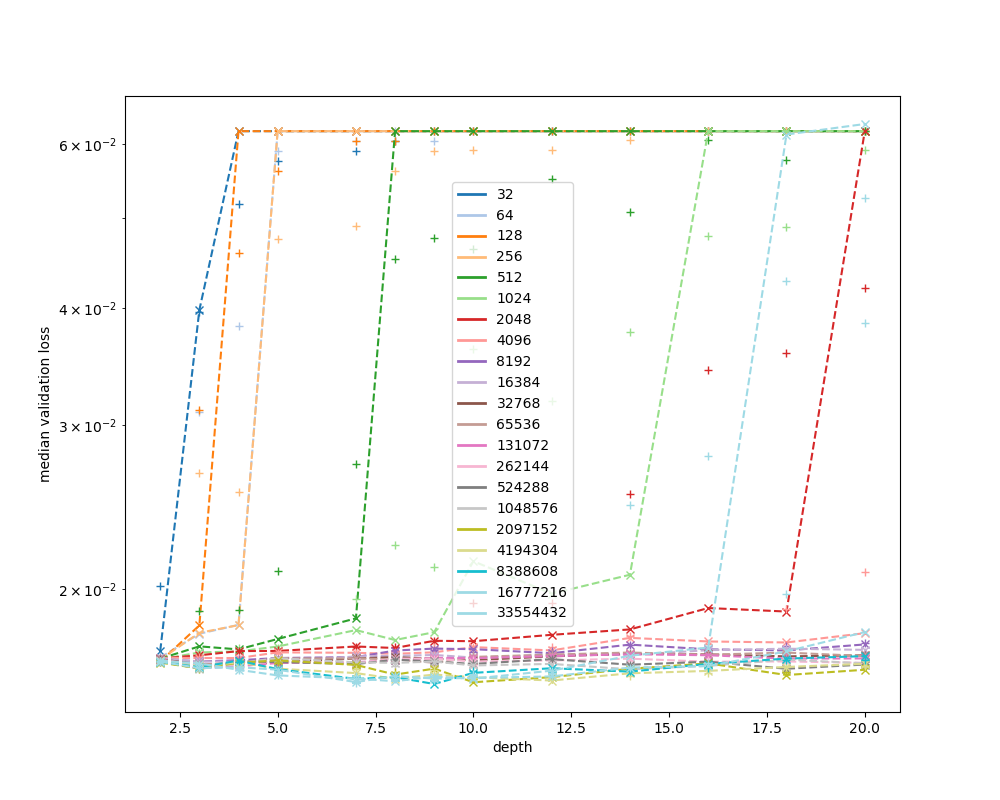

<IPython.core.display.Javascript object>


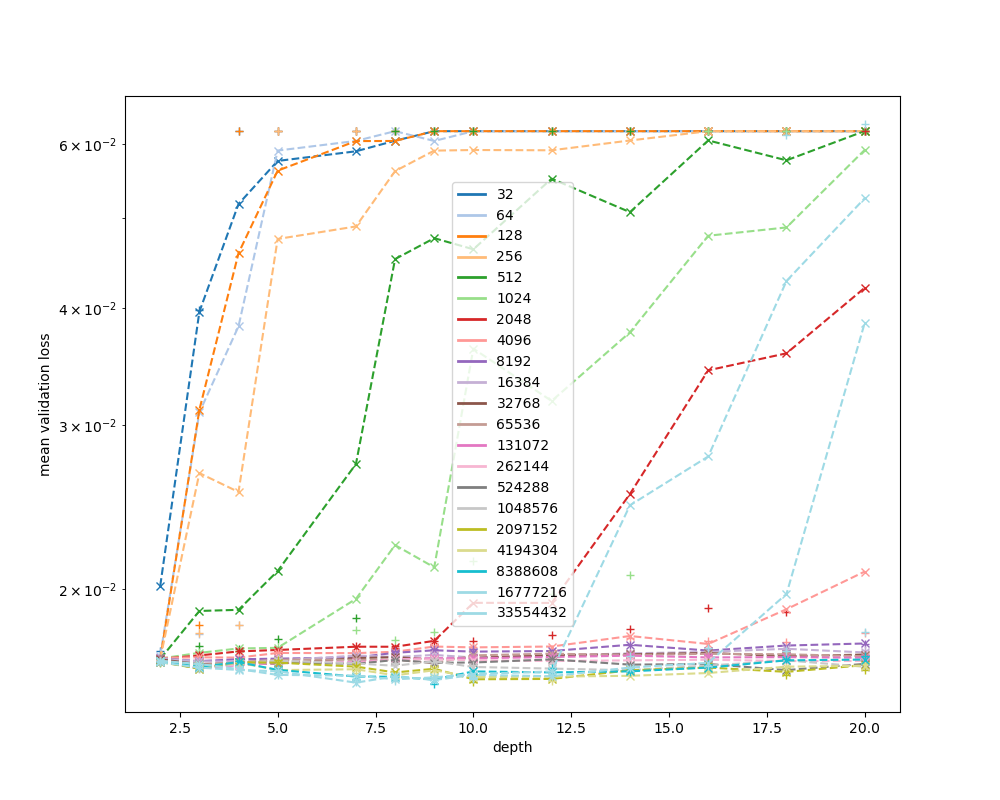

<IPython.core.display.Javascript object>


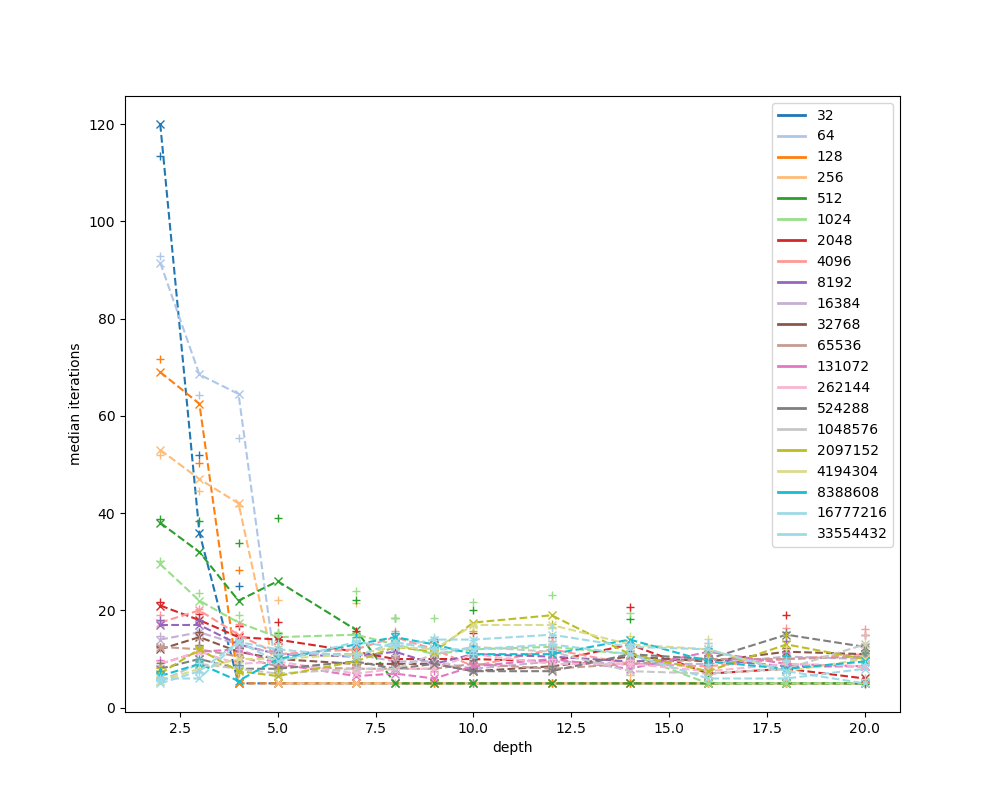

<IPython.core.display.Javascript object>


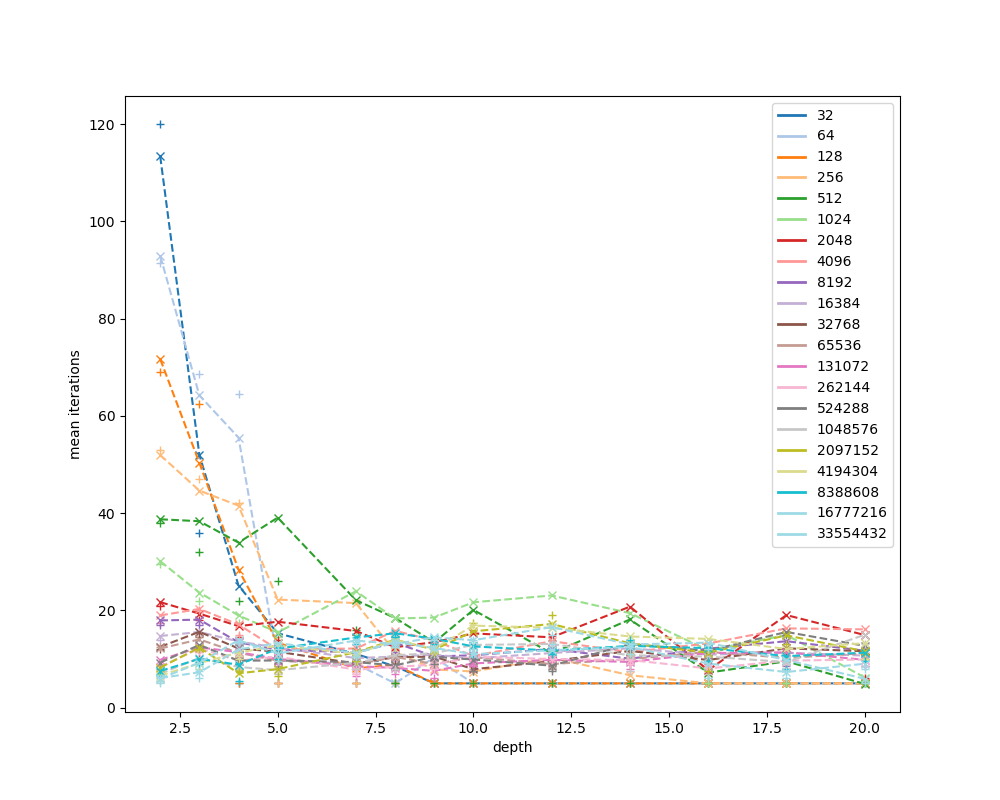

{'config.topology': 'wide_first', 'config.residual_mode': 'full'}


<IPython.core.display.Javascript object>


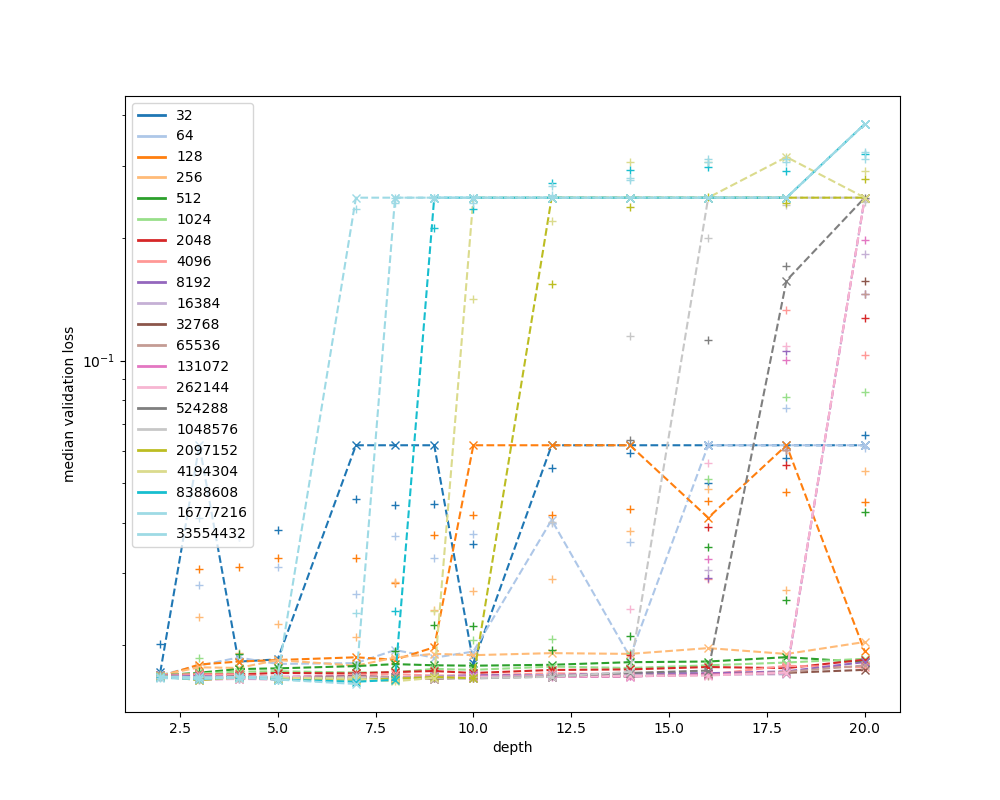

<IPython.core.display.Javascript object>


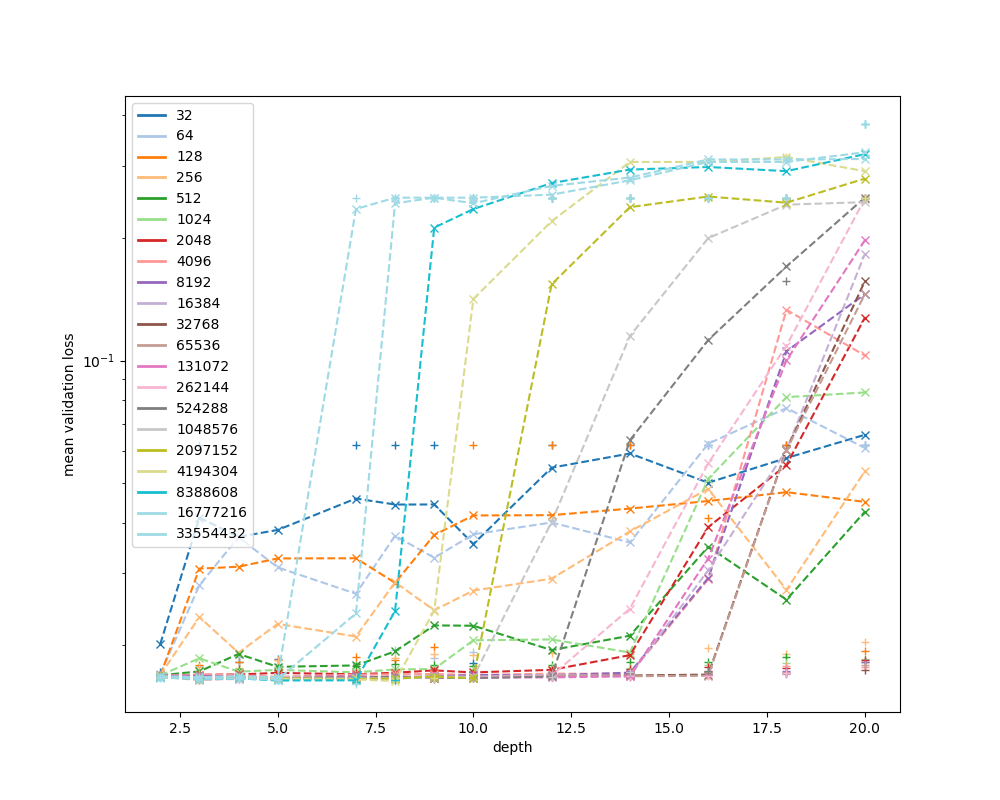

<IPython.core.display.Javascript object>


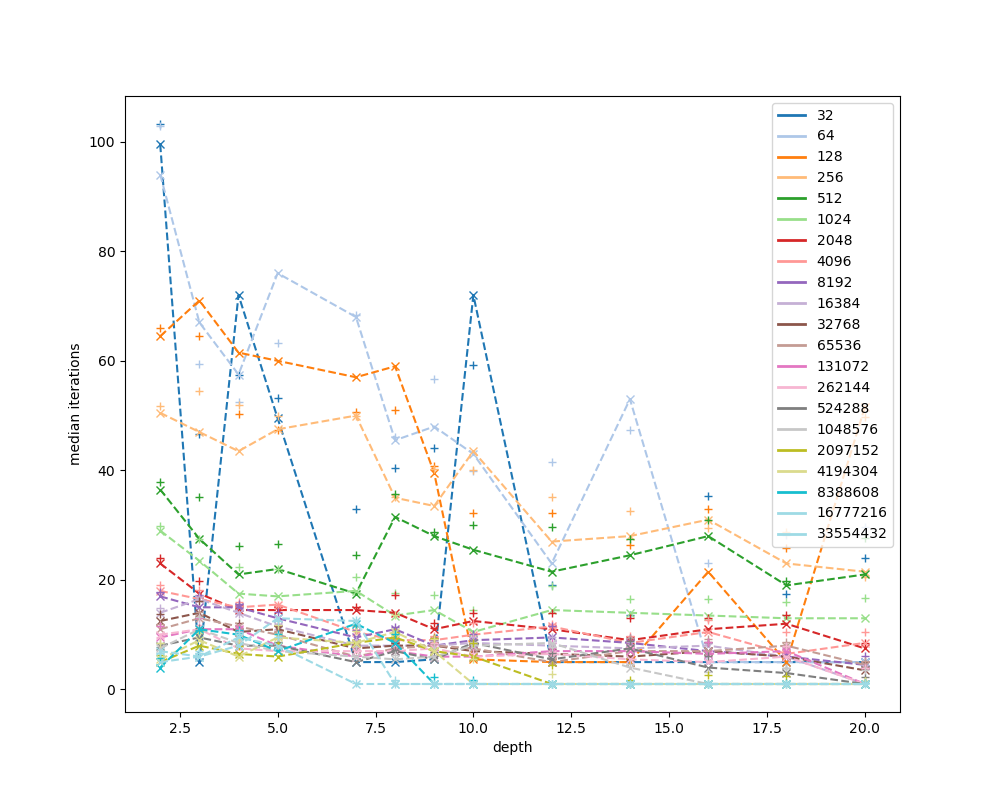

<IPython.core.display.Javascript object>


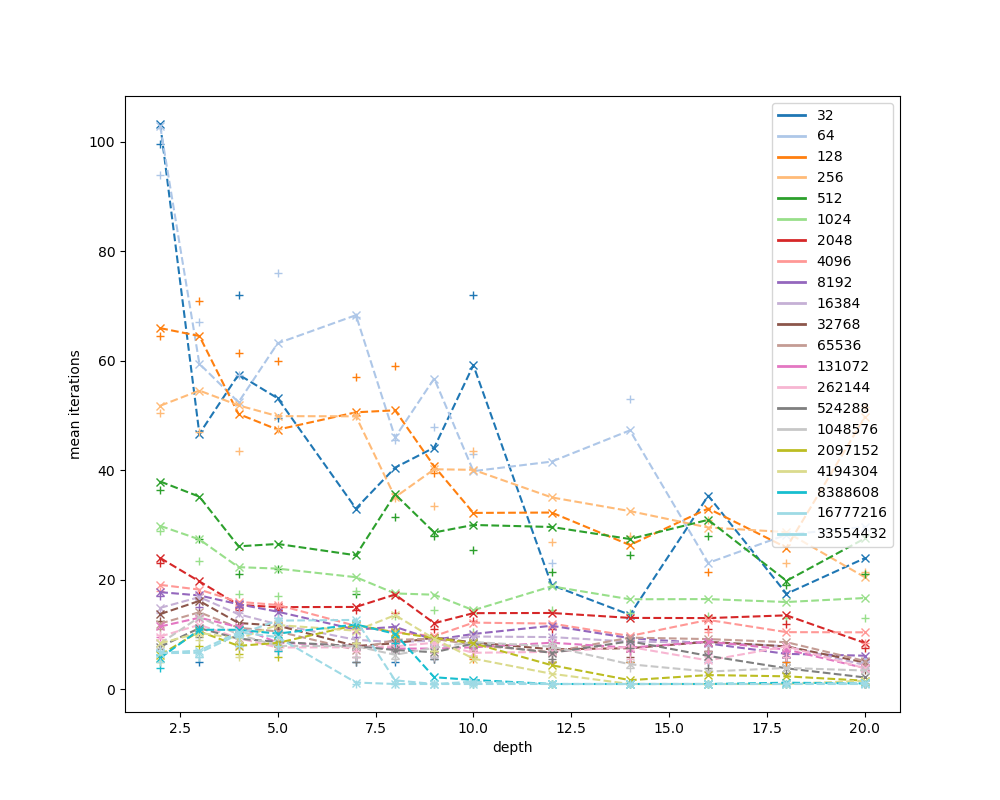

{'config.topology': 'exponential', 'config.residual_mode': 'none'}


<IPython.core.display.Javascript object>


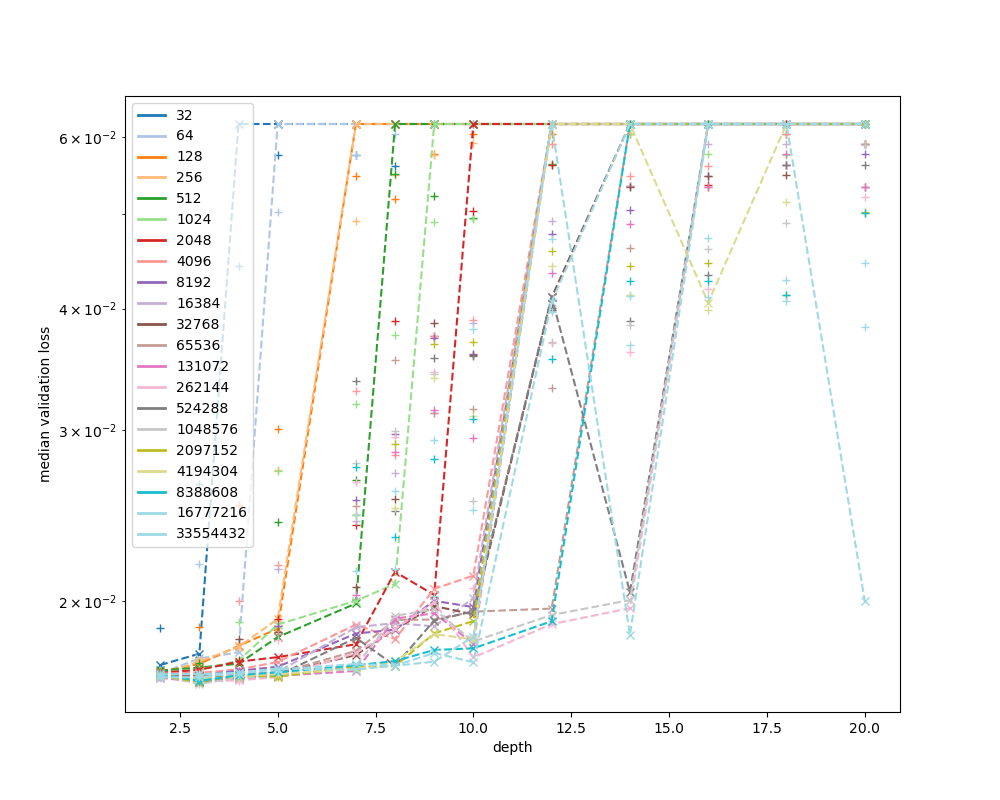

<IPython.core.display.Javascript object>


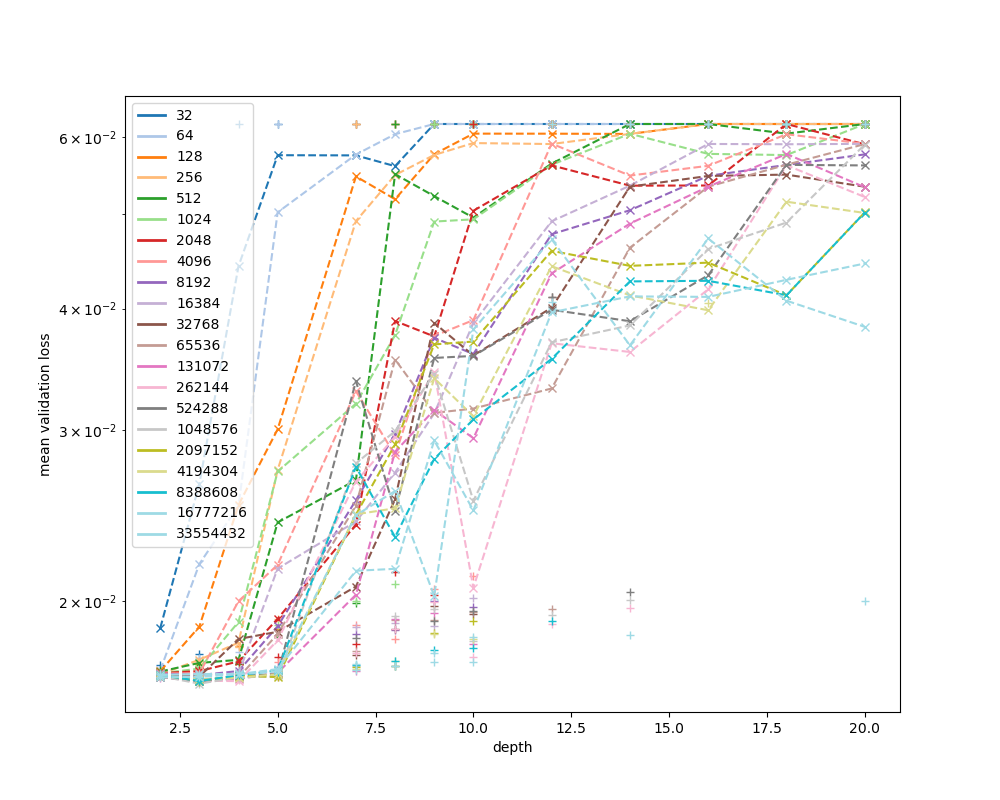

<IPython.core.display.Javascript object>


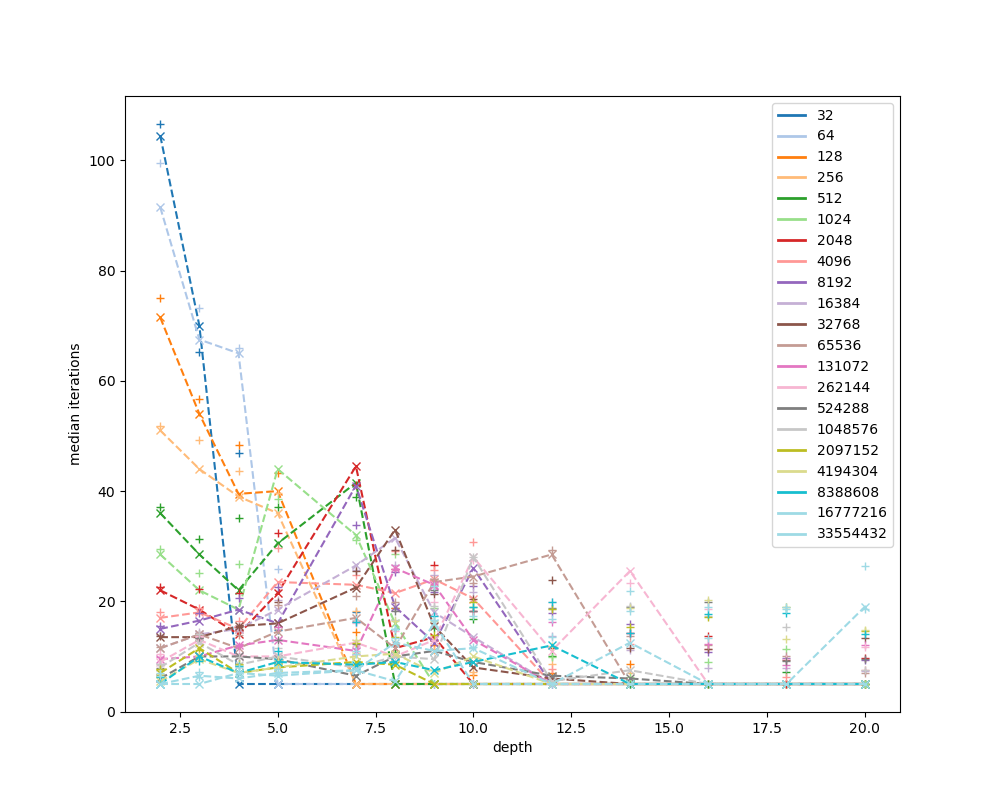

<IPython.core.display.Javascript object>


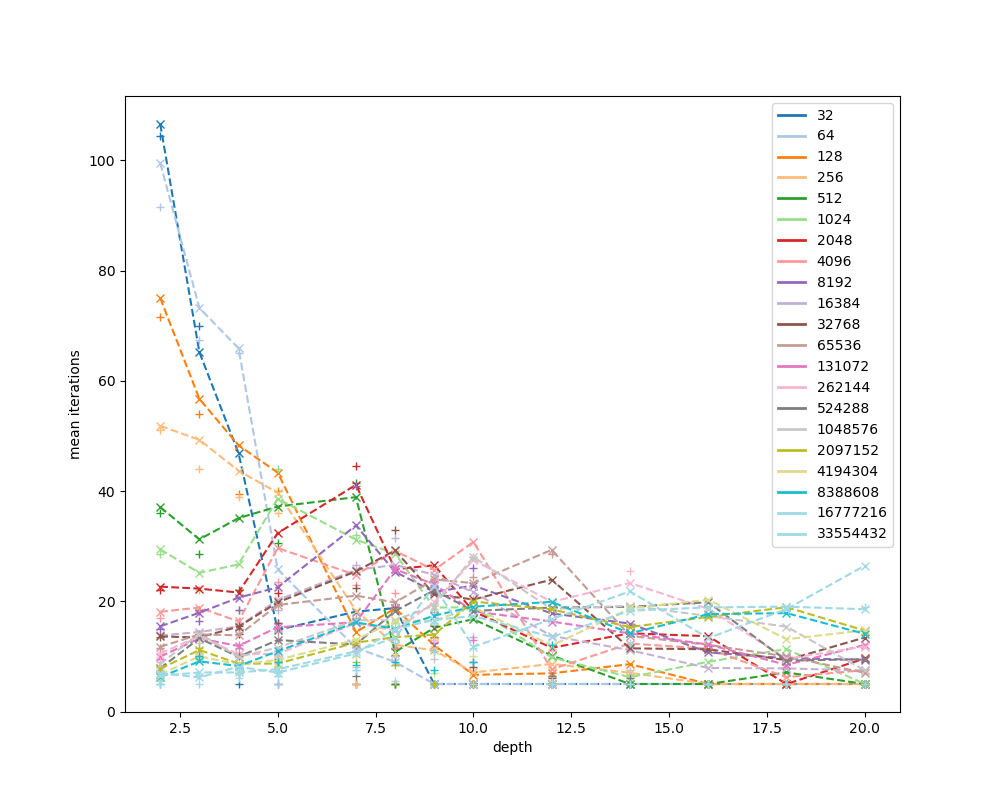

{'config.topology': 'rectangle', 'config.residual_mode': 'none'}


<IPython.core.display.Javascript object>


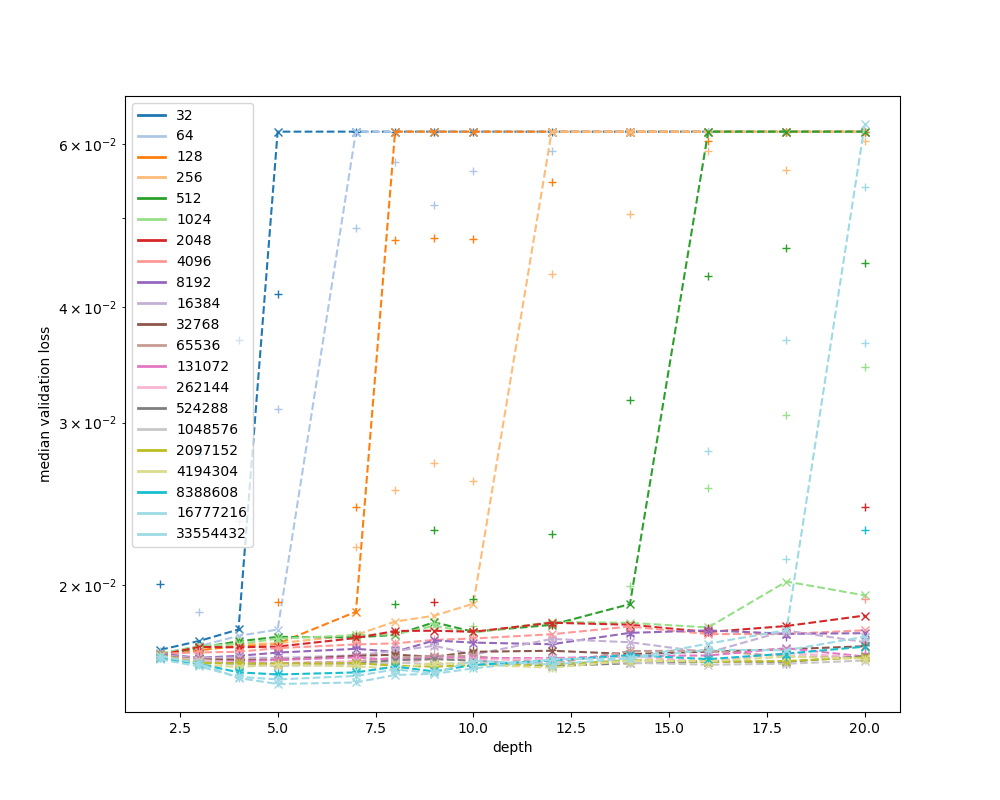

<IPython.core.display.Javascript object>


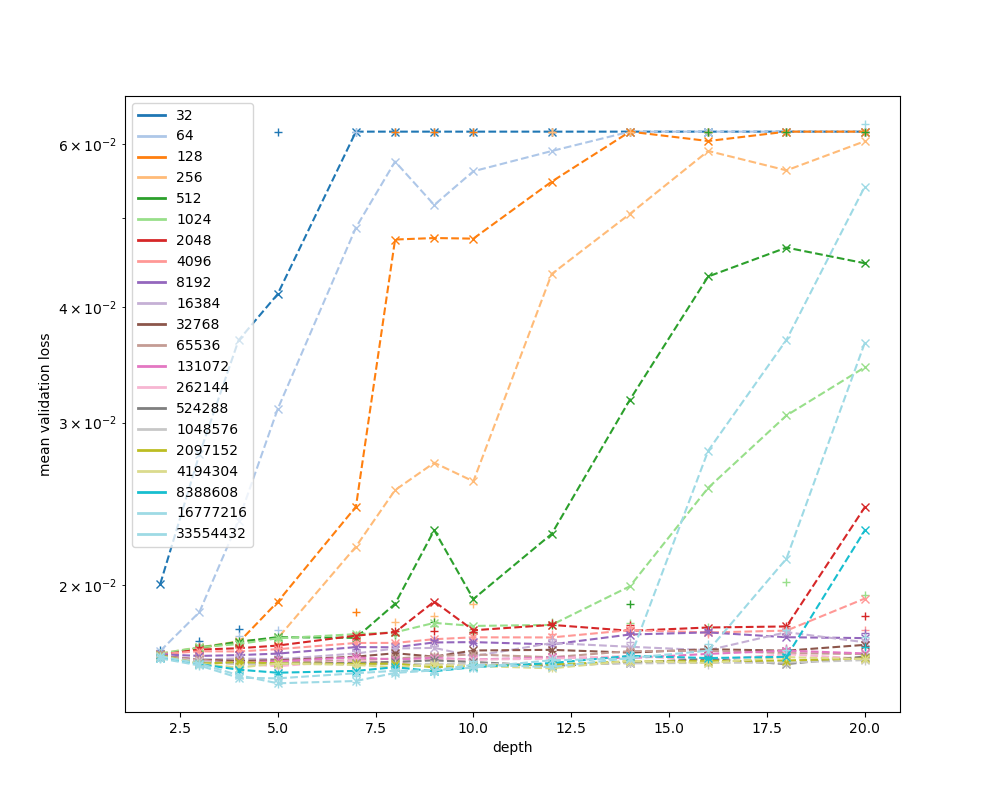

<IPython.core.display.Javascript object>


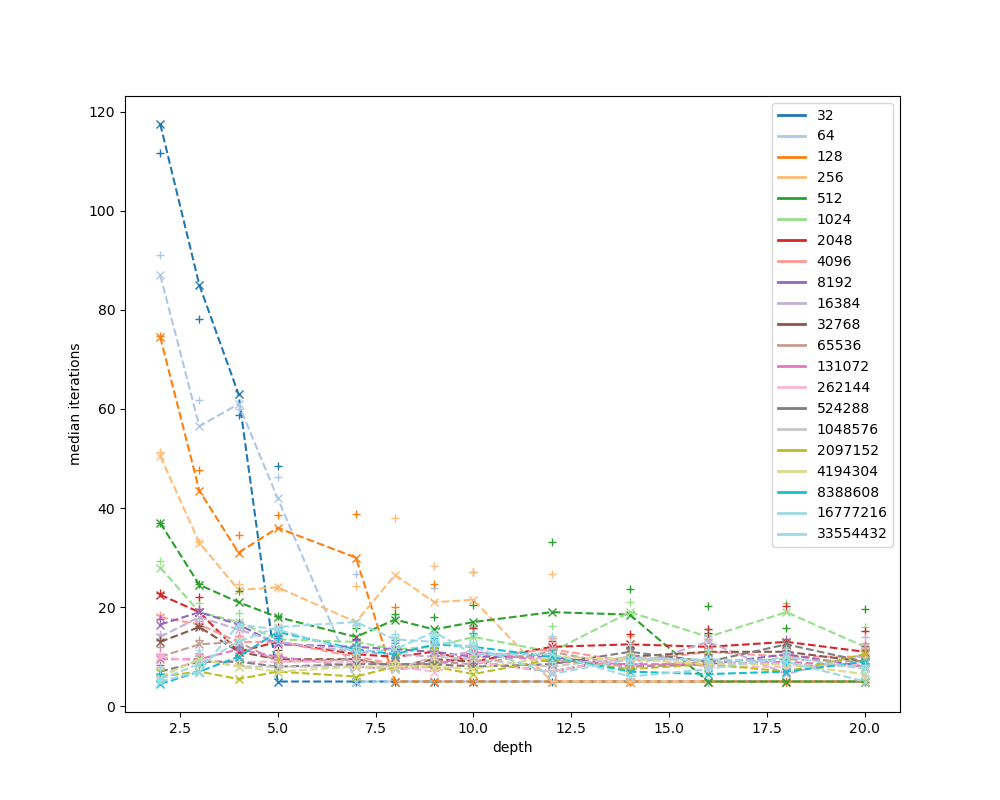

<IPython.core.display.Javascript object>


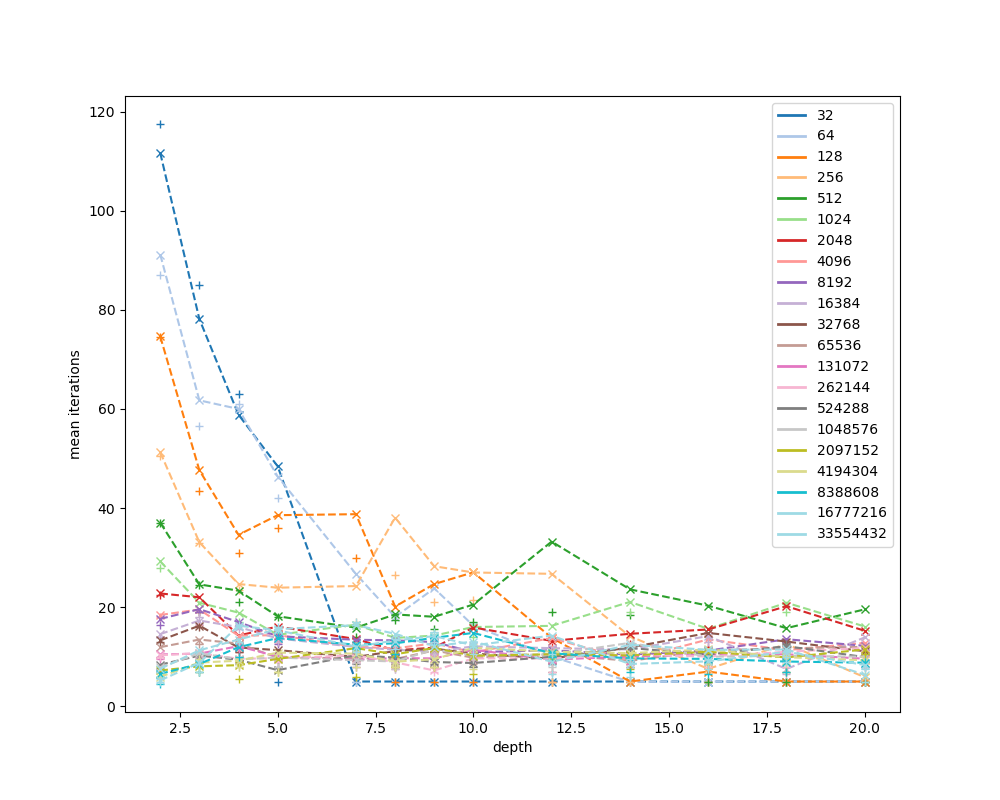

{'config.topology': 'rectangle', 'config.residual_mode': 'full'}


<IPython.core.display.Javascript object>


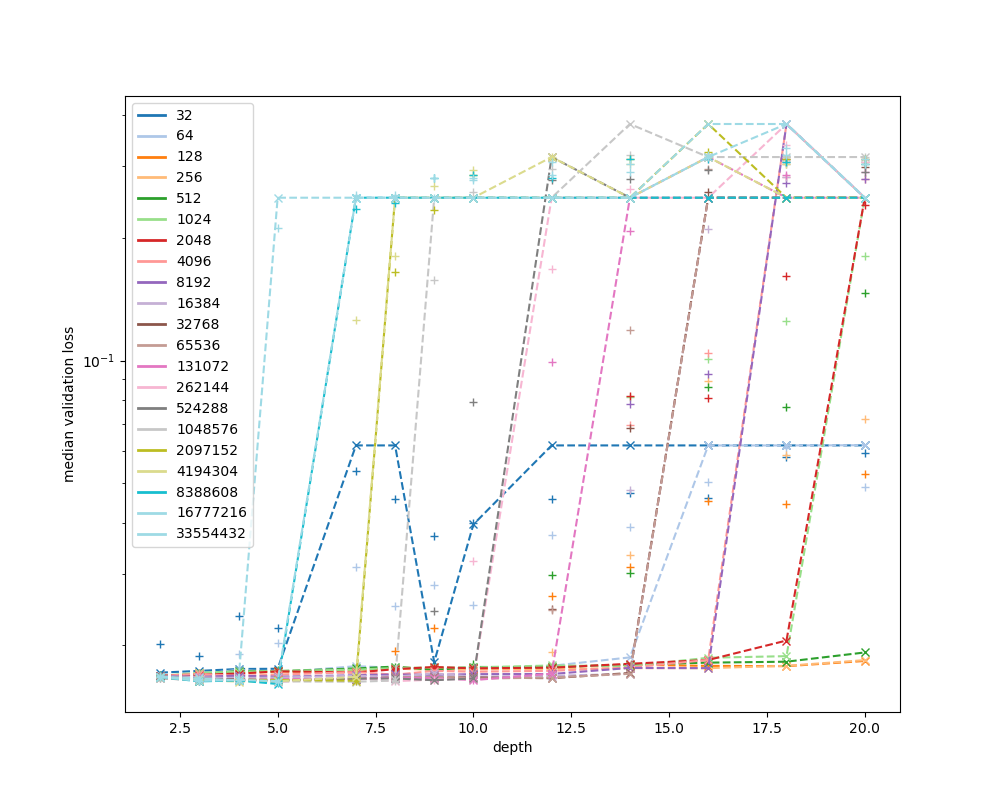

<IPython.core.display.Javascript object>


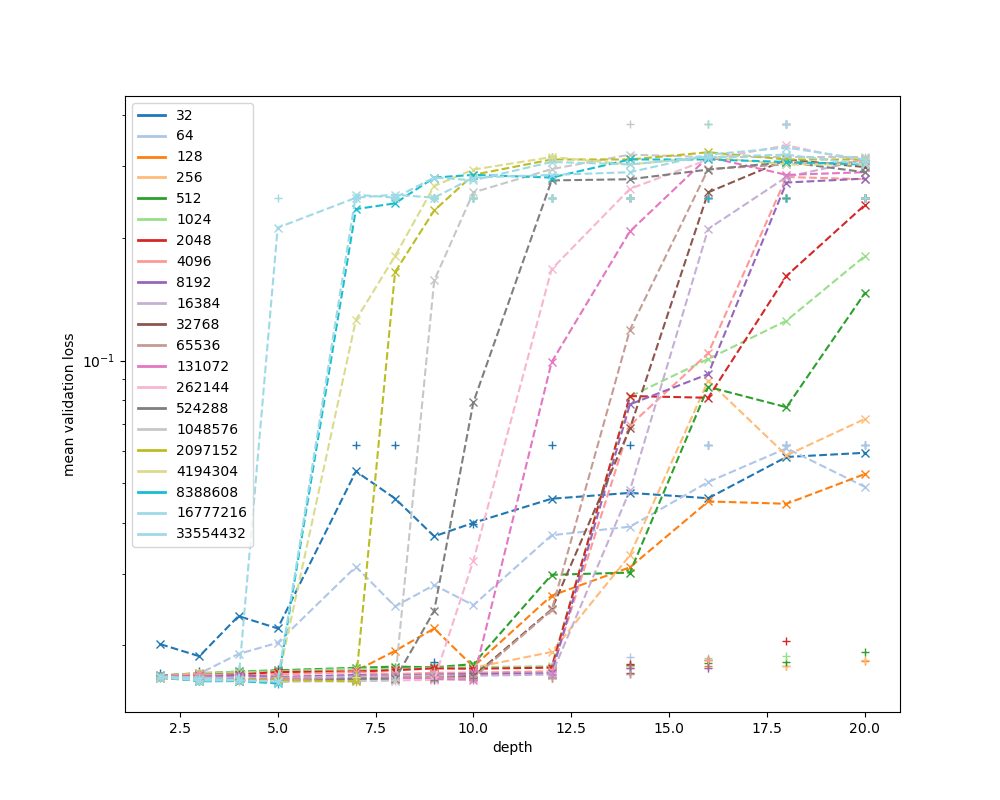

<IPython.core.display.Javascript object>


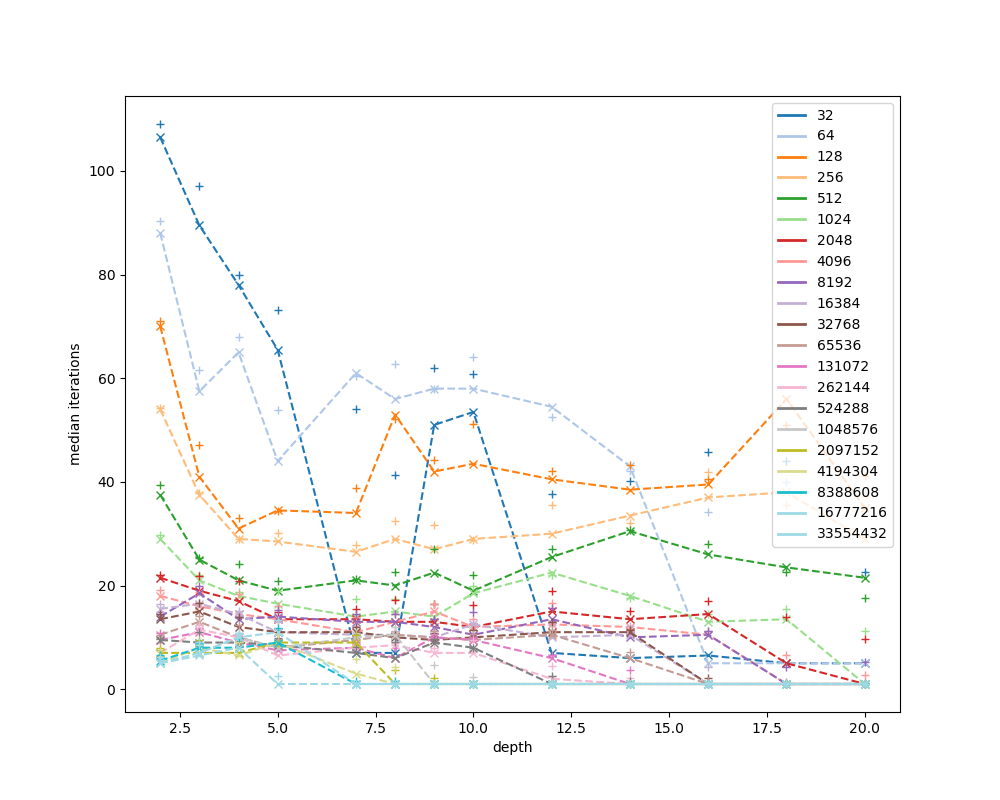

<IPython.core.display.Javascript object>


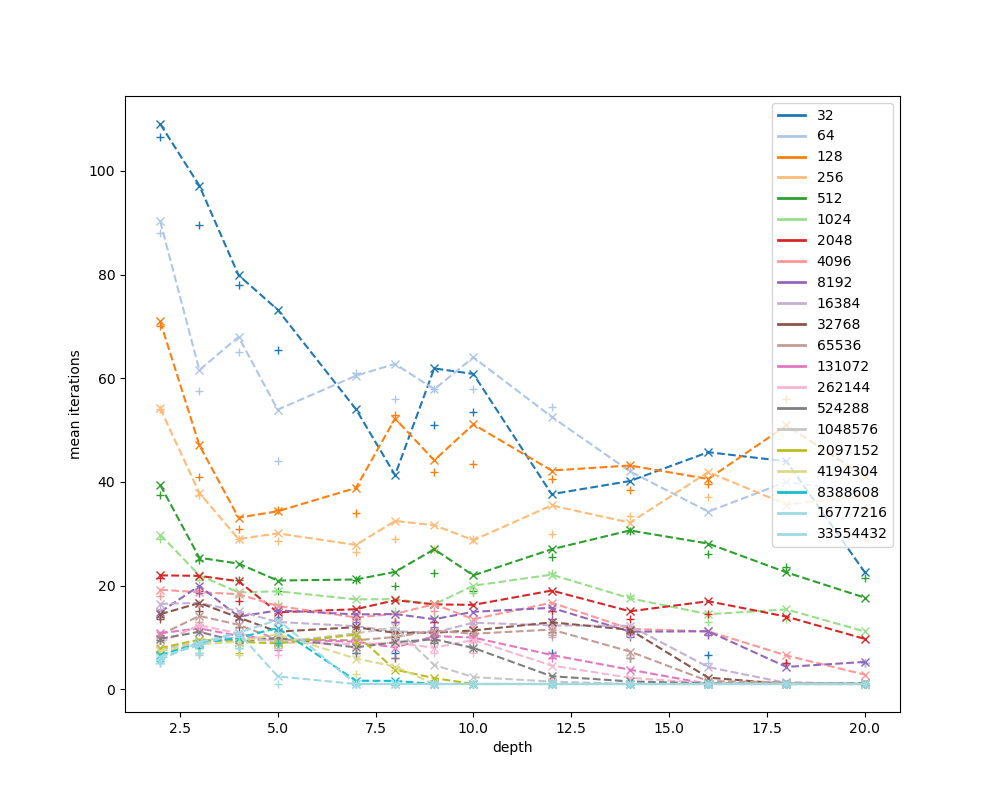

{'config.topology': 'trapezoid', 'config.residual_mode': 'none'}


<IPython.core.display.Javascript object>


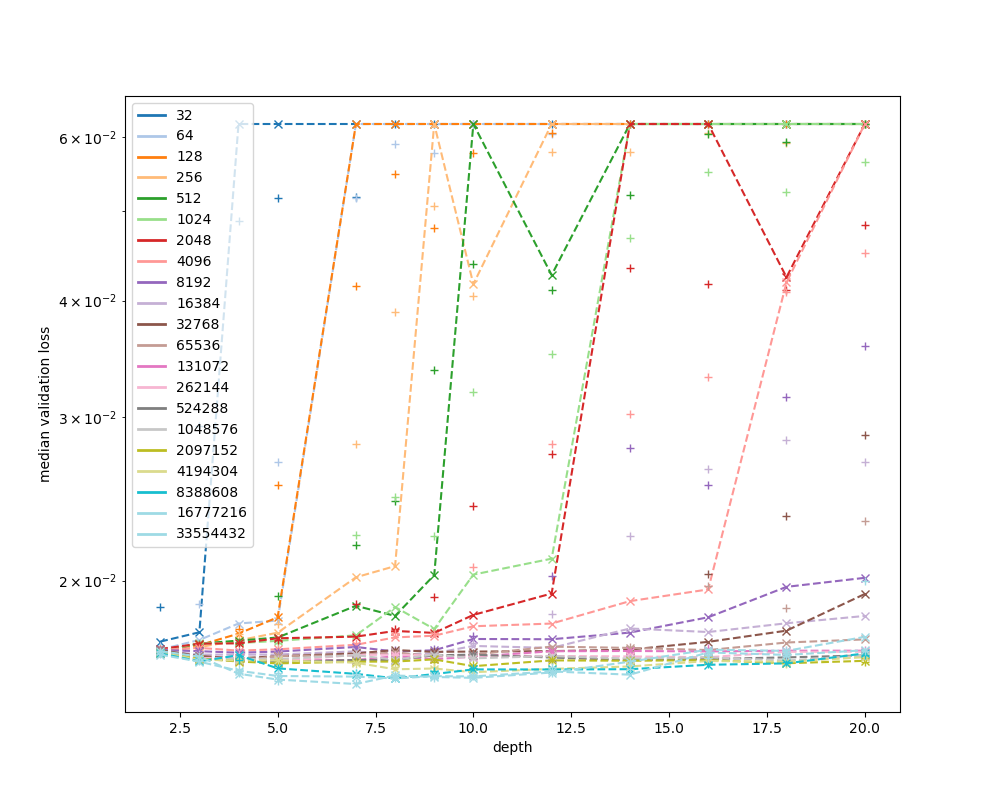

<IPython.core.display.Javascript object>


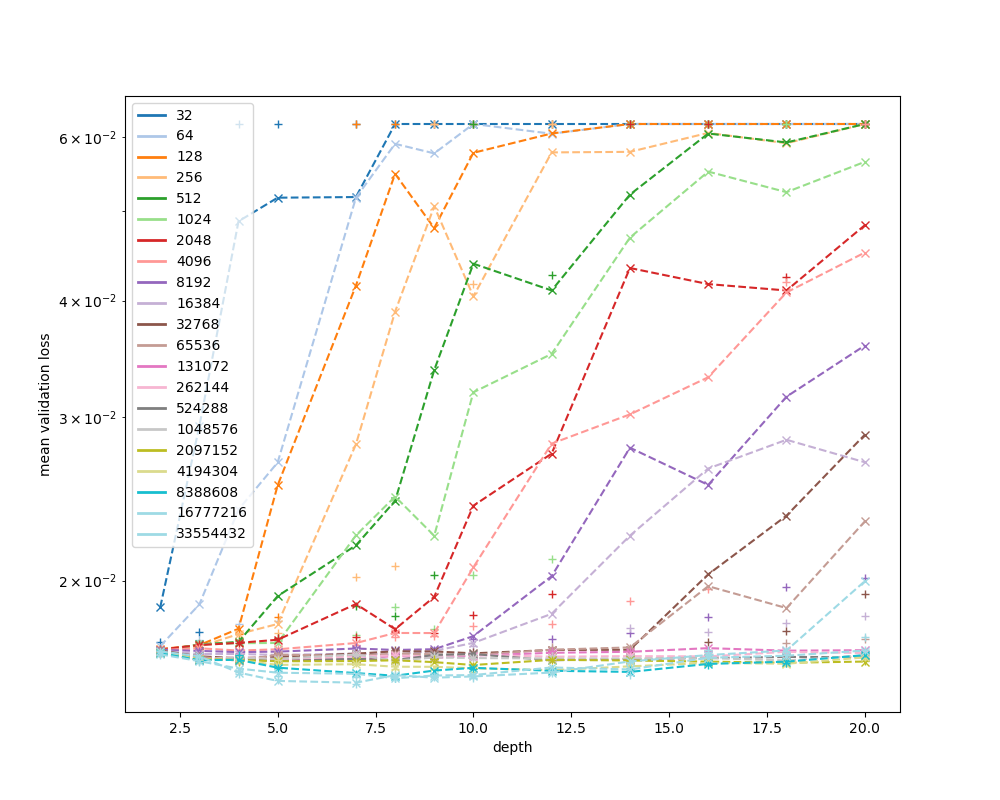

<IPython.core.display.Javascript object>


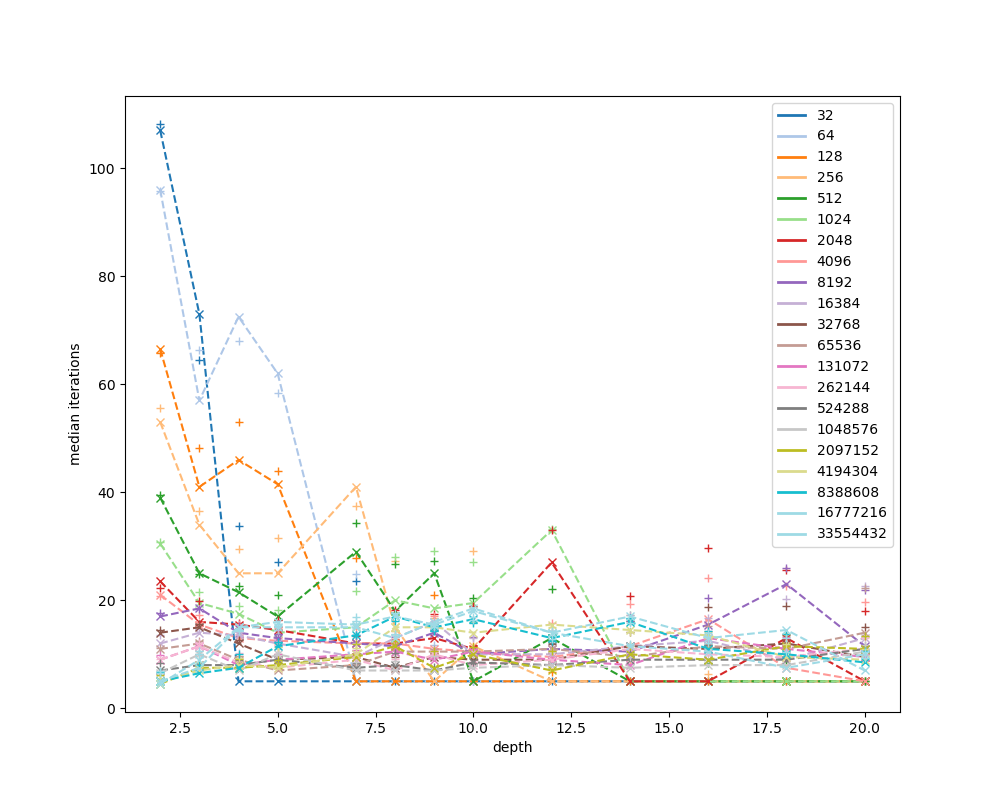

<IPython.core.display.Javascript object>


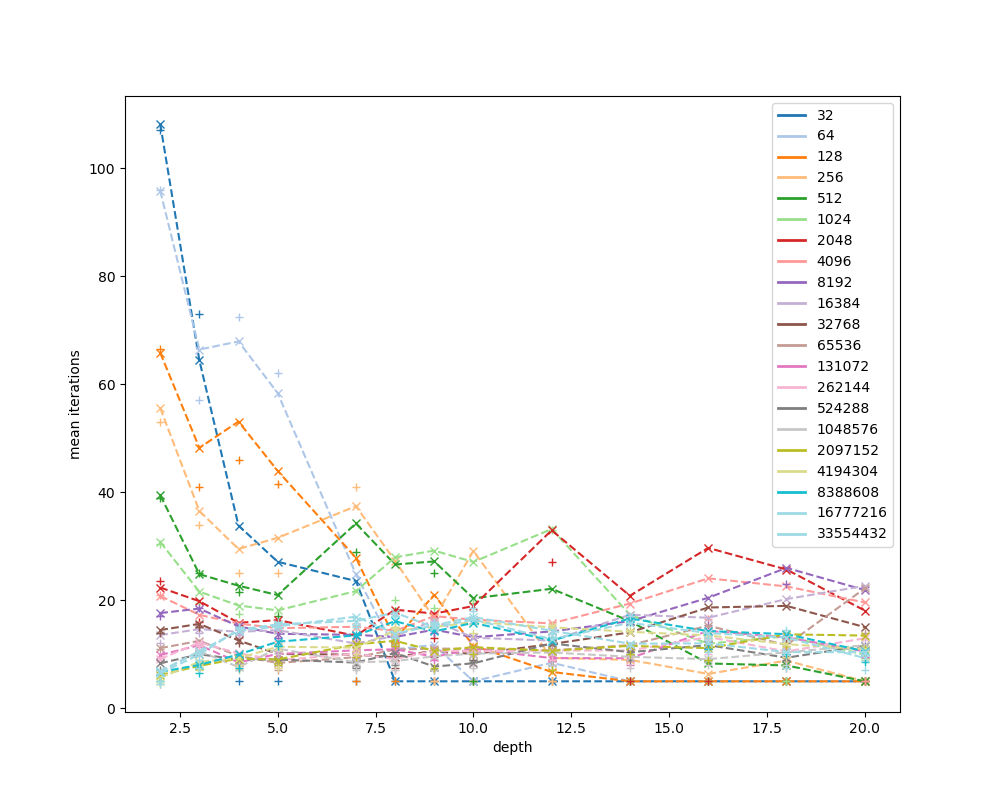

In [90]:
plot_dataset('537_houses')

In [ ]:
plot_dataset('529_pollen')

{'config.topology': 'rectangle', 'config.residual_mode': 'none'}


<IPython.core.display.Javascript object>


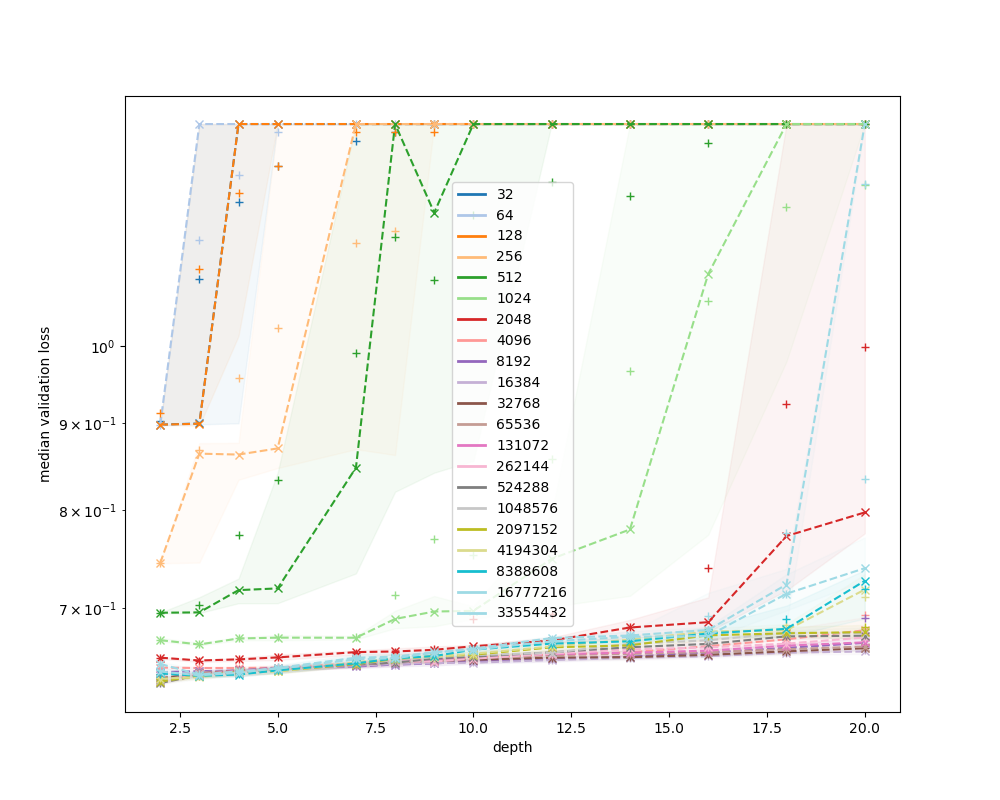

<IPython.core.display.Javascript object>


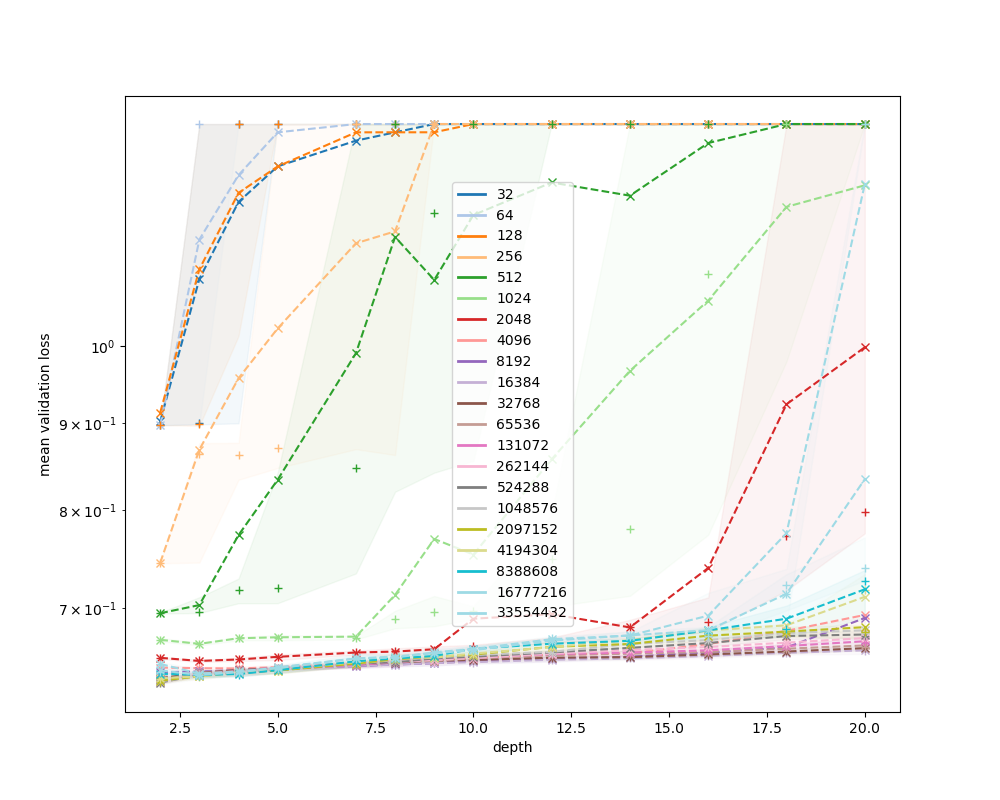

<IPython.core.display.Javascript object>


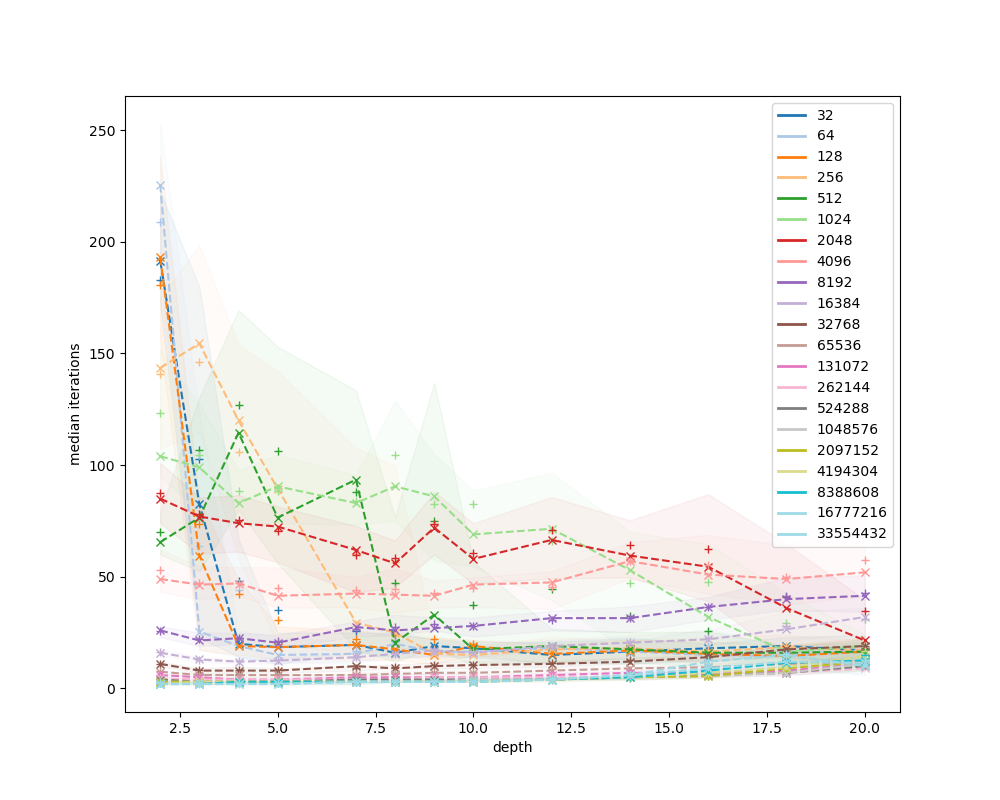

<IPython.core.display.Javascript object>


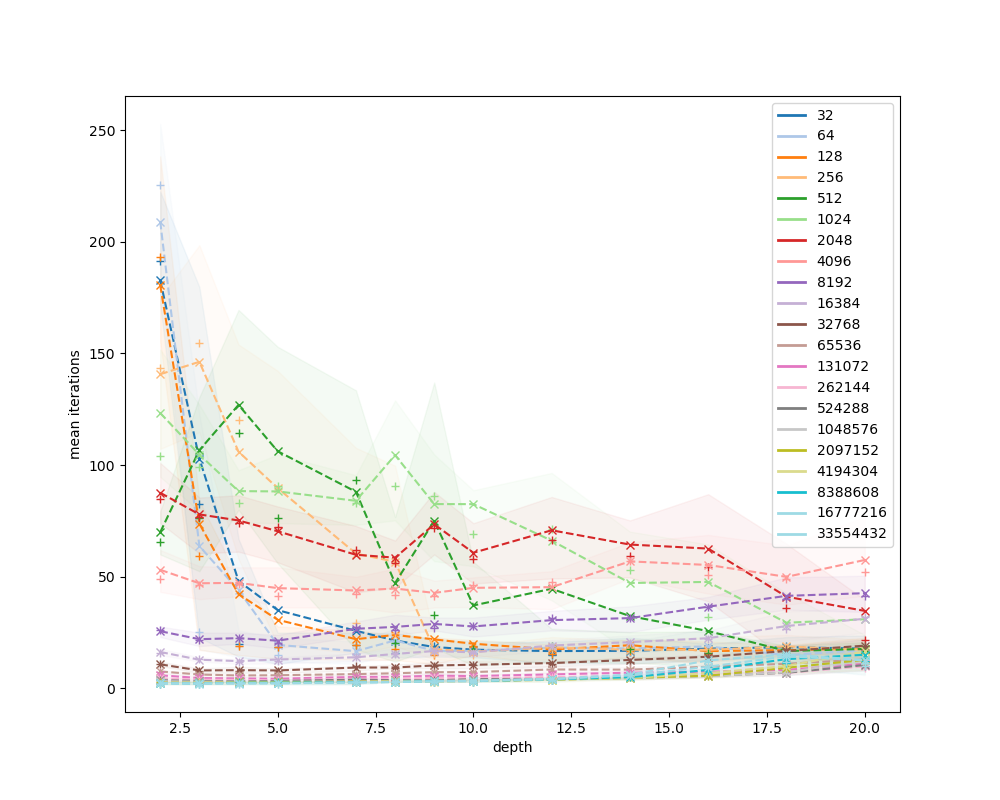

{'config.topology': 'rectangle', 'config.residual_mode': 'full'}


<IPython.core.display.Javascript object>


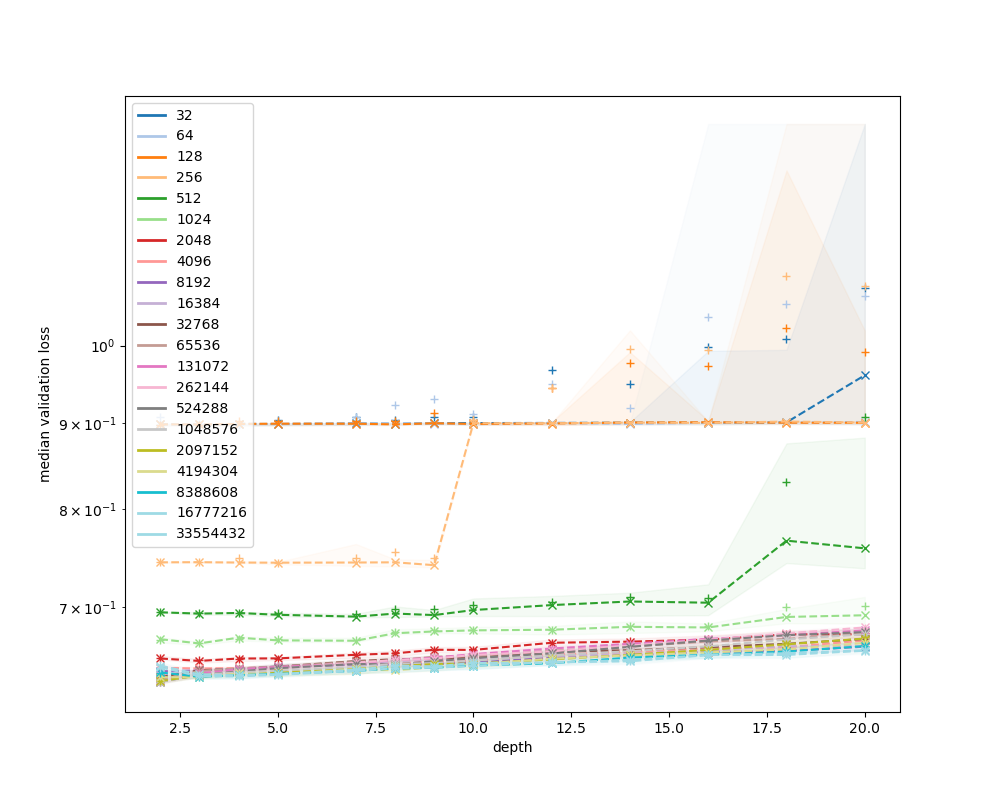

<IPython.core.display.Javascript object>


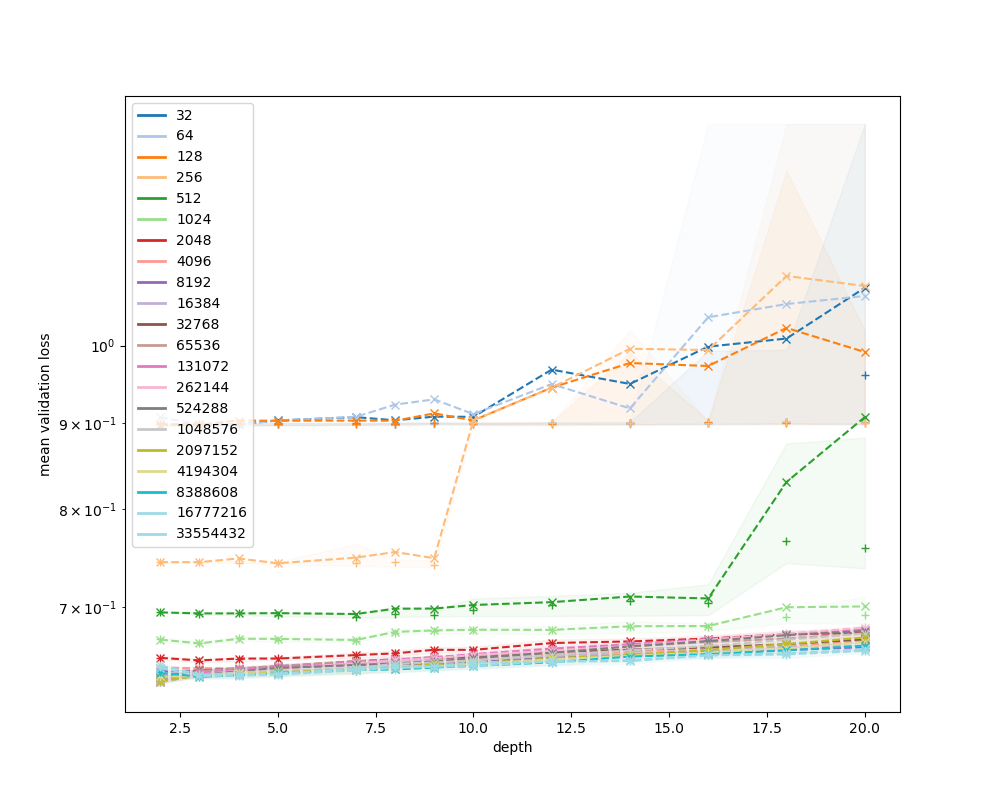

<IPython.core.display.Javascript object>


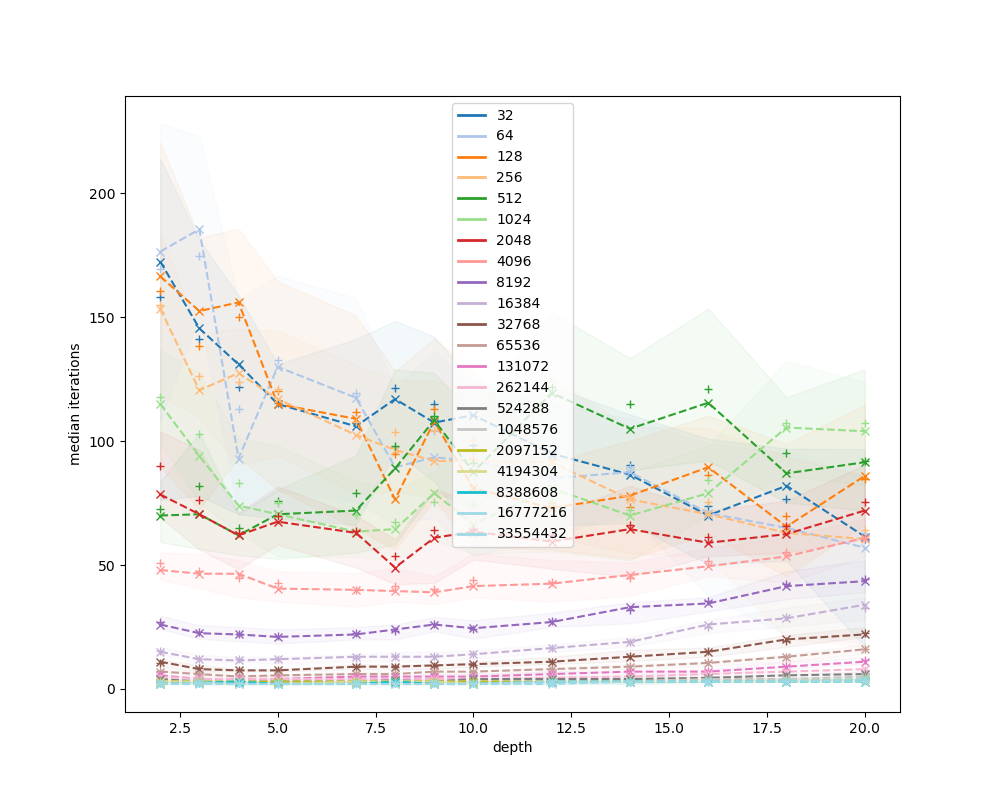

<IPython.core.display.Javascript object>


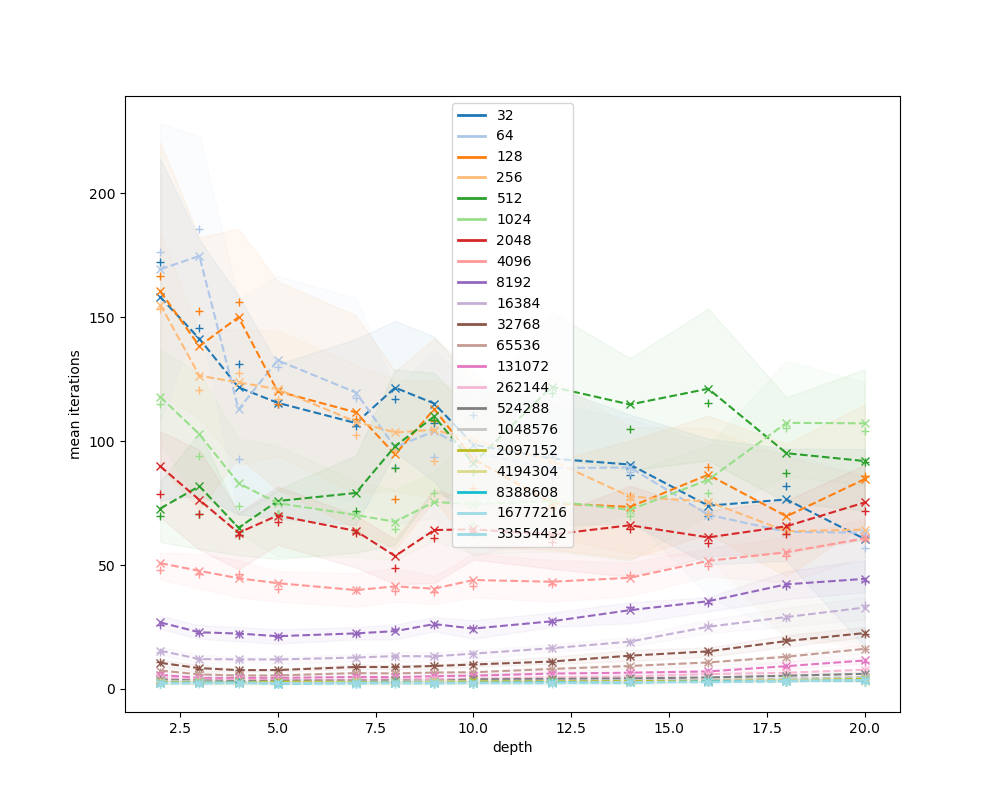

{'config.topology': 'trapezoid', 'config.residual_mode': 'none'}


<IPython.core.display.Javascript object>


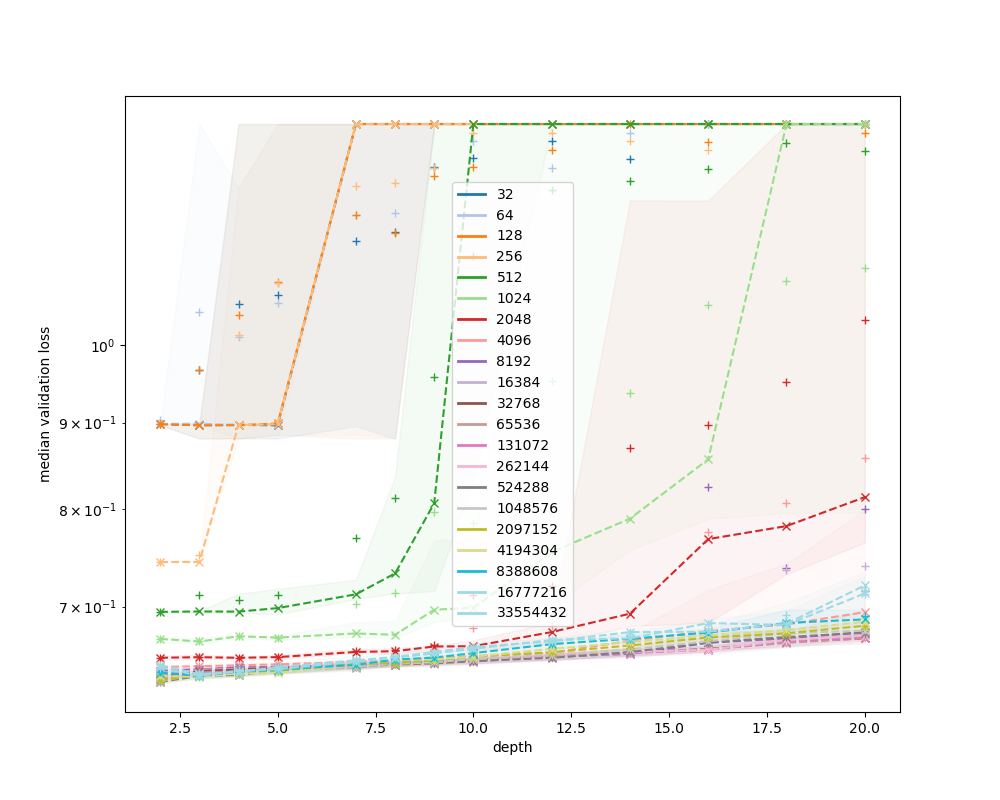

<IPython.core.display.Javascript object>


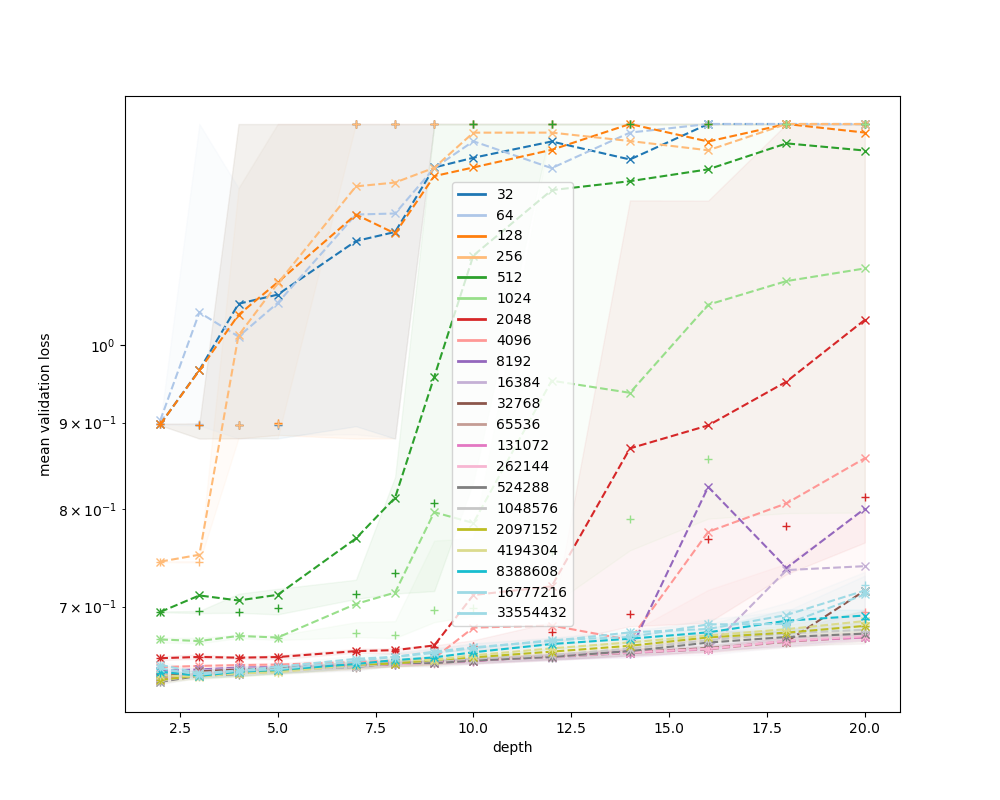

<IPython.core.display.Javascript object>


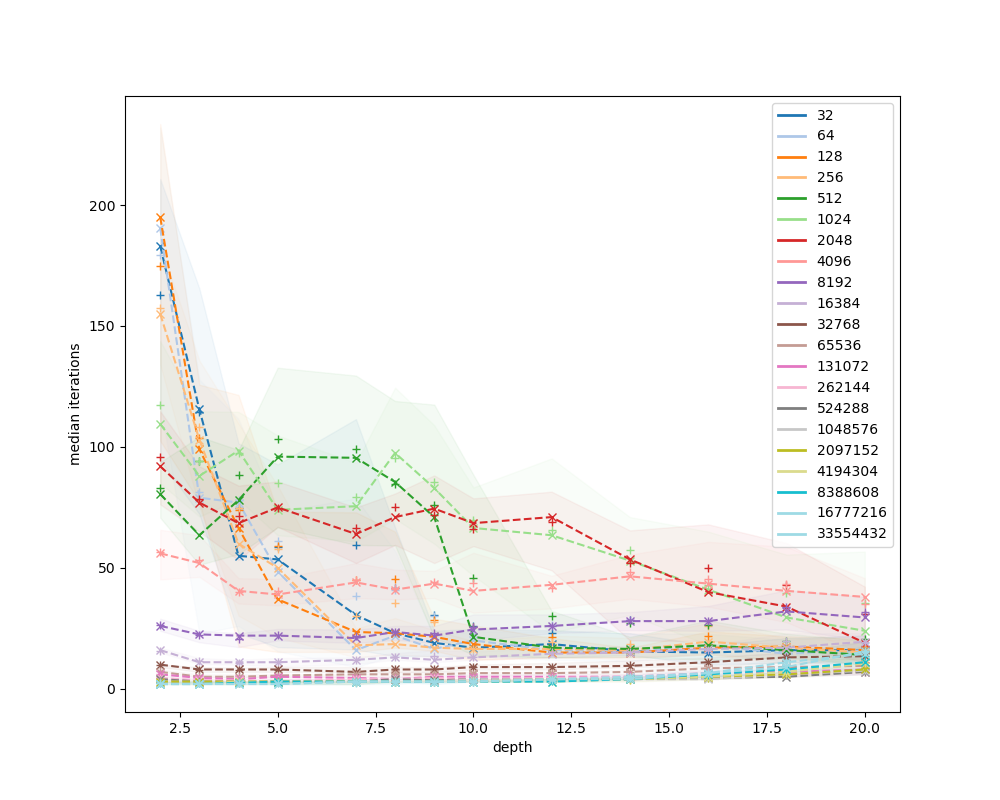

<IPython.core.display.Javascript object>


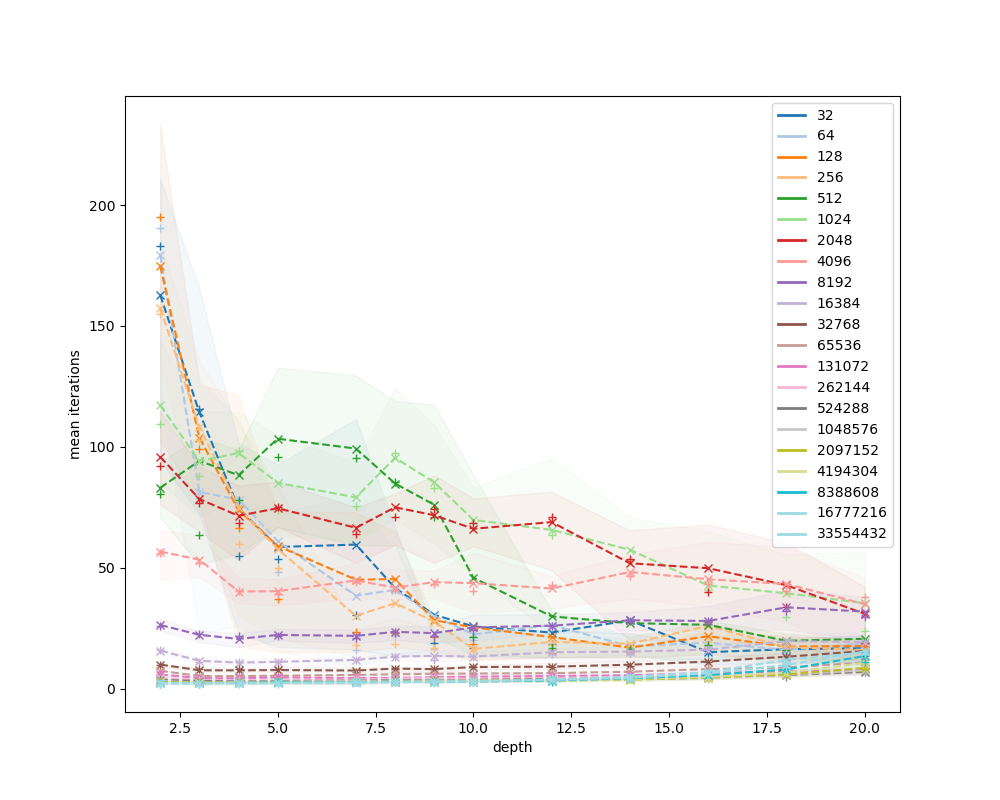

{'config.topology': 'exponential', 'config.residual_mode': 'none'}


<IPython.core.display.Javascript object>


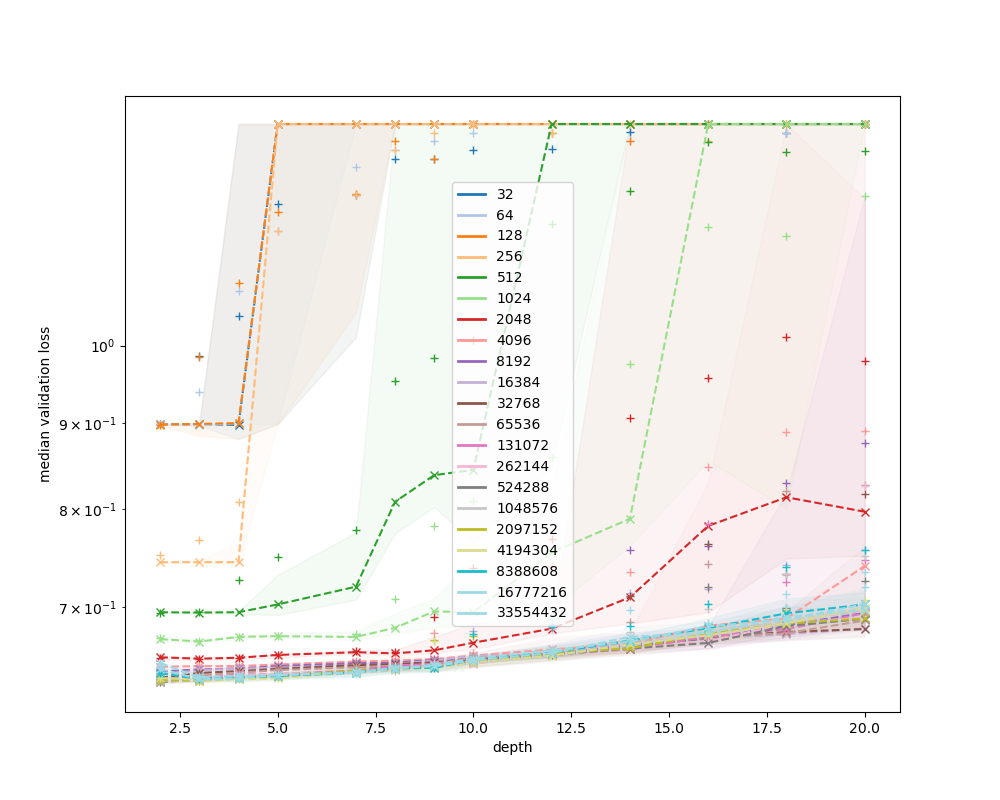

<IPython.core.display.Javascript object>


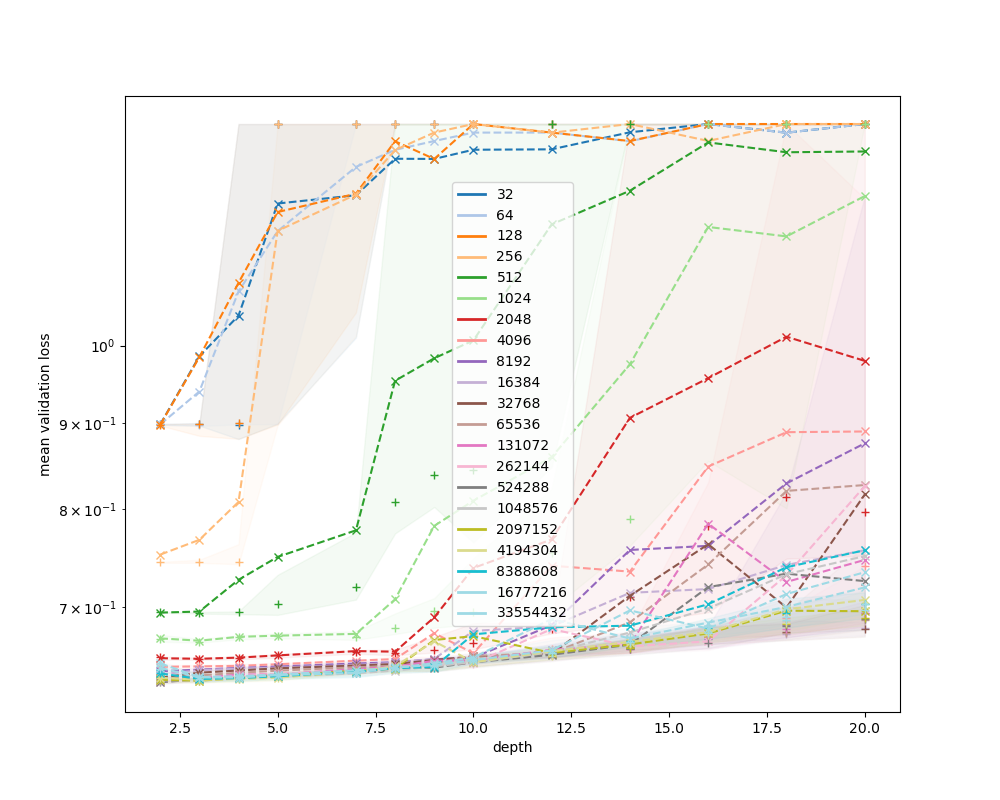

<IPython.core.display.Javascript object>


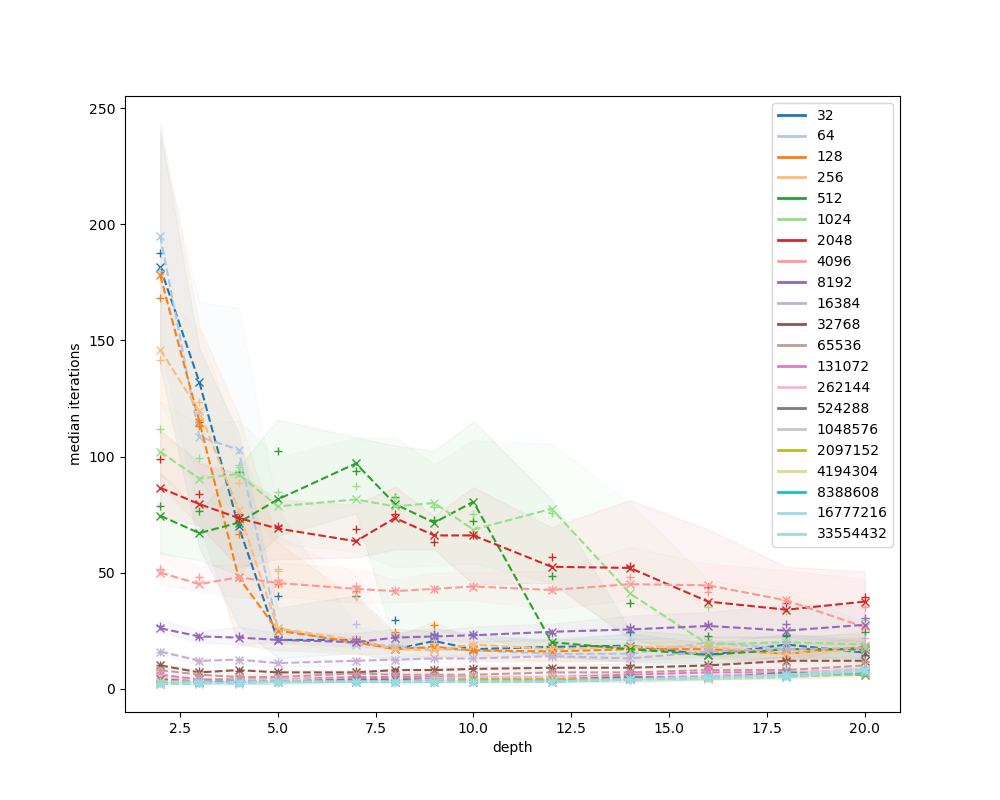

<IPython.core.display.Javascript object>


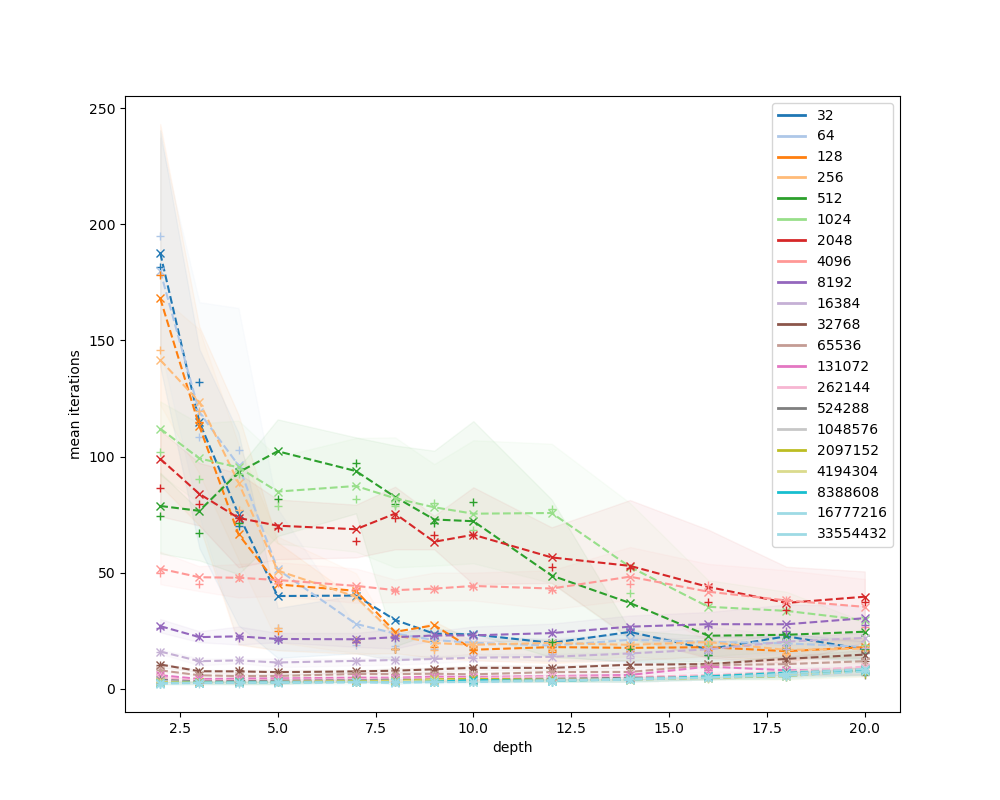

{'config.topology': 'wide_first', 'config.residual_mode': 'none'}


<IPython.core.display.Javascript object>


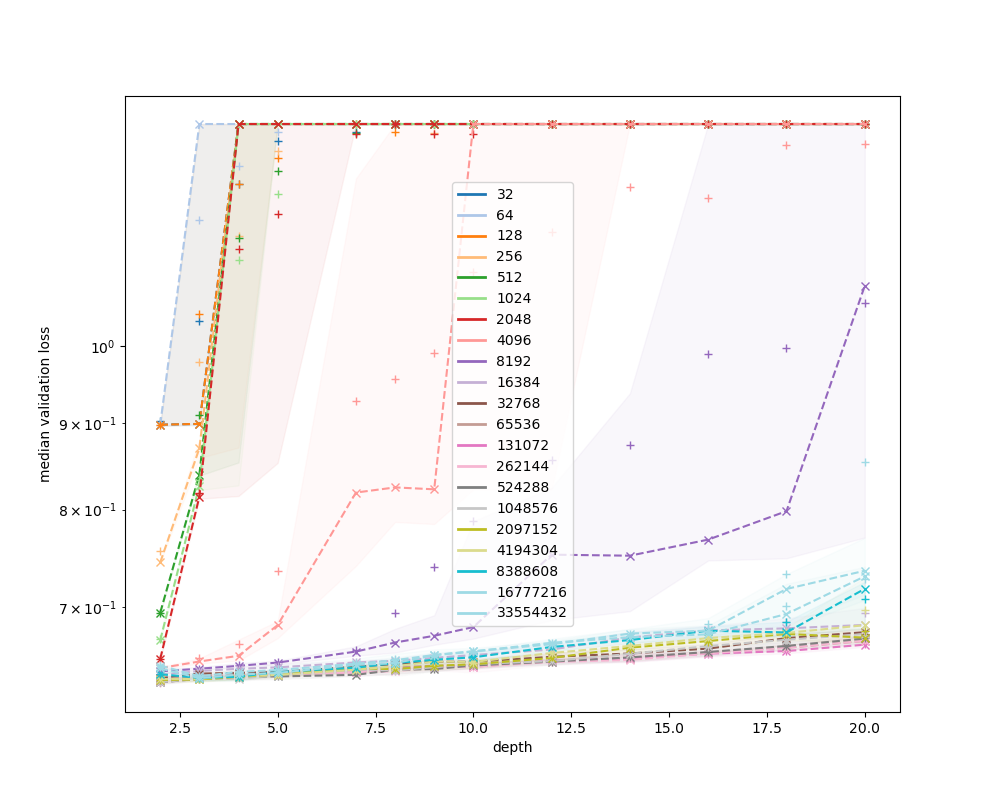

<IPython.core.display.Javascript object>


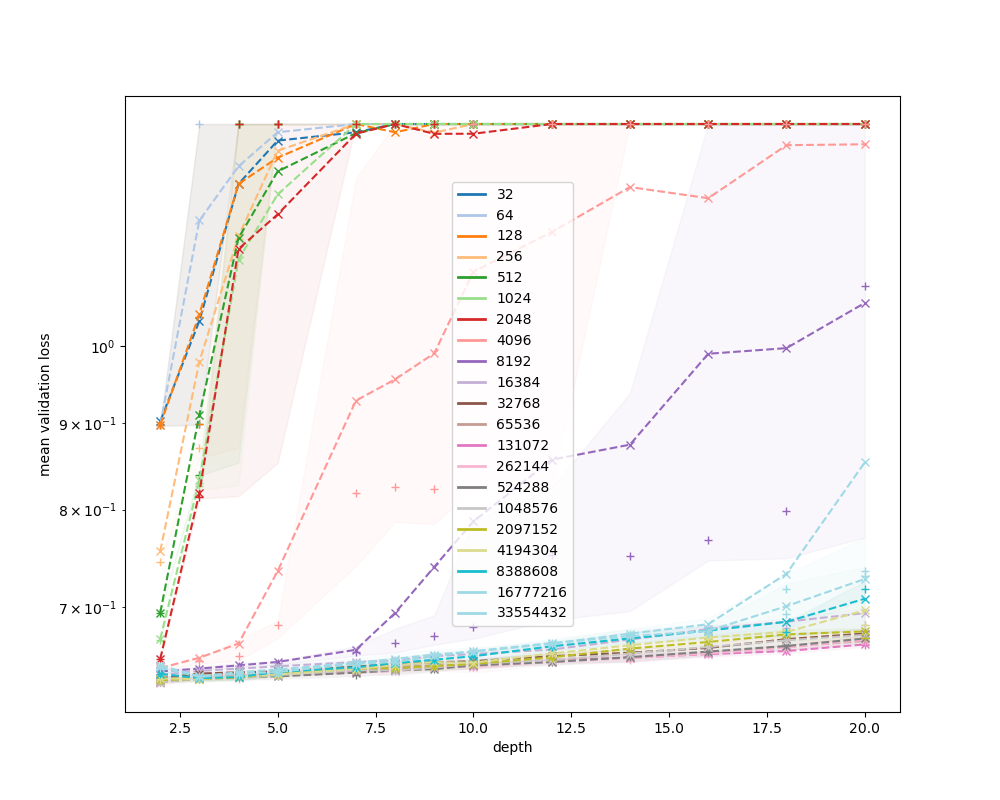

<IPython.core.display.Javascript object>


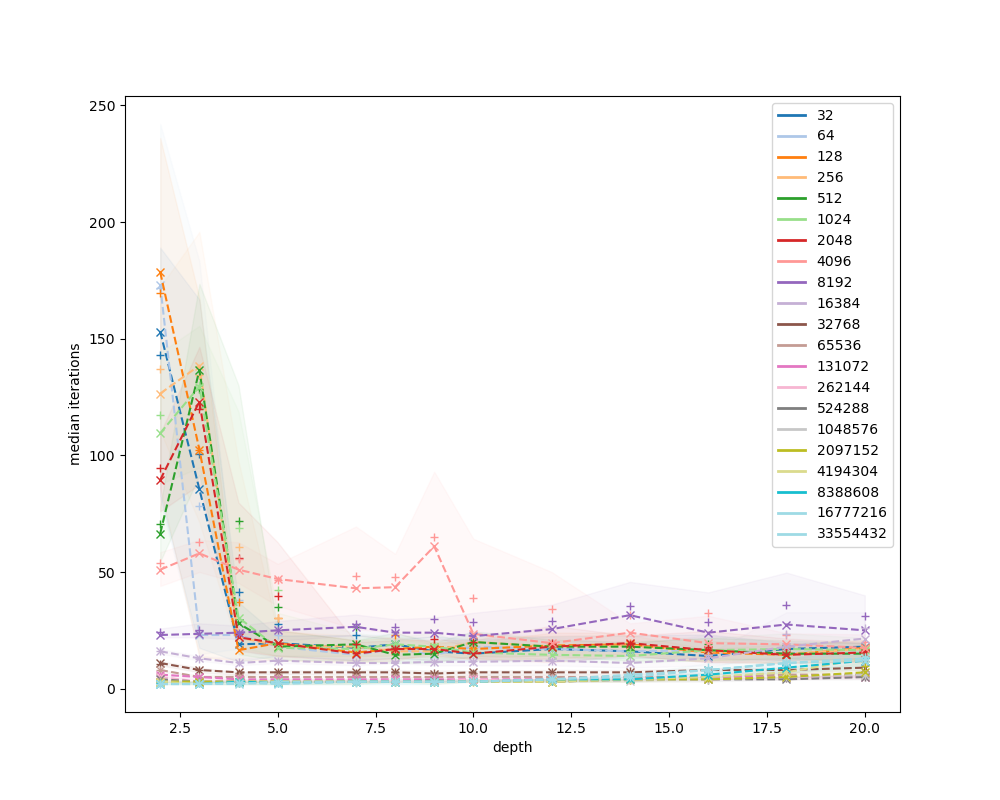

<IPython.core.display.Javascript object>


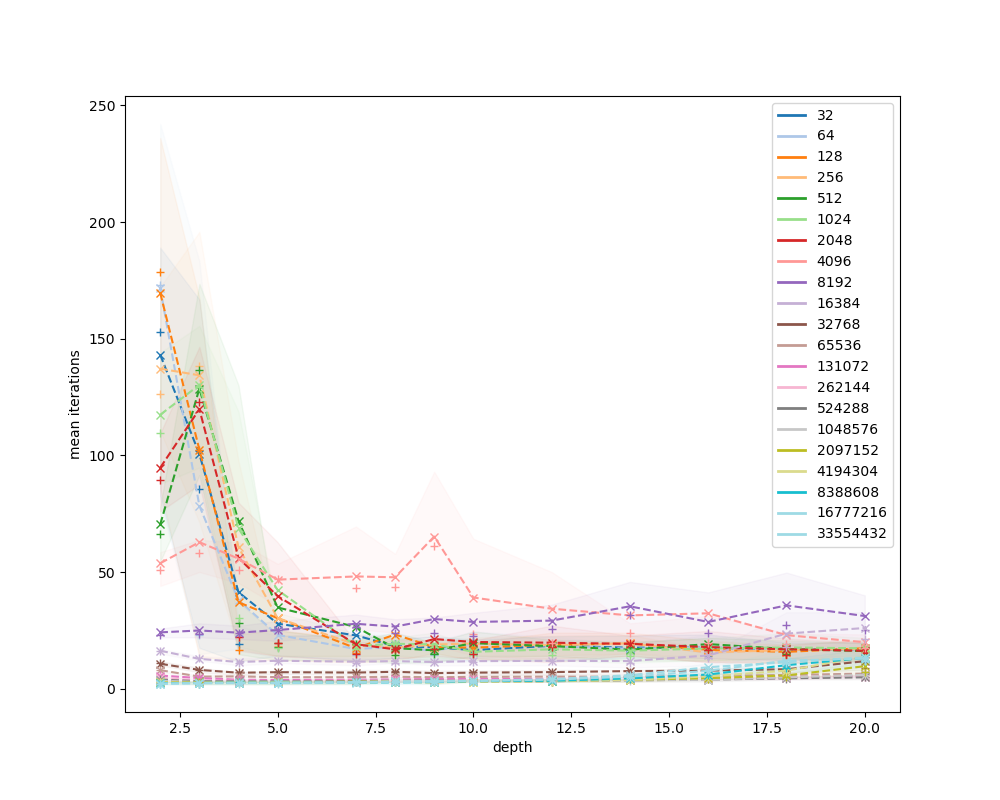

{'config.topology': 'wide_first', 'config.residual_mode': 'full'}


<IPython.core.display.Javascript object>


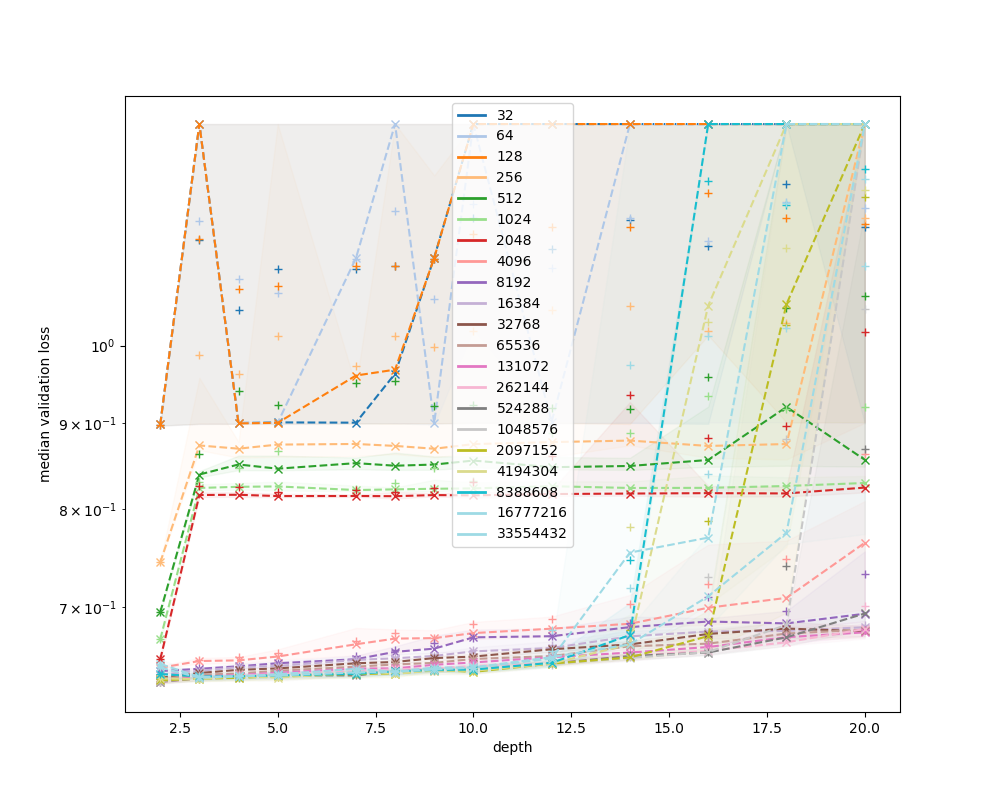

<IPython.core.display.Javascript object>


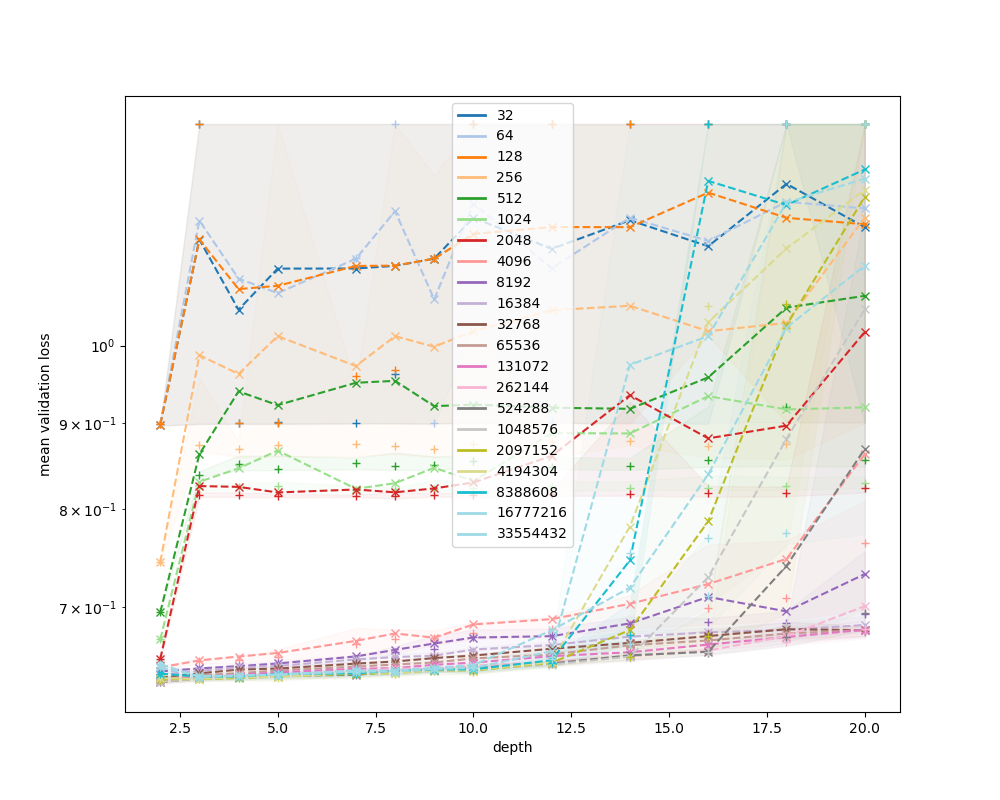

<IPython.core.display.Javascript object>


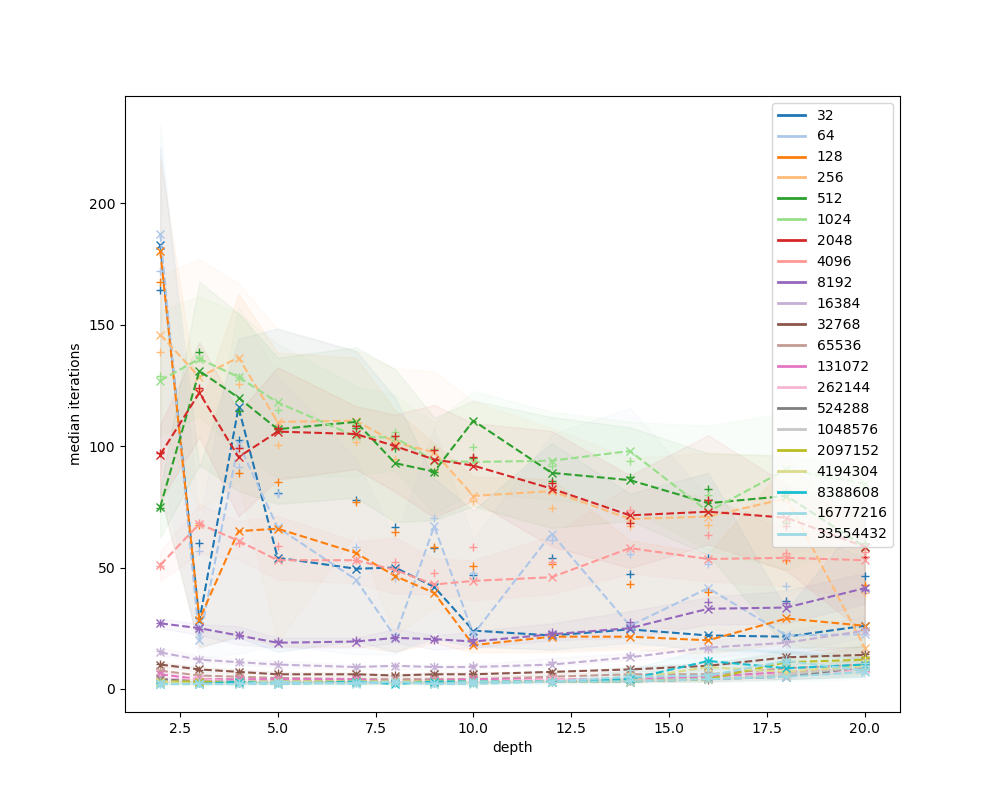

<IPython.core.display.Javascript object>


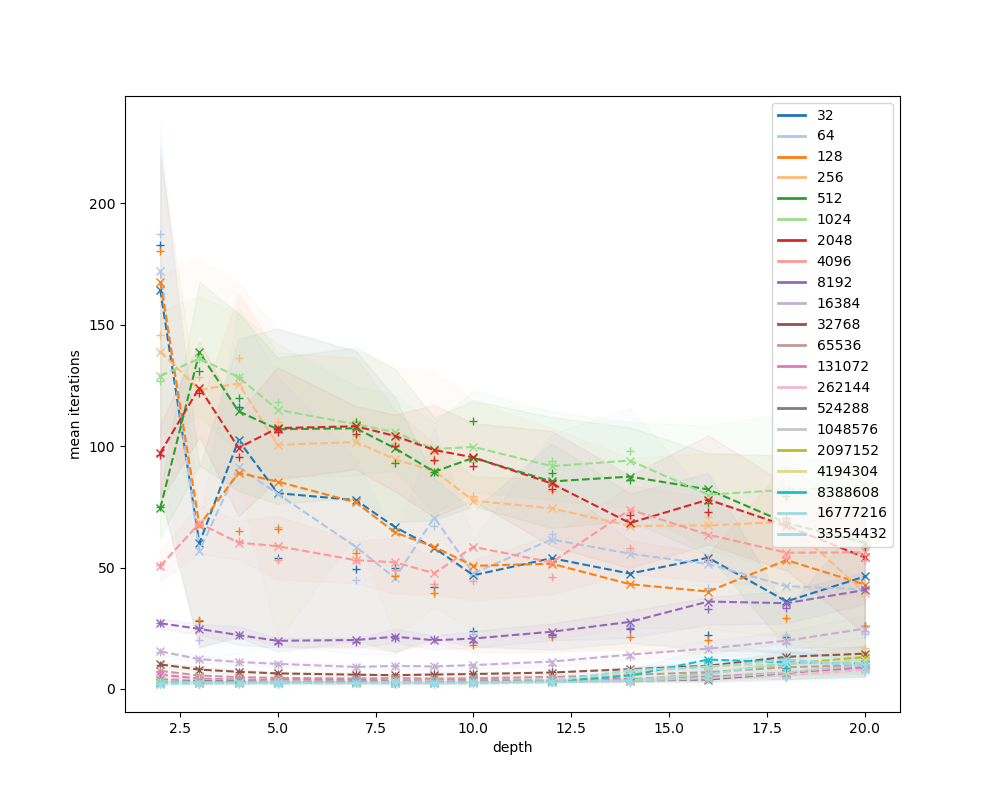

In [76]:
plot_dataset('sleep')

{'config.topology': 'wide_first', 'config.residual_mode': 'none'}


<IPython.core.display.Javascript object>


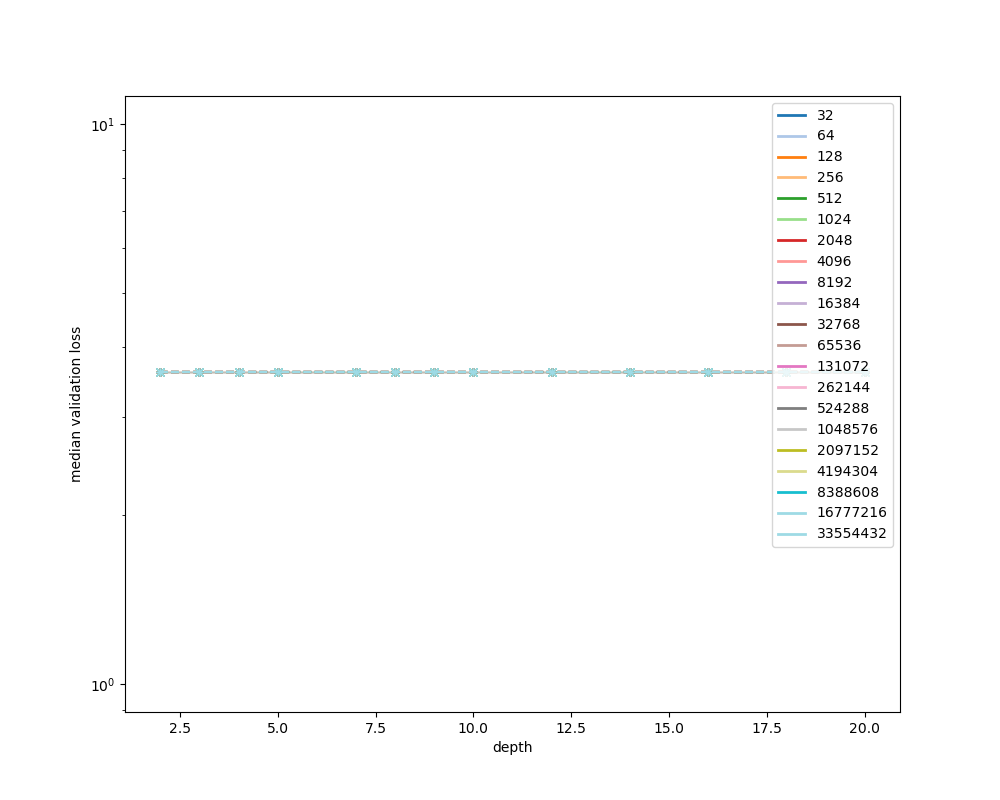

<IPython.core.display.Javascript object>


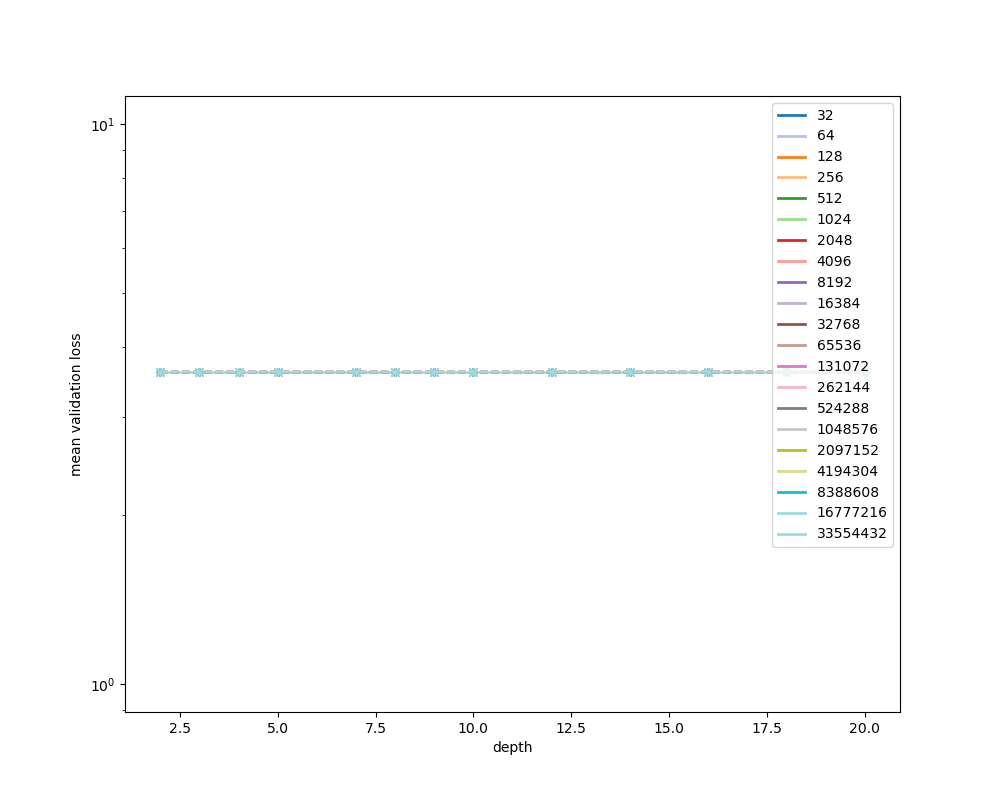

<IPython.core.display.Javascript object>


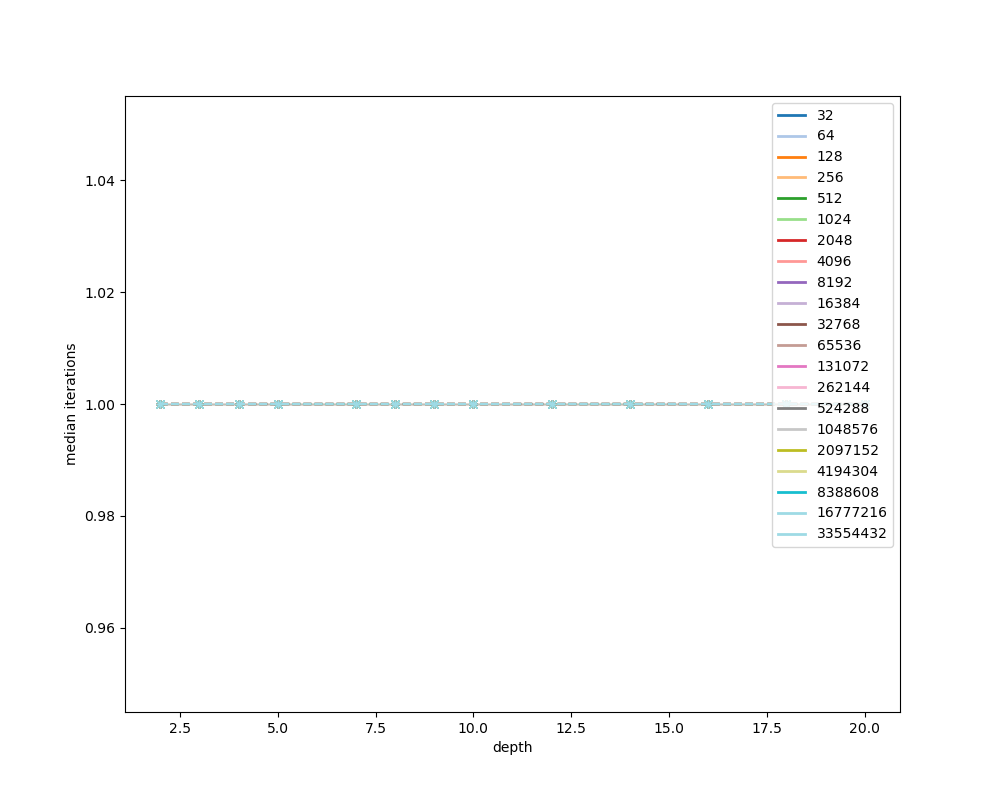

<IPython.core.display.Javascript object>


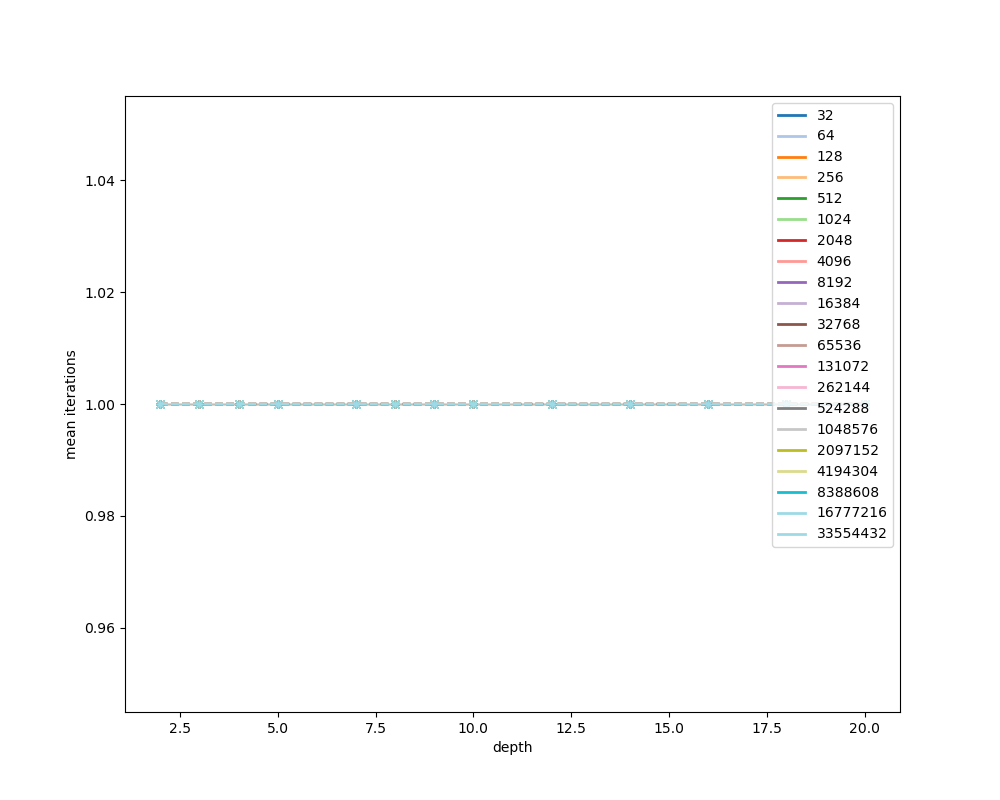

{'config.topology': 'wide_first', 'config.residual_mode': 'full'}


<IPython.core.display.Javascript object>


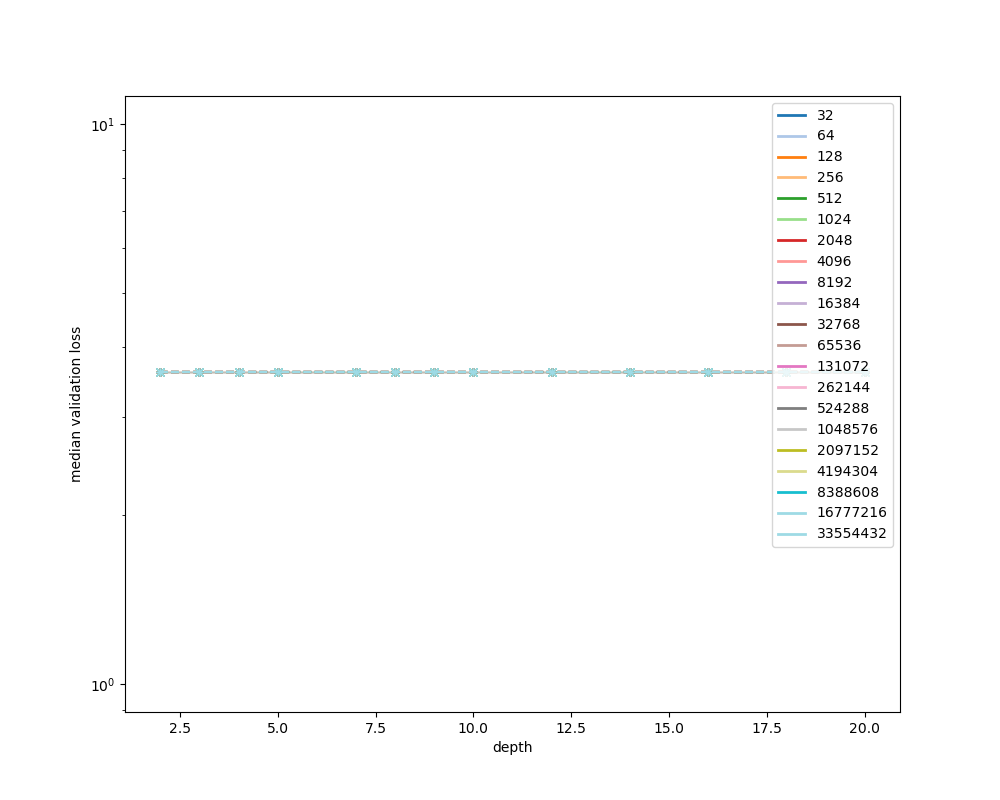

<IPython.core.display.Javascript object>


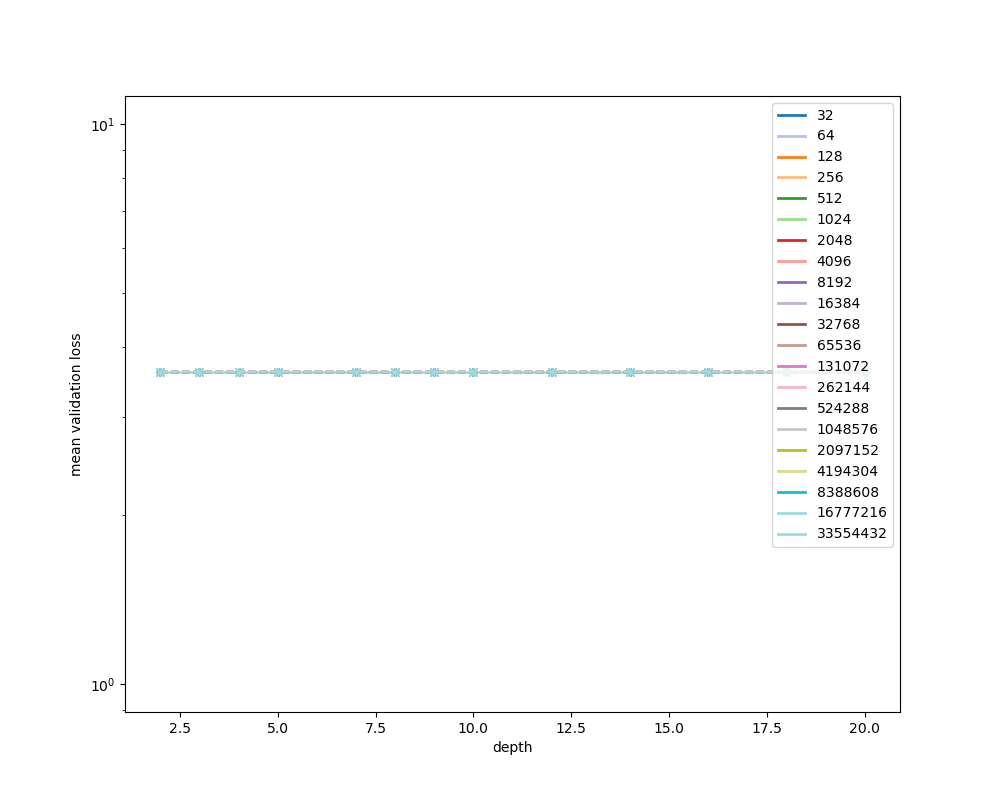

<IPython.core.display.Javascript object>


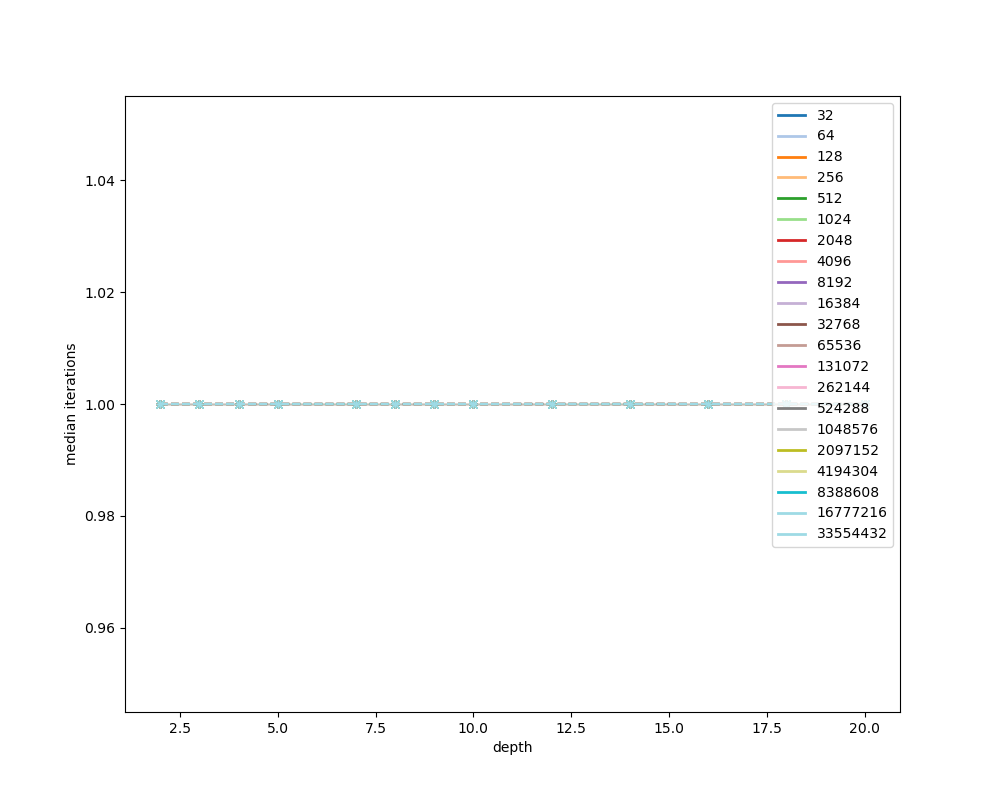

<IPython.core.display.Javascript object>


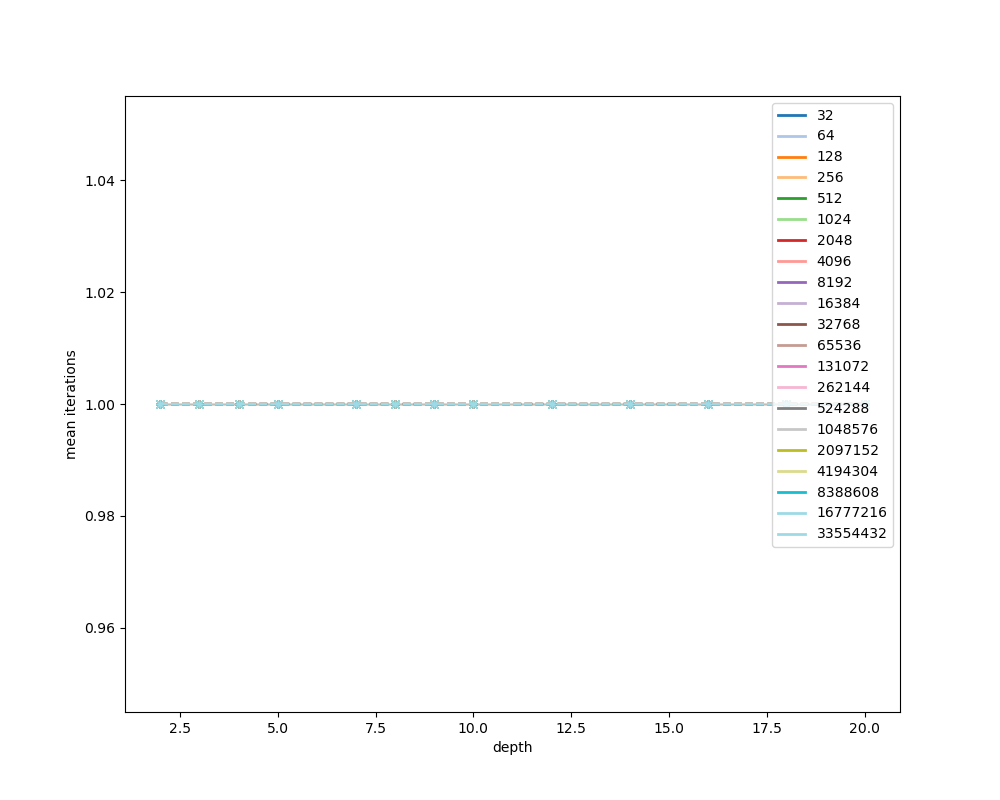

{'config.topology': 'rectangle', 'config.residual_mode': 'full'}


<IPython.core.display.Javascript object>


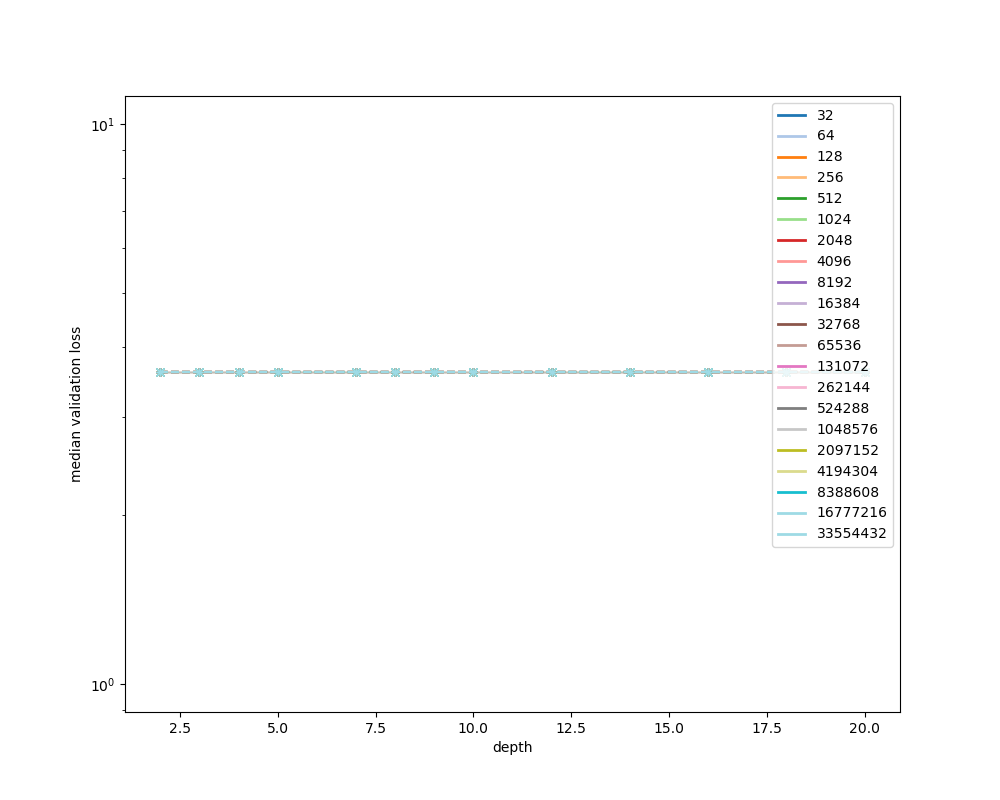

<IPython.core.display.Javascript object>


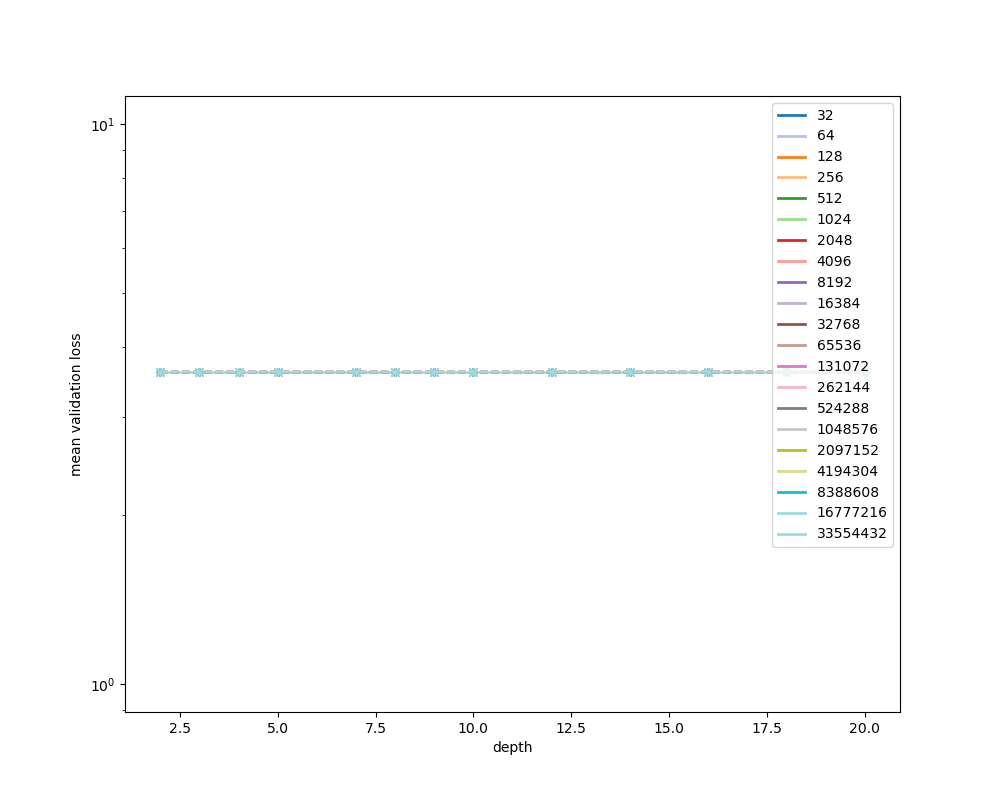

<IPython.core.display.Javascript object>


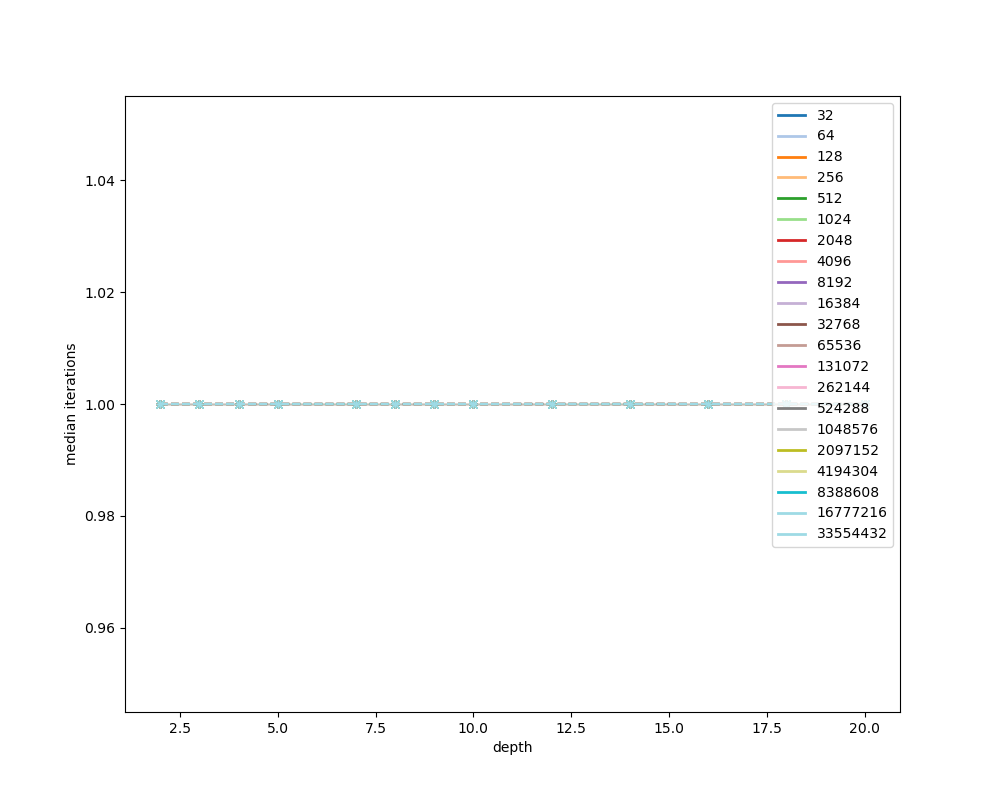

<IPython.core.display.Javascript object>


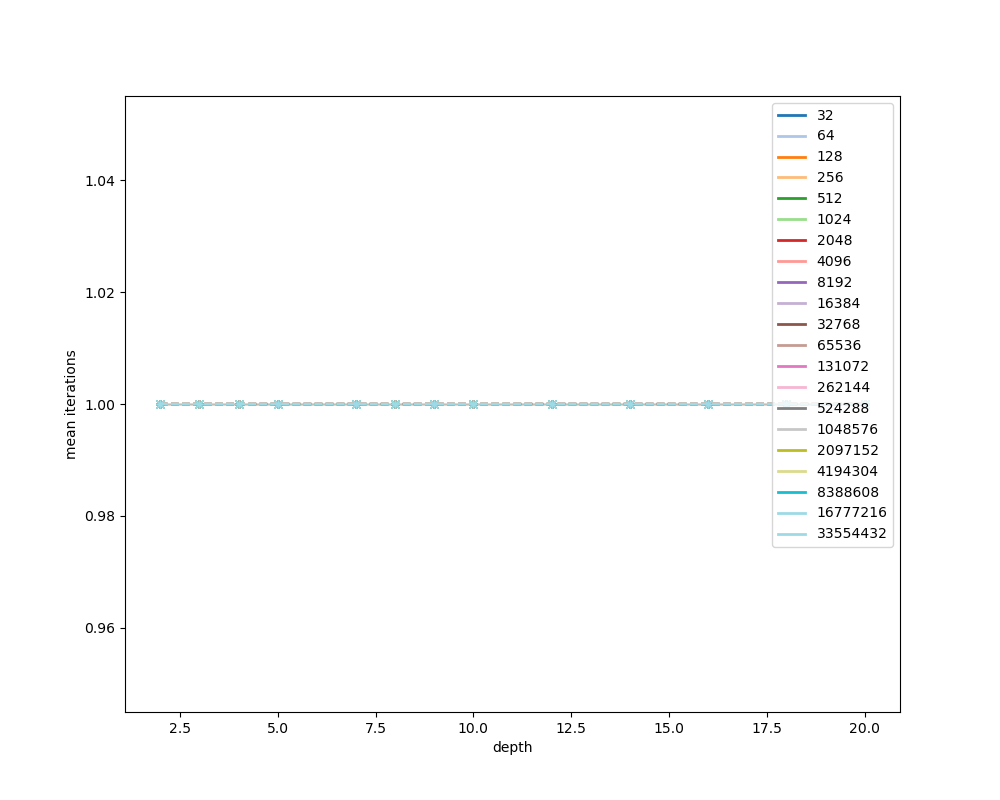

{'config.topology': 'rectangle', 'config.residual_mode': 'none'}


<IPython.core.display.Javascript object>


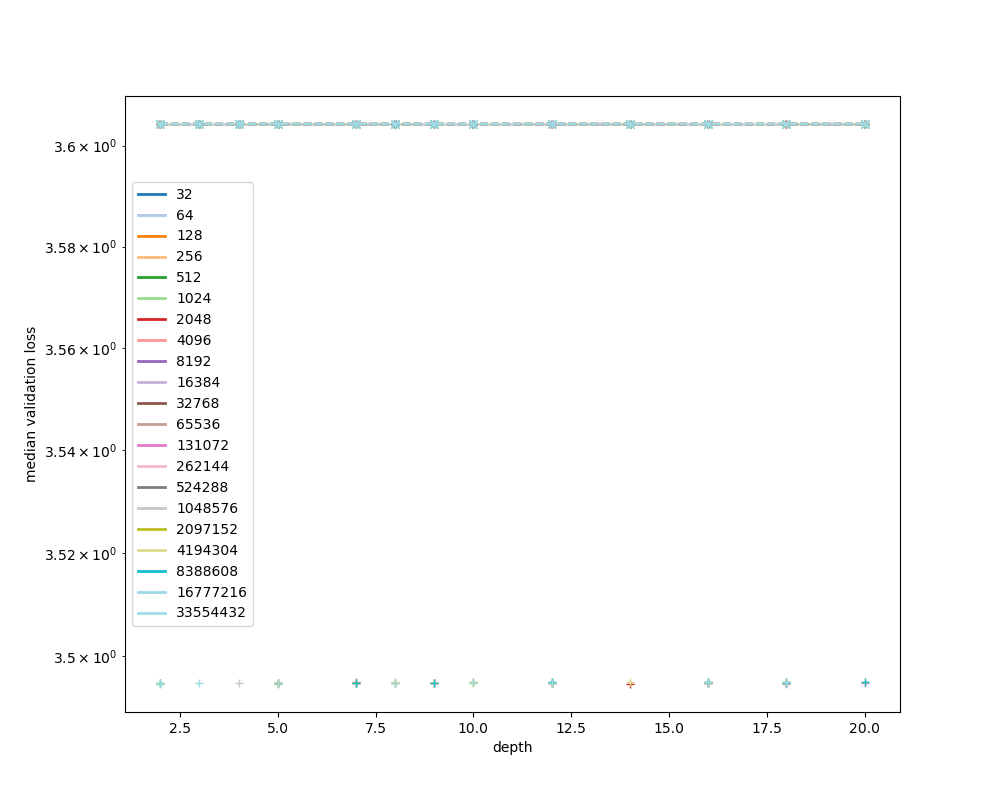

<IPython.core.display.Javascript object>


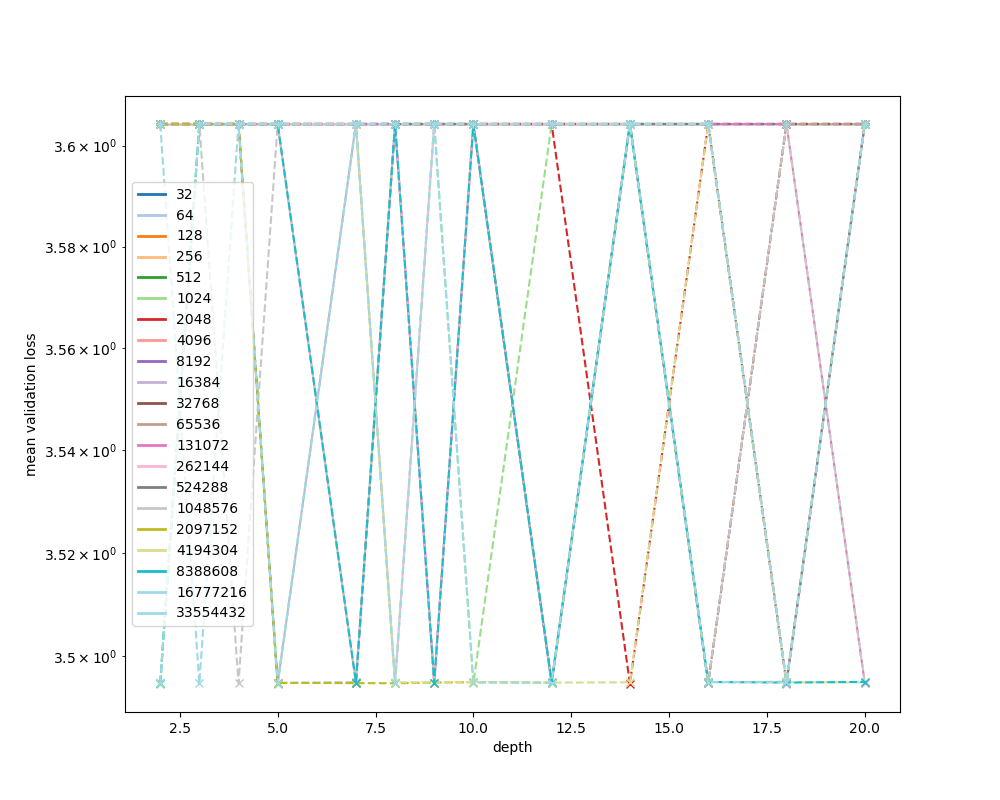

<IPython.core.display.Javascript object>


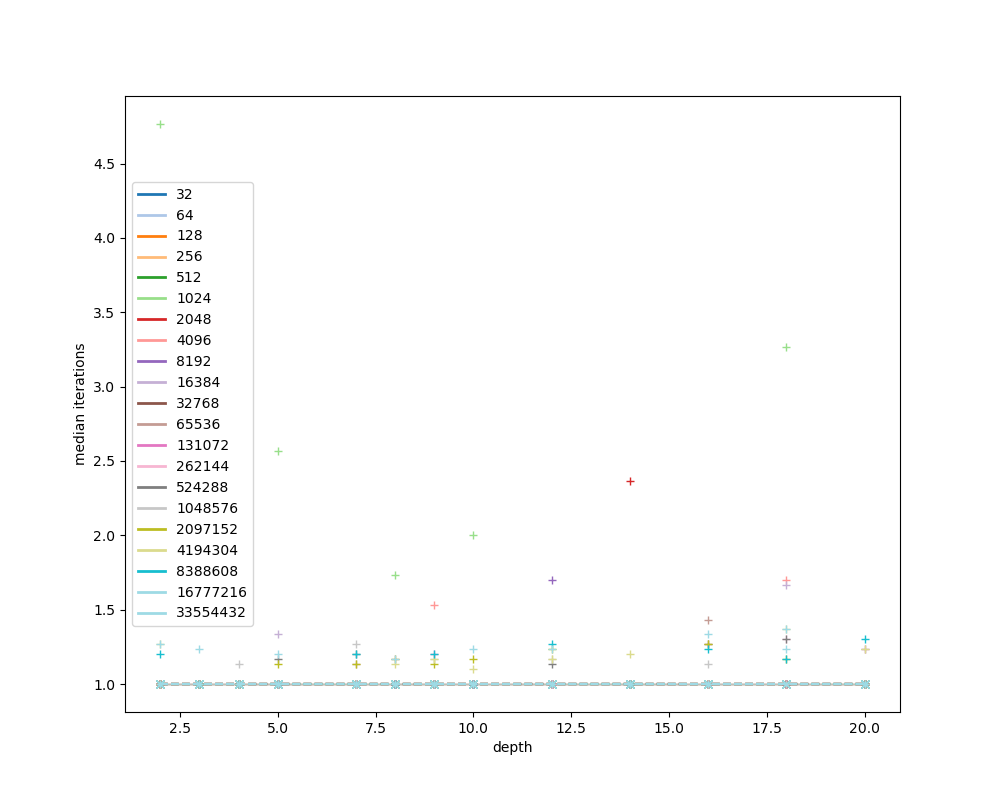

<IPython.core.display.Javascript object>


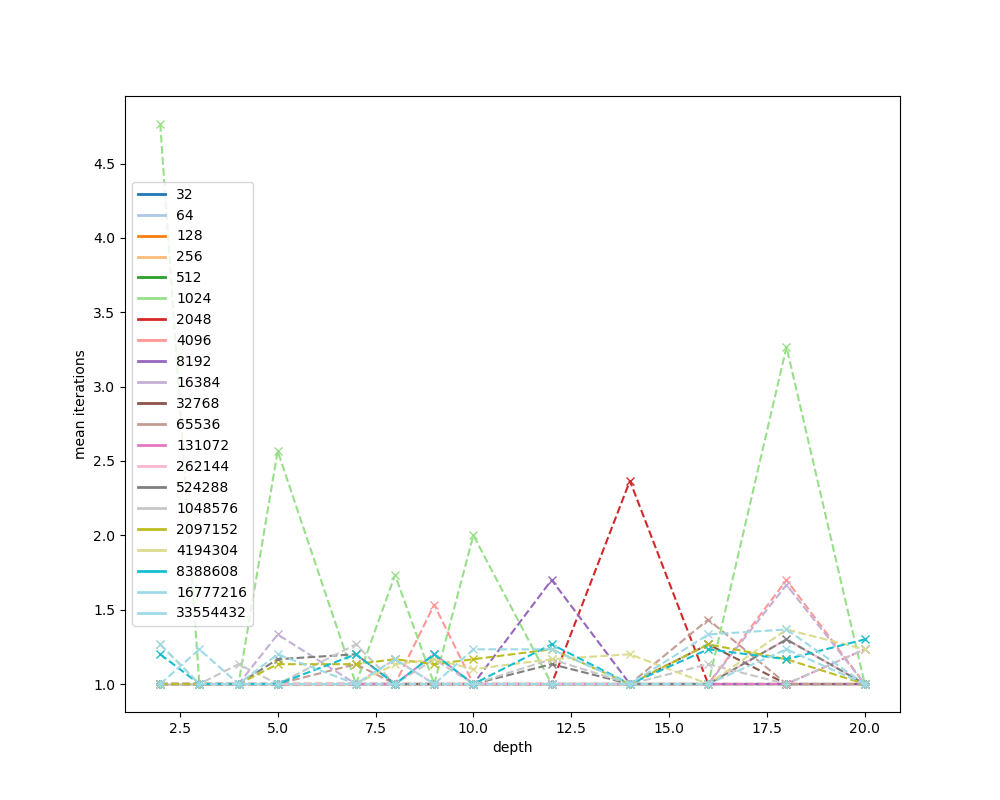

{'config.topology': 'exponential', 'config.residual_mode': 'none'}


<IPython.core.display.Javascript object>


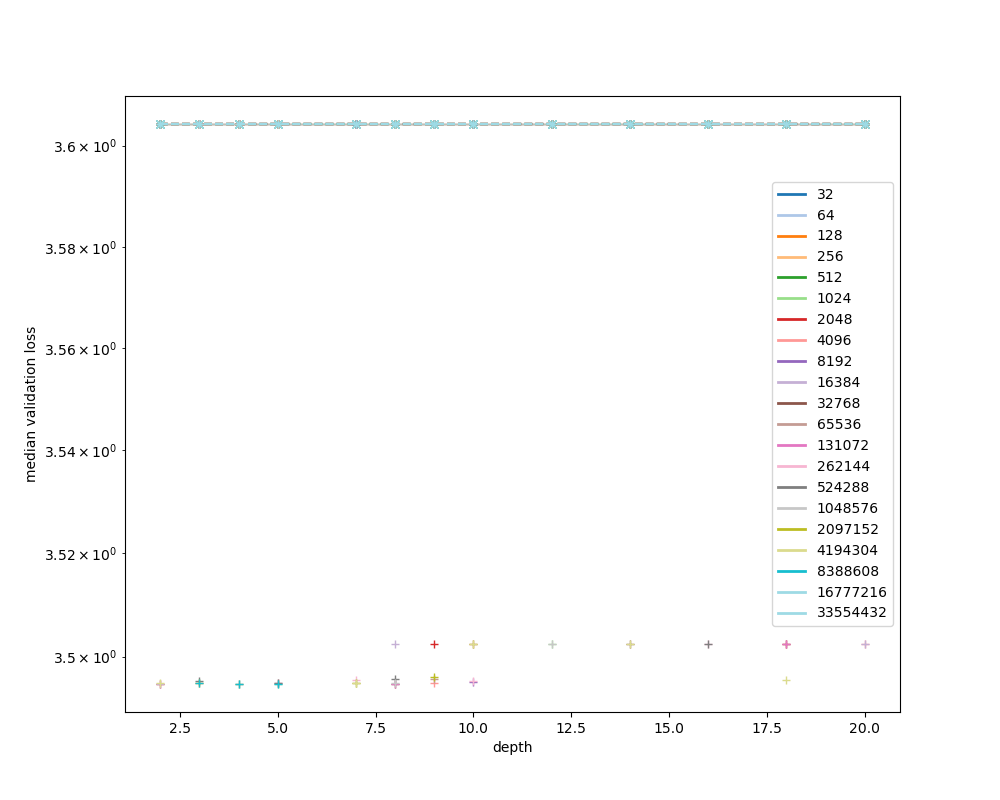

<IPython.core.display.Javascript object>


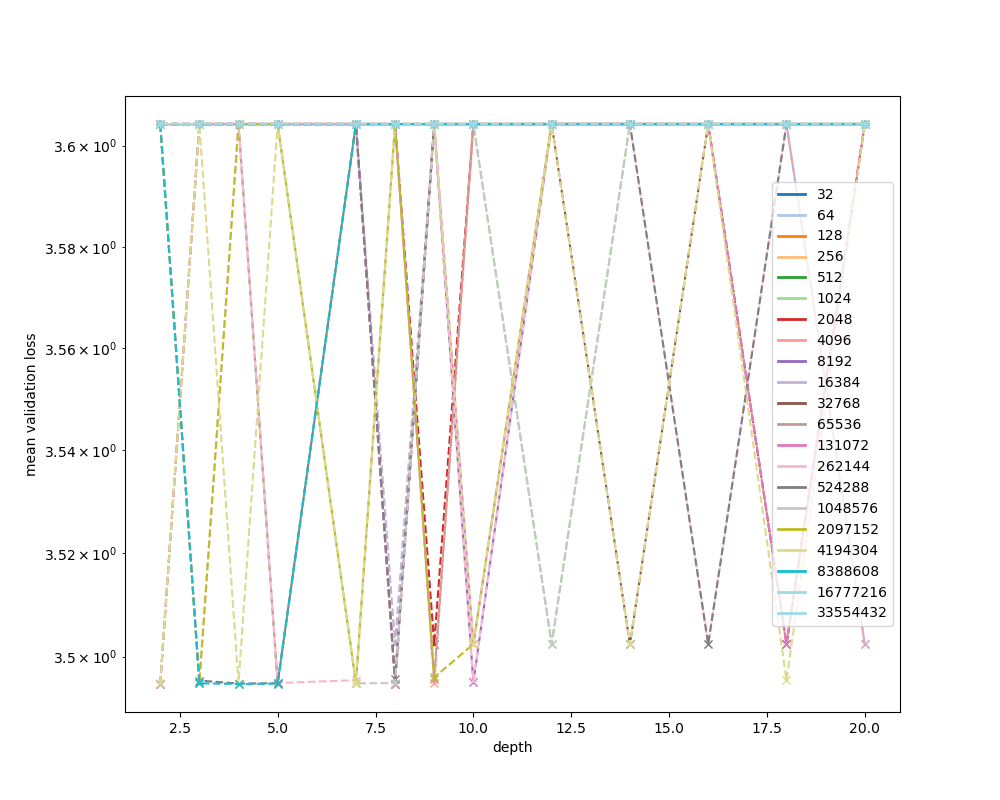

<IPython.core.display.Javascript object>


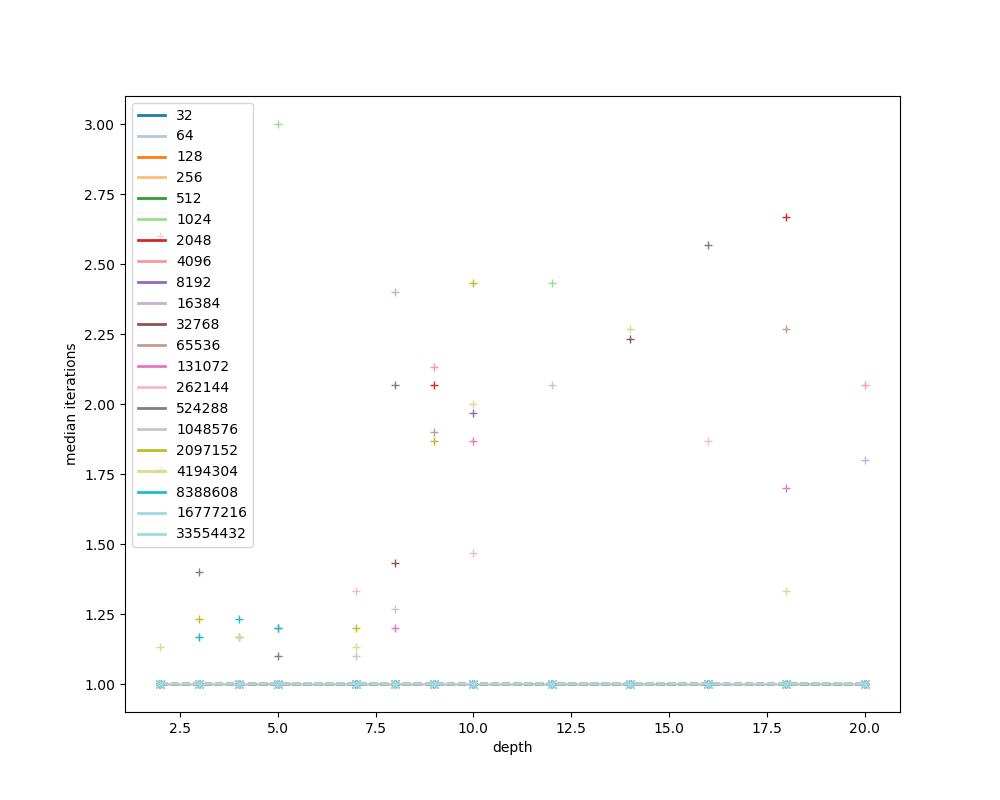

<IPython.core.display.Javascript object>


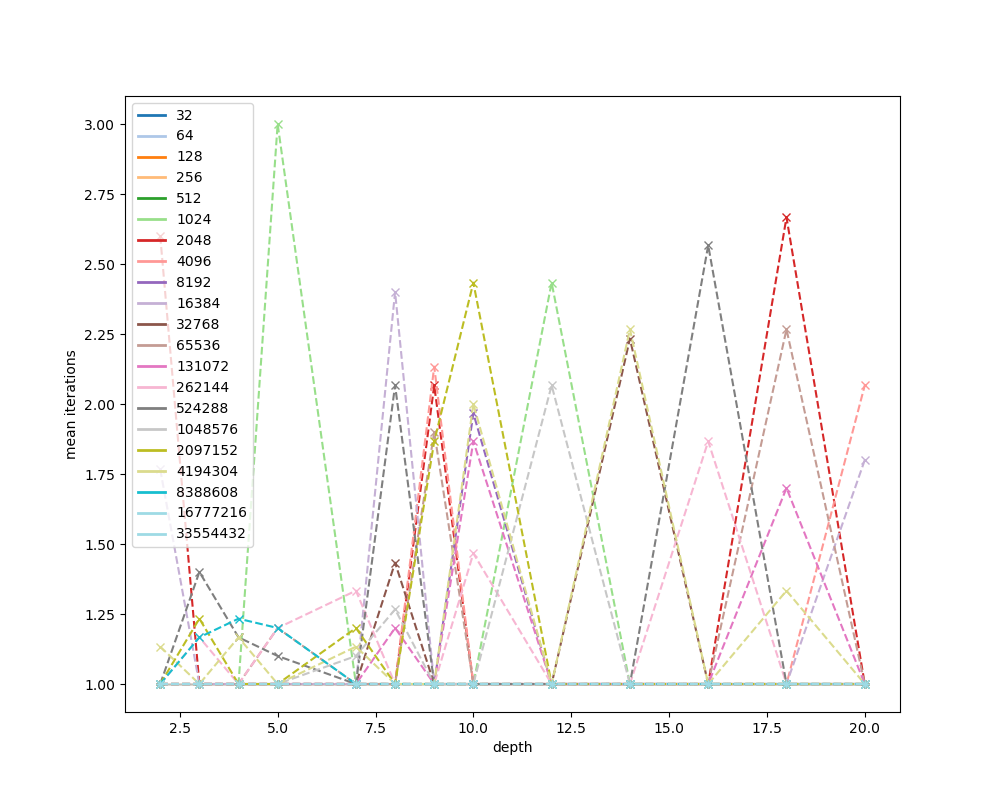

{'config.topology': 'trapezoid', 'config.residual_mode': 'none'}


<IPython.core.display.Javascript object>


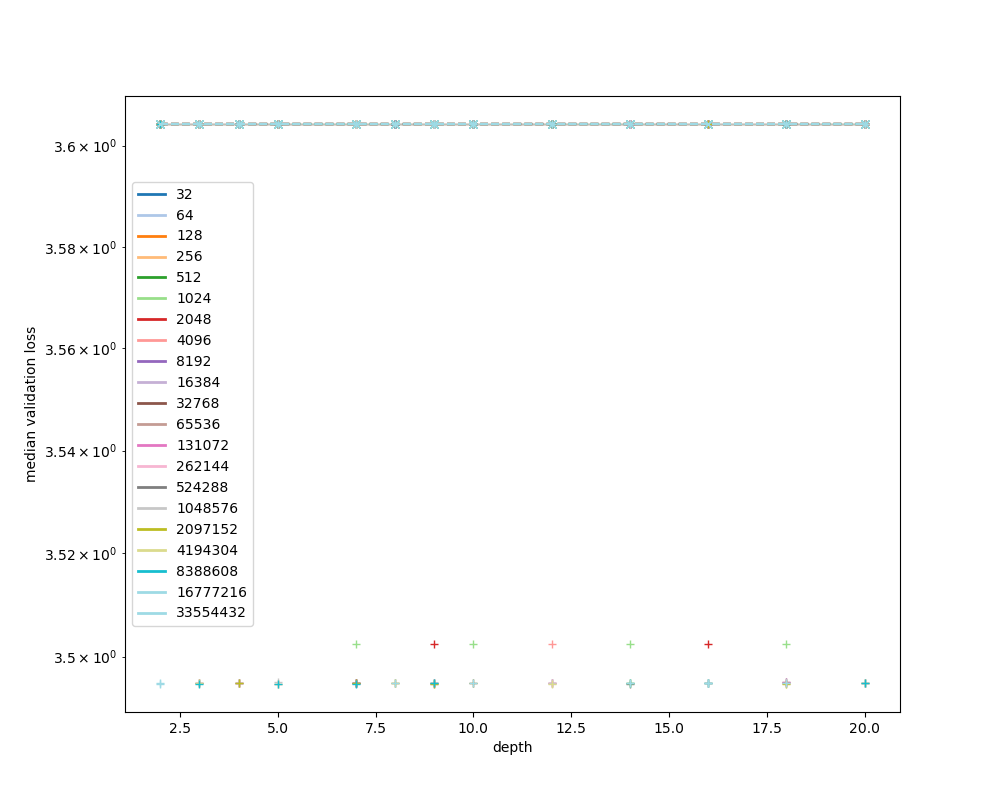

<IPython.core.display.Javascript object>


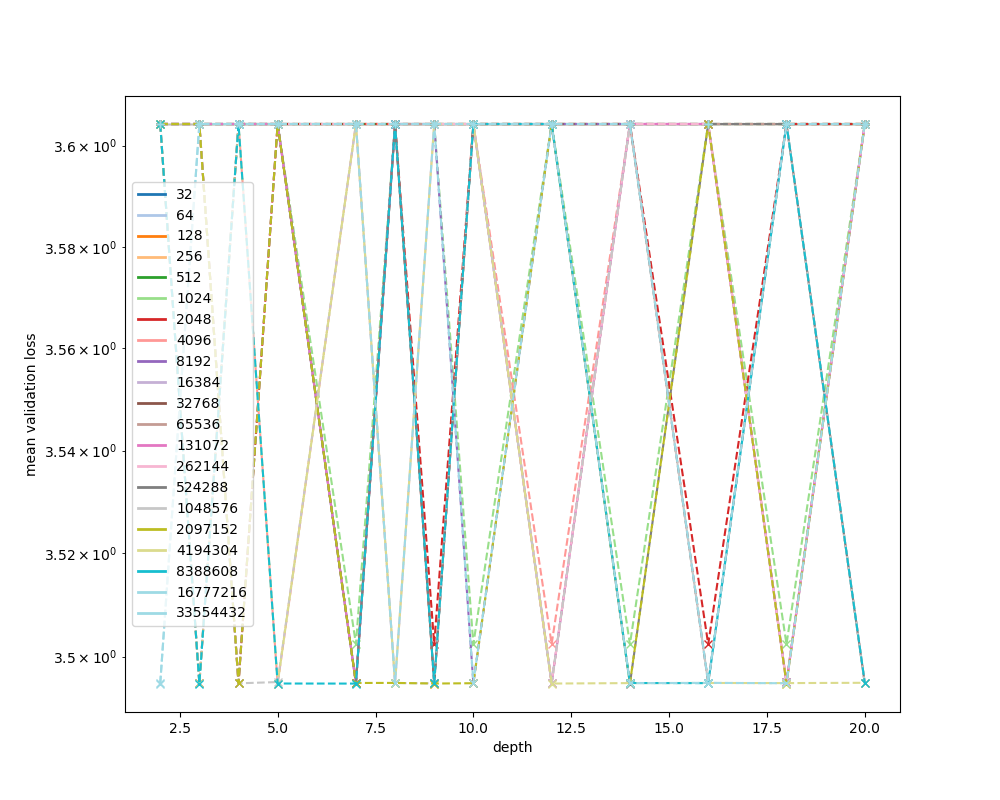

<IPython.core.display.Javascript object>


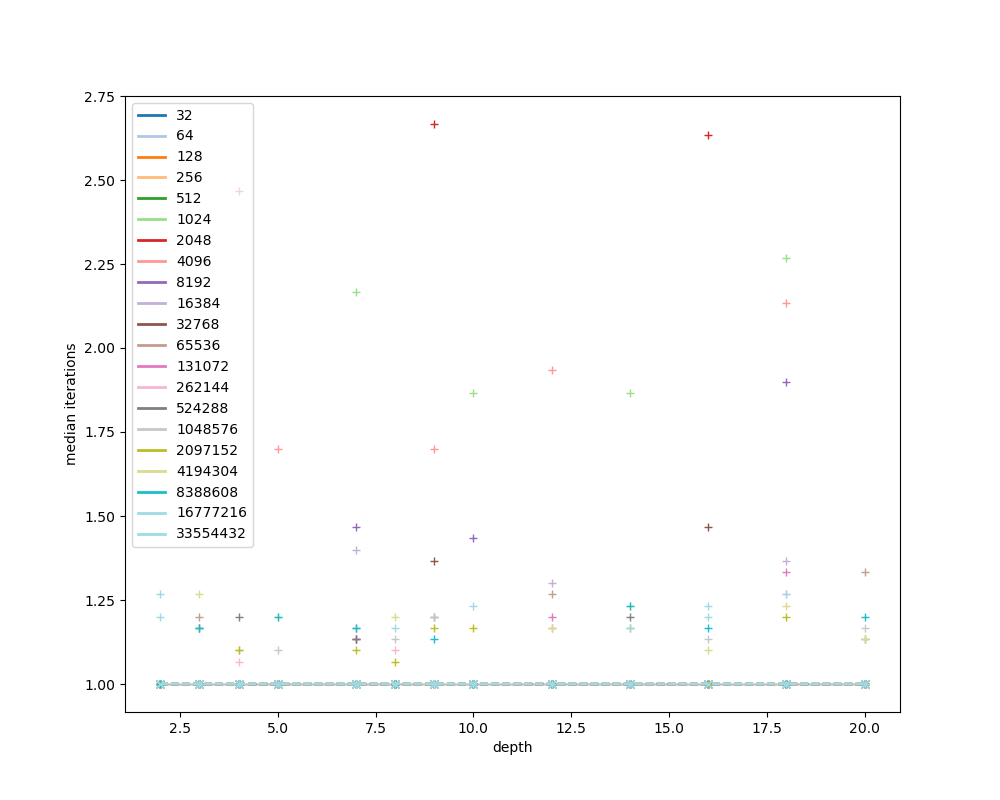

<IPython.core.display.Javascript object>


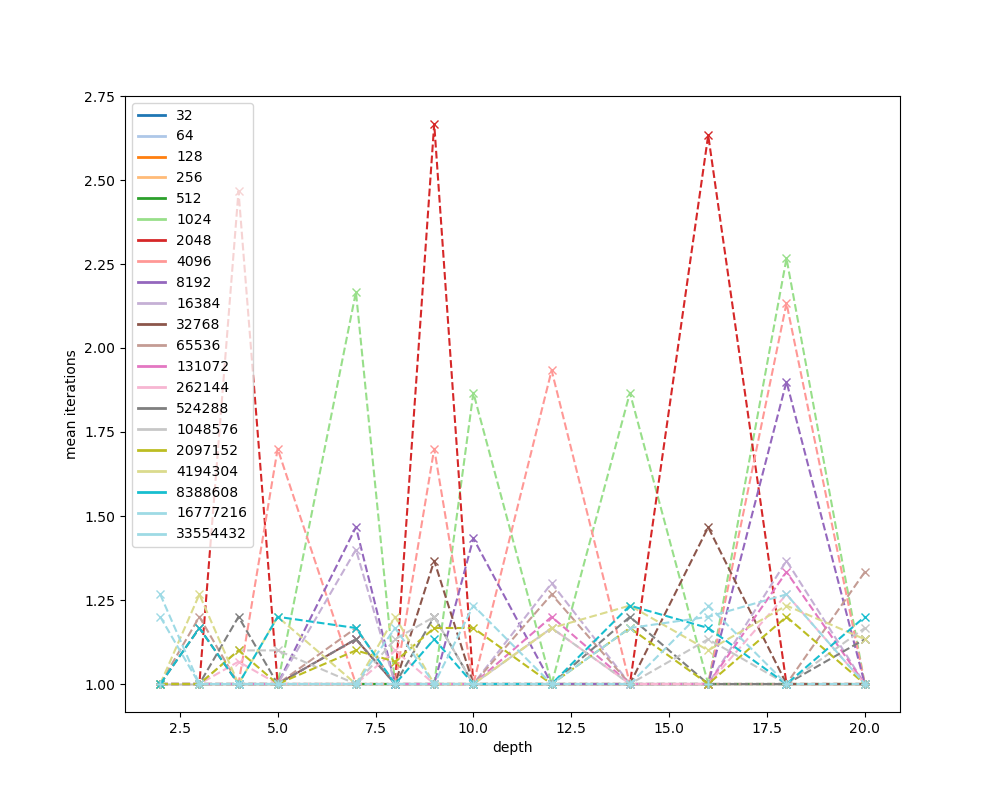

In [77]:
plot_dataset('adult')

{'config.topology': 'wide_first', 'config.residual_mode': 'none'}


<IPython.core.display.Javascript object>


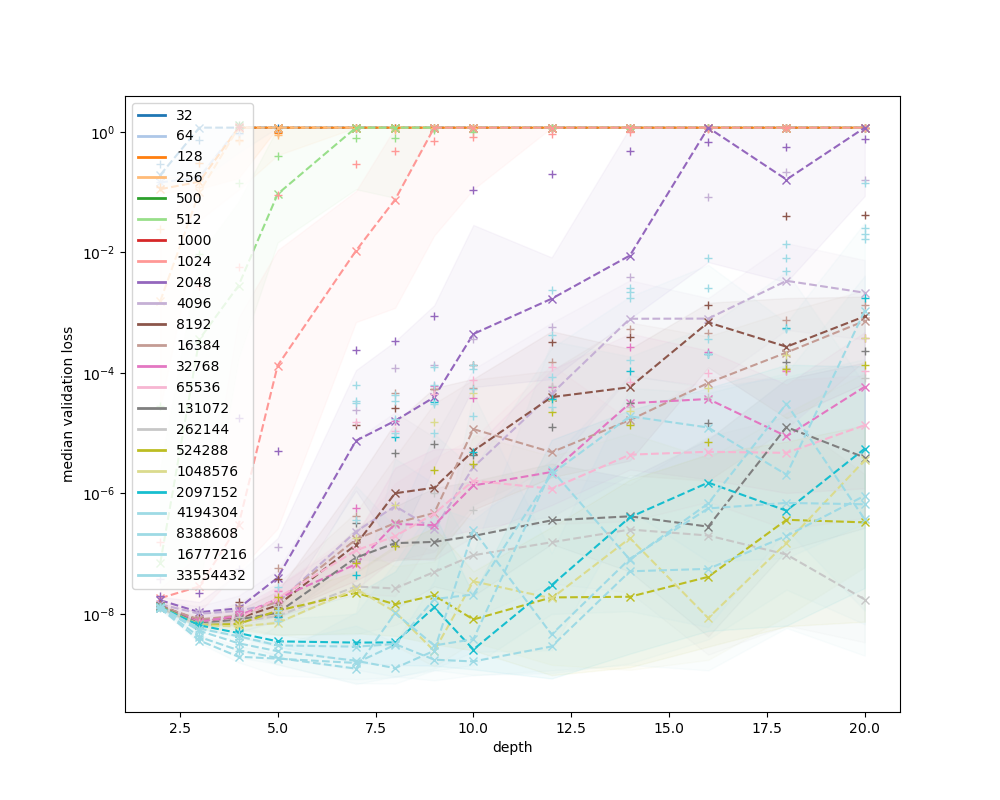

<IPython.core.display.Javascript object>


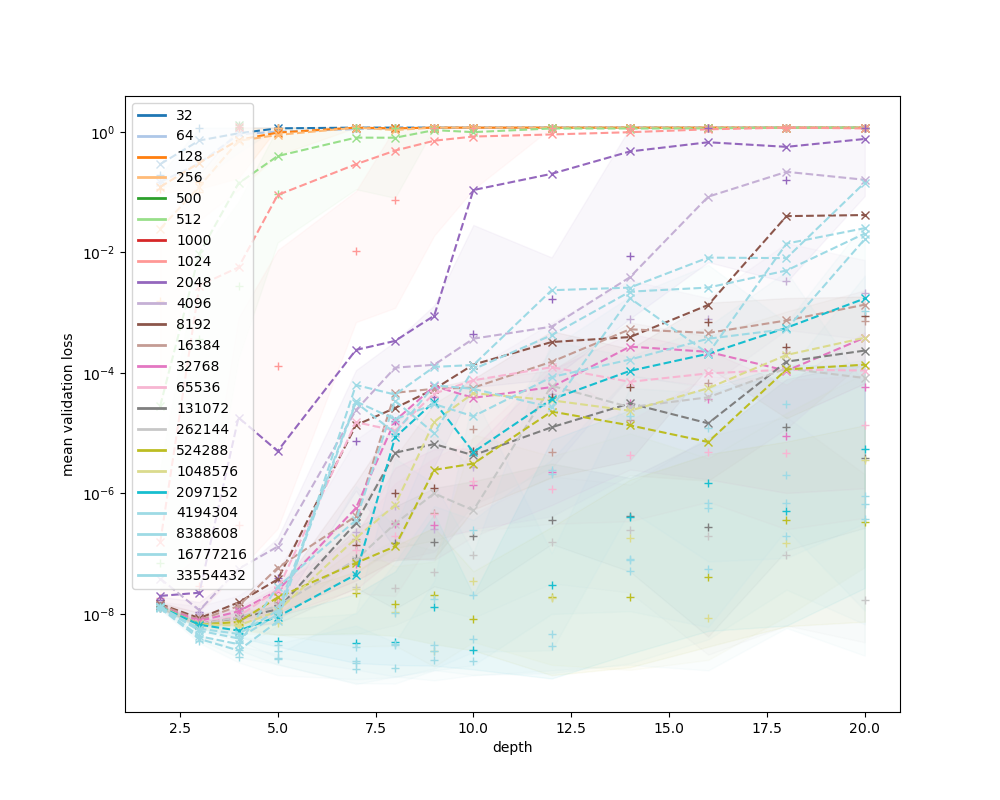

<IPython.core.display.Javascript object>


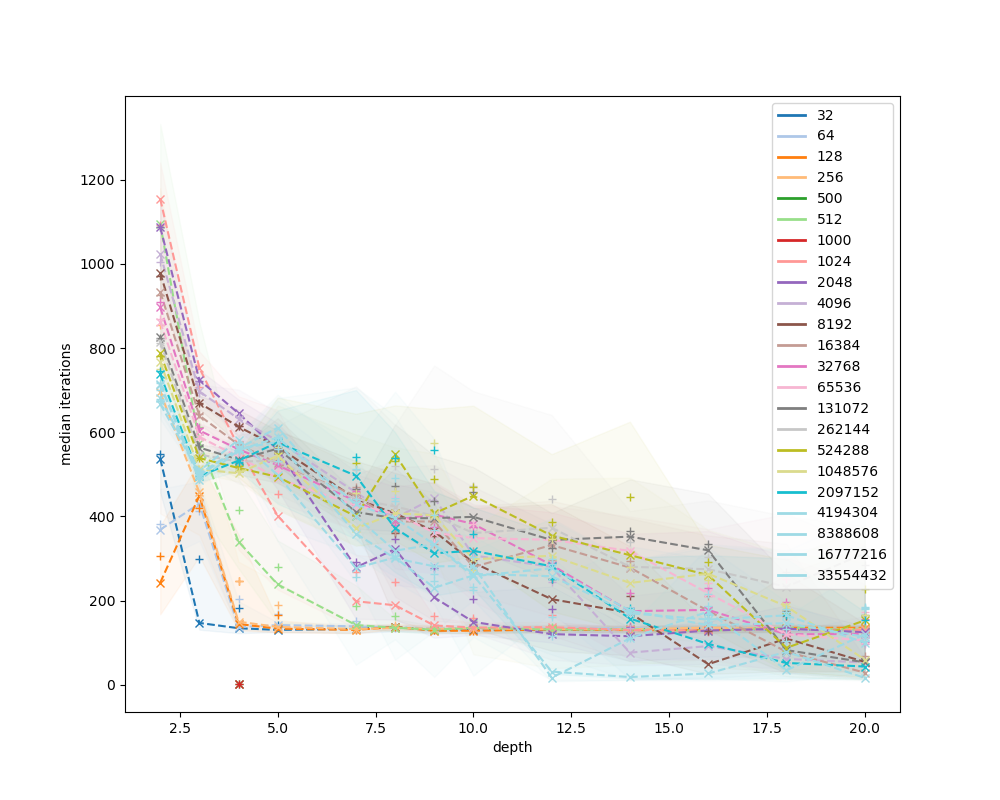

<IPython.core.display.Javascript object>


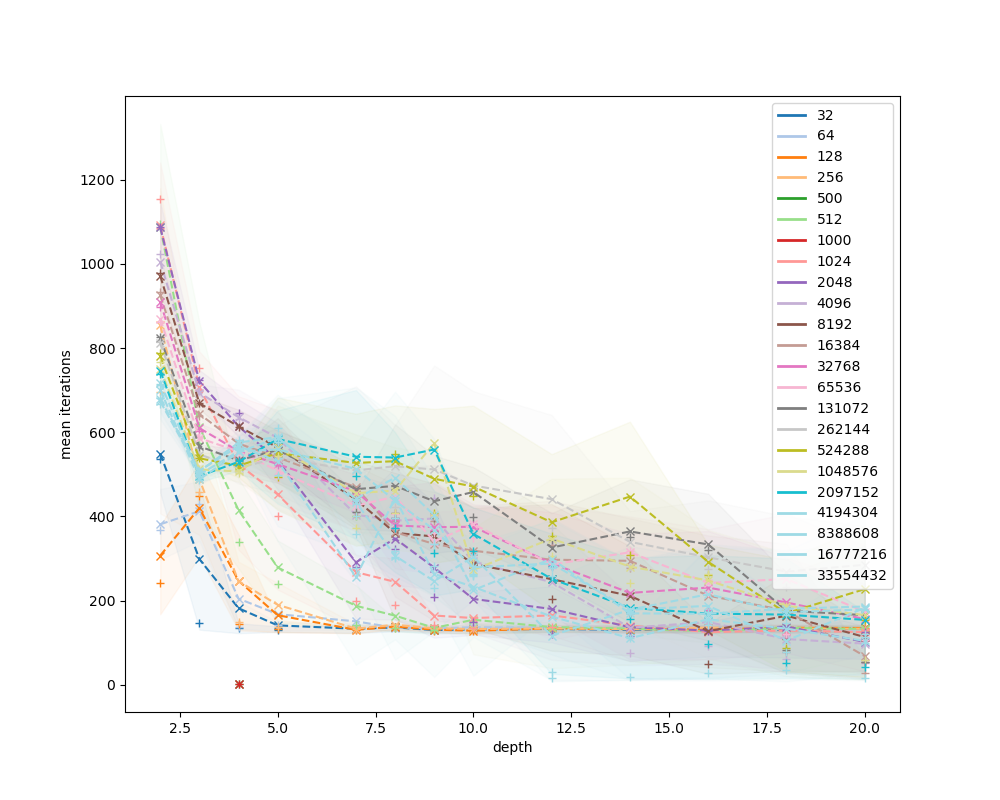

{'config.topology': 'wide_first', 'config.residual_mode': 'full'}


<IPython.core.display.Javascript object>


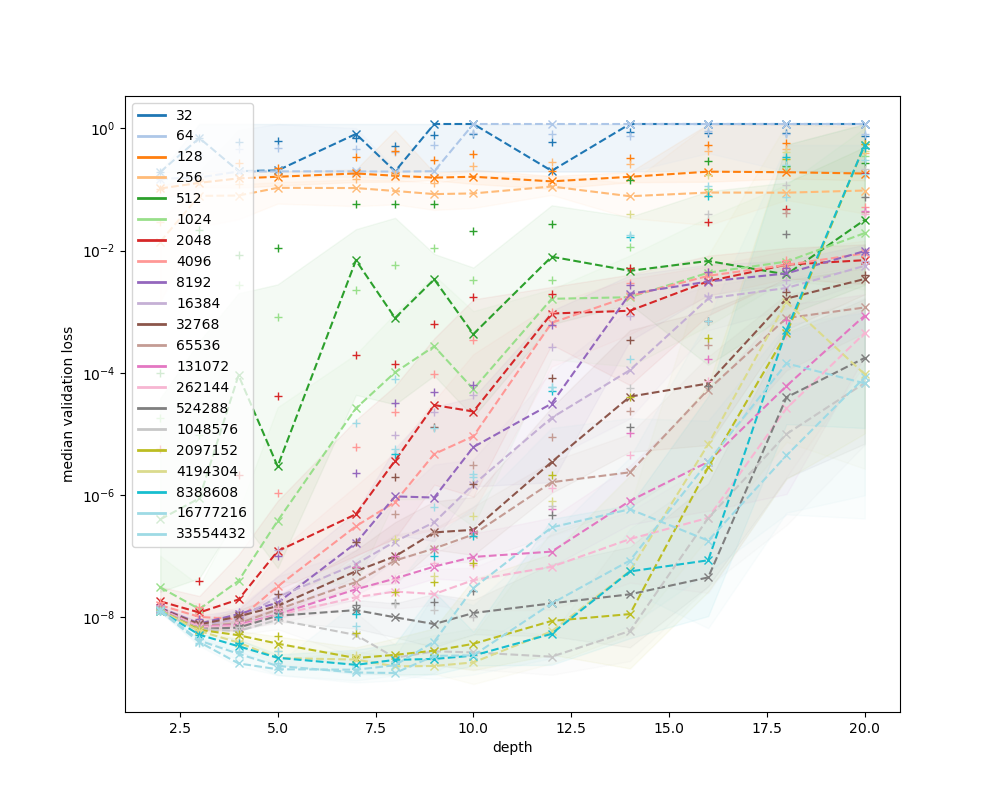

<IPython.core.display.Javascript object>


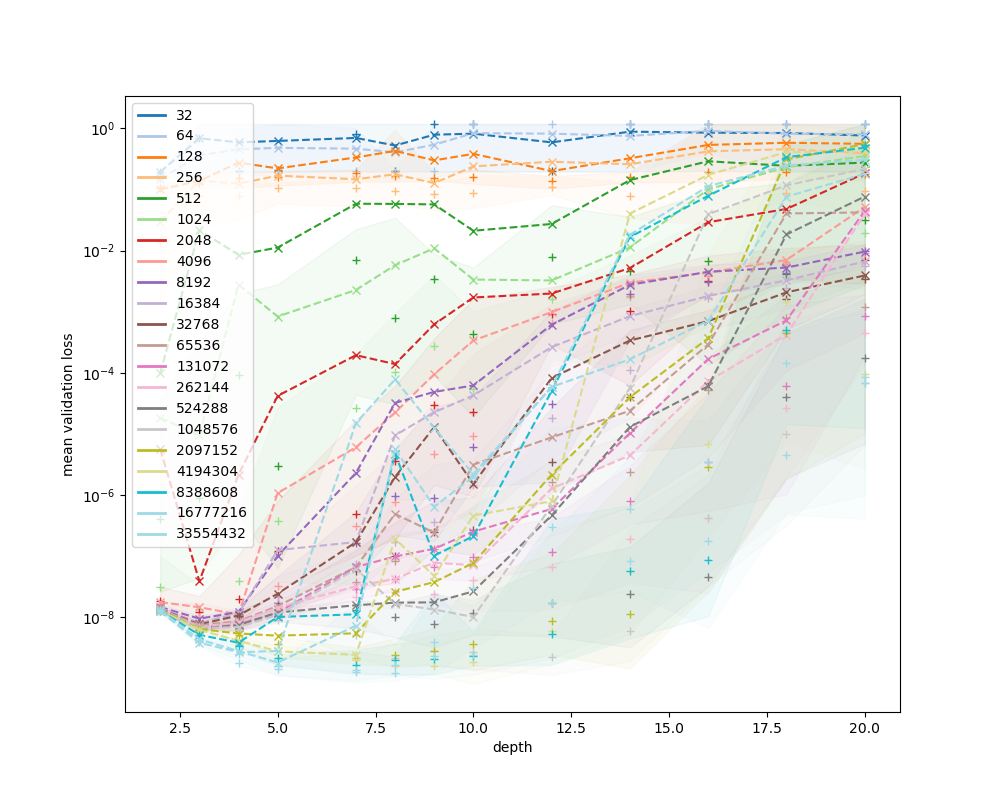

<IPython.core.display.Javascript object>


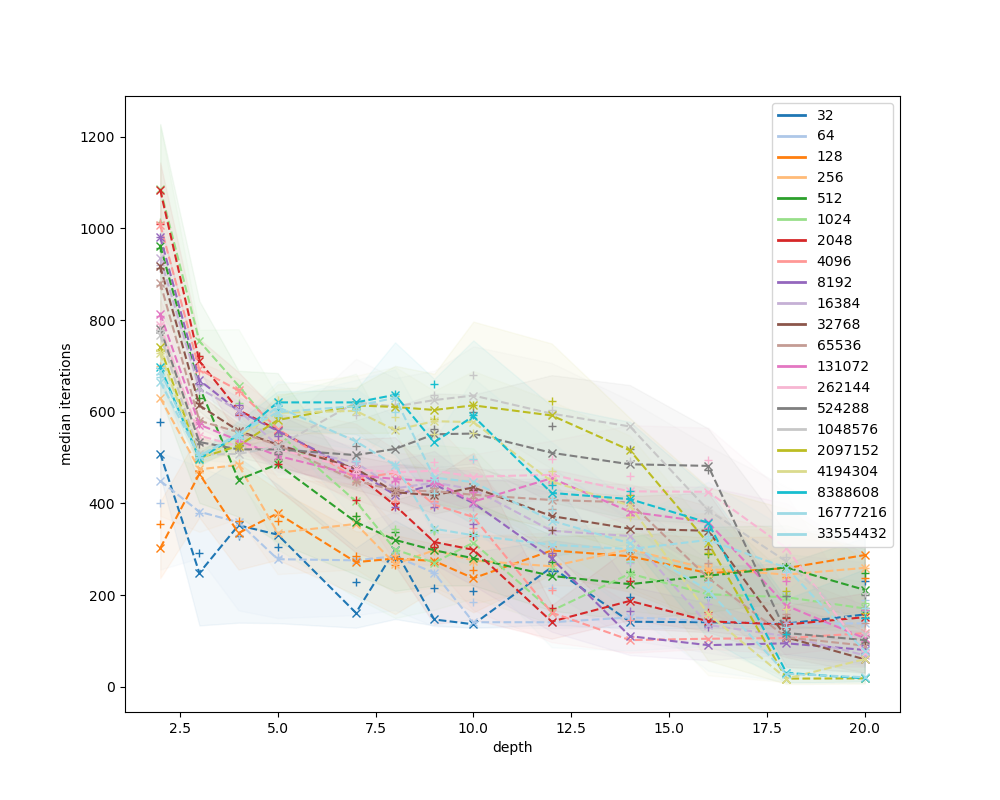

<IPython.core.display.Javascript object>


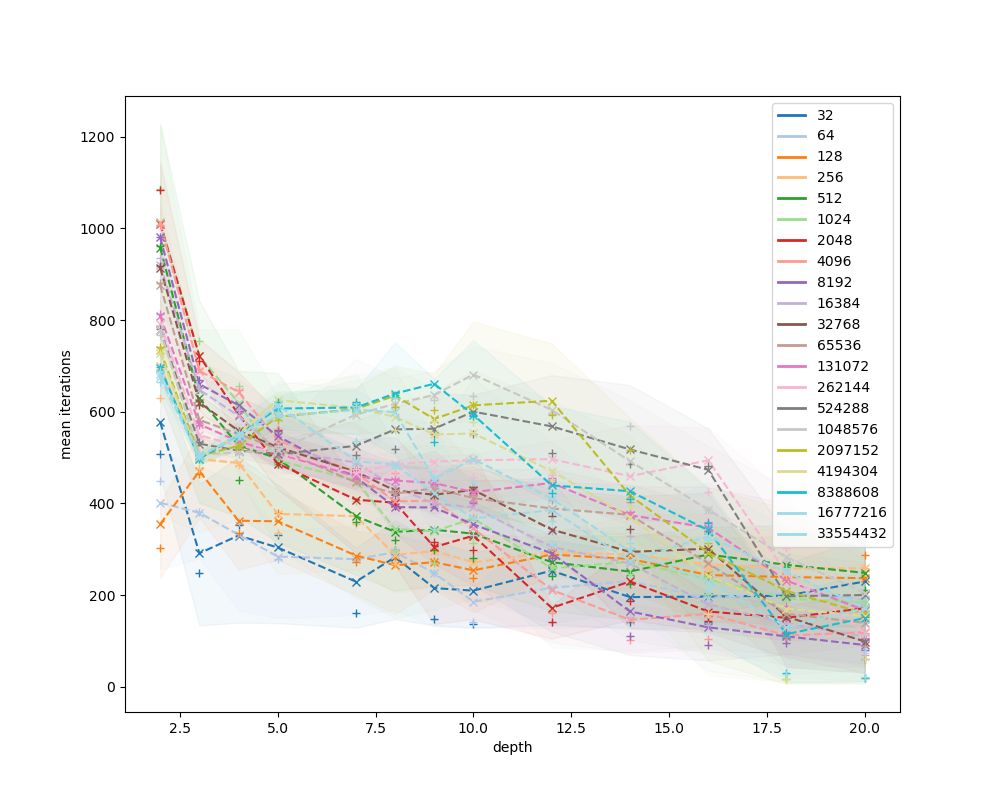

{'config.topology': 'rectangle', 'config.residual_mode': 'full'}


<IPython.core.display.Javascript object>


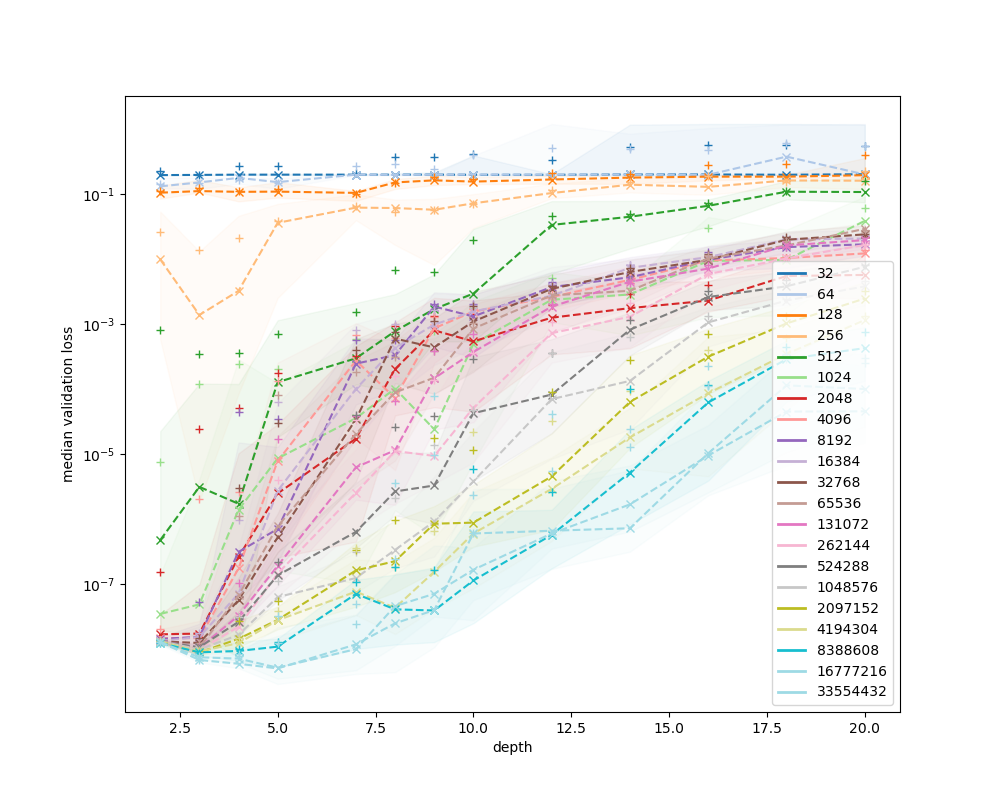

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


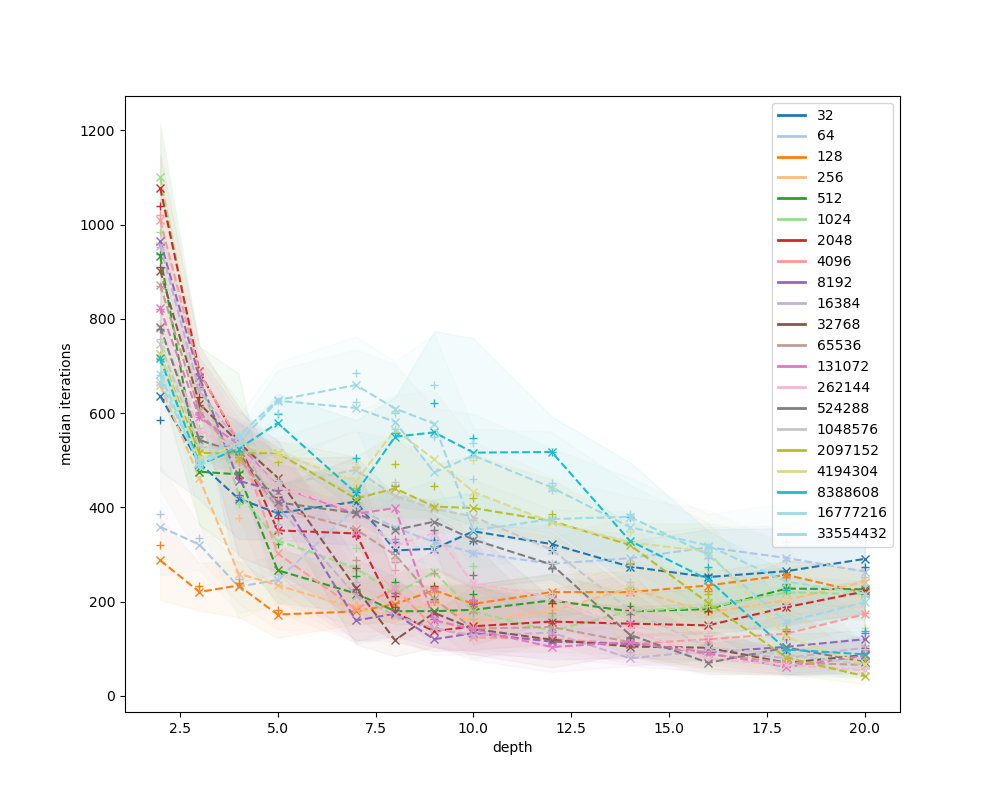

<IPython.core.display.Javascript object>

{'config.topology': 'rectangle', 'config.residual_mode': 'none'}


<IPython.core.display.Javascript object>


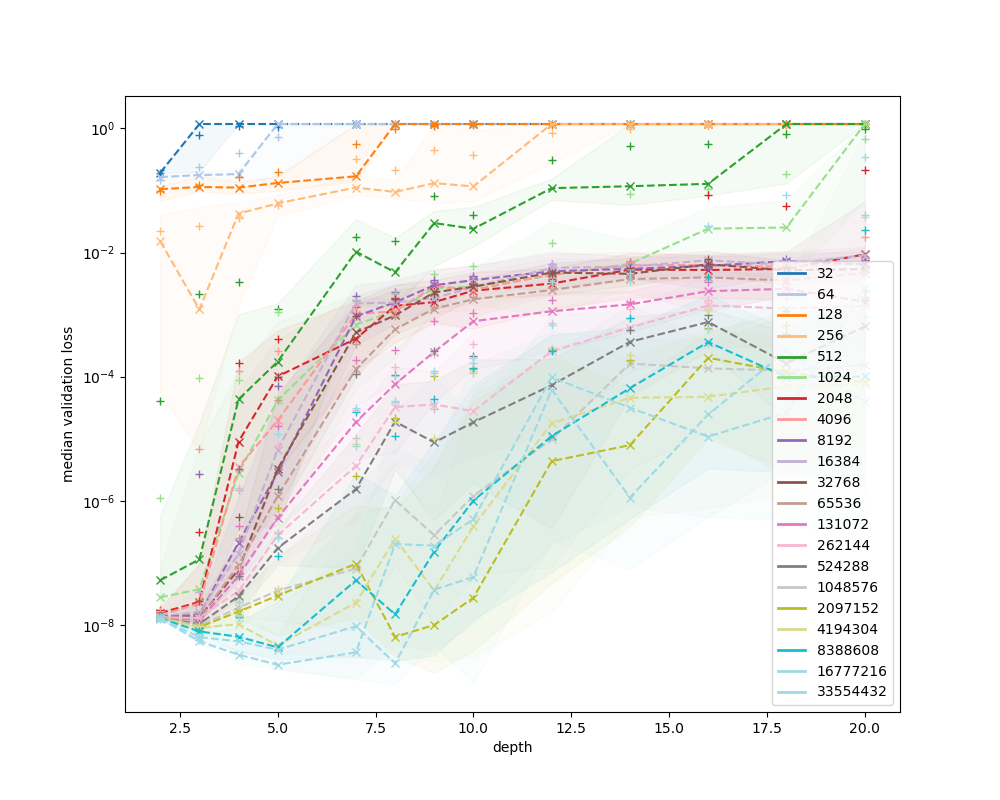

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


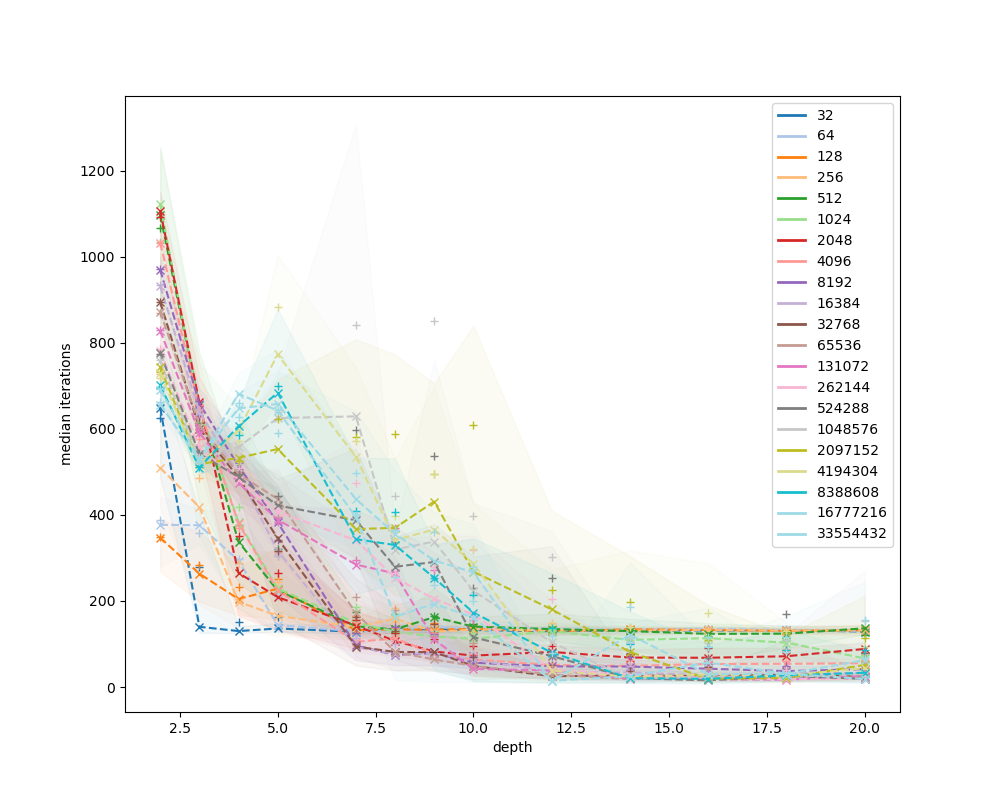

<IPython.core.display.Javascript object>


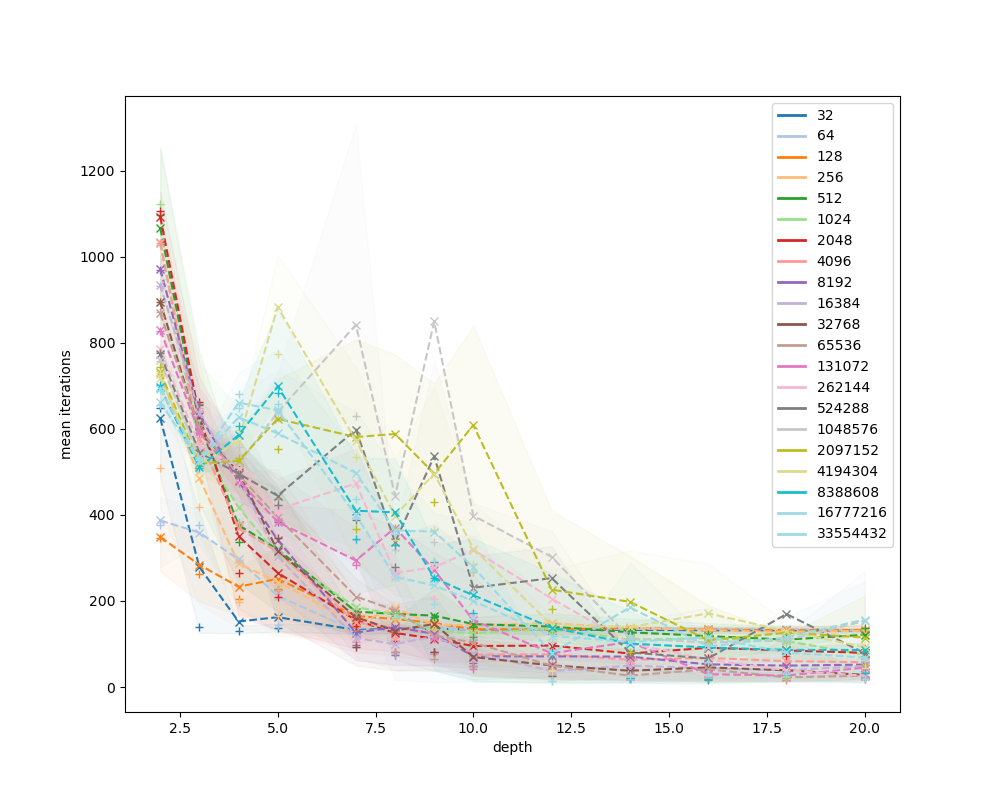

{'config.topology': 'trapezoid', 'config.residual_mode': 'none'}


<IPython.core.display.Javascript object>


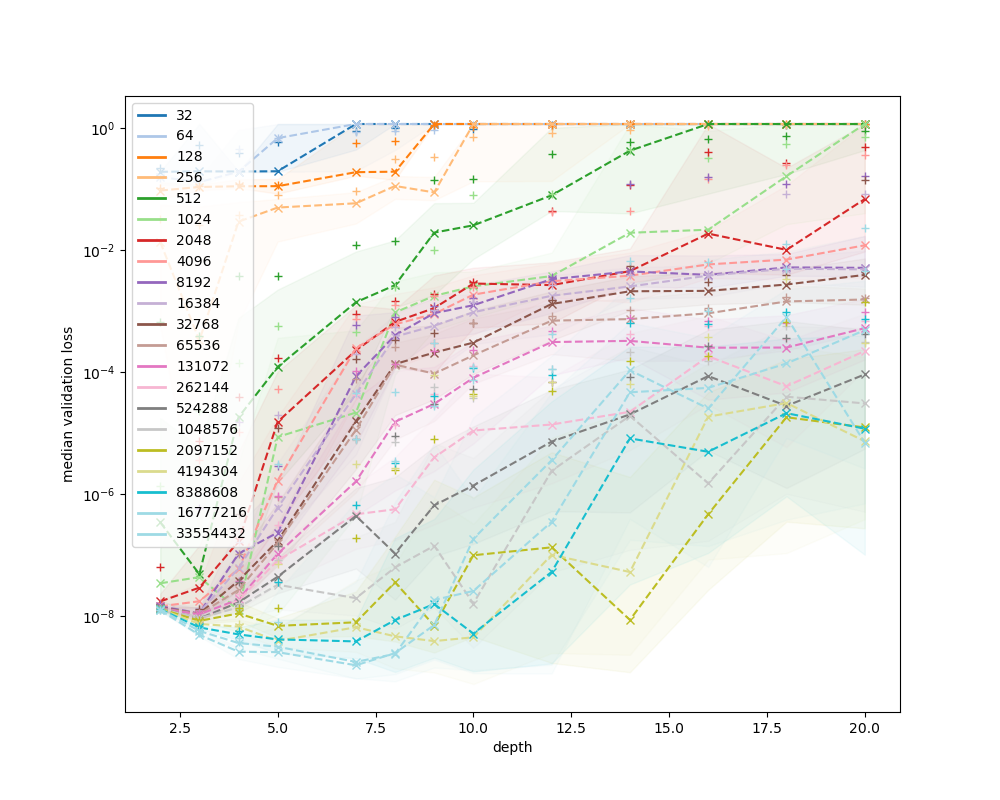

<IPython.core.display.Javascript object>


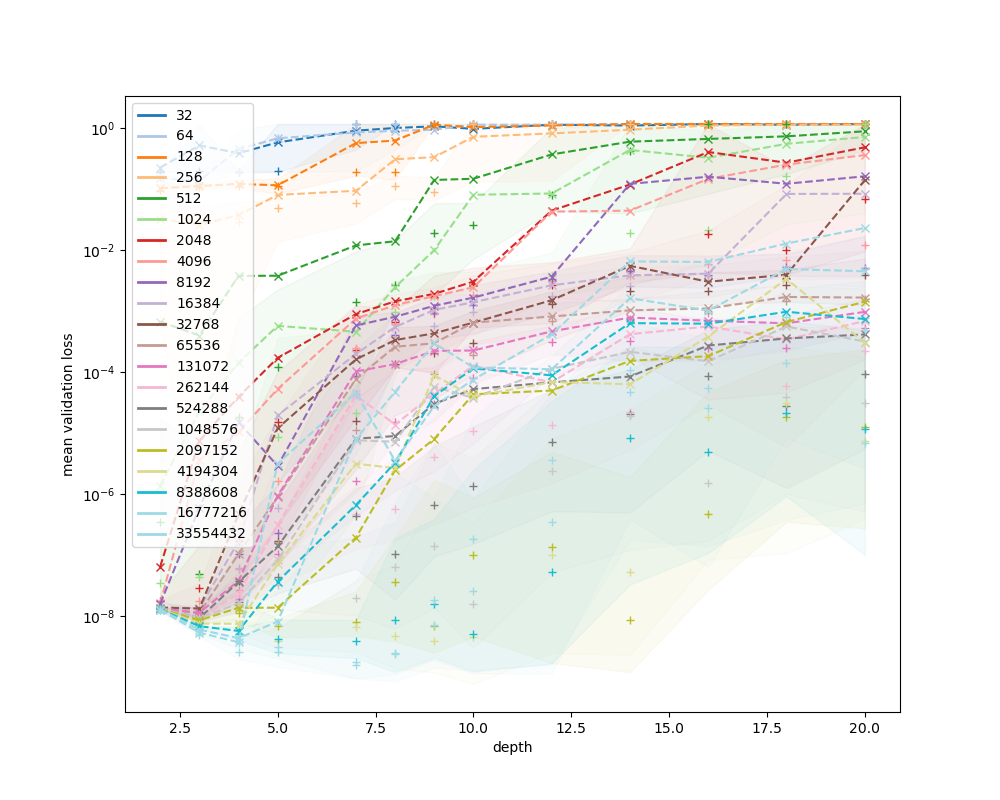

<IPython.core.display.Javascript object>


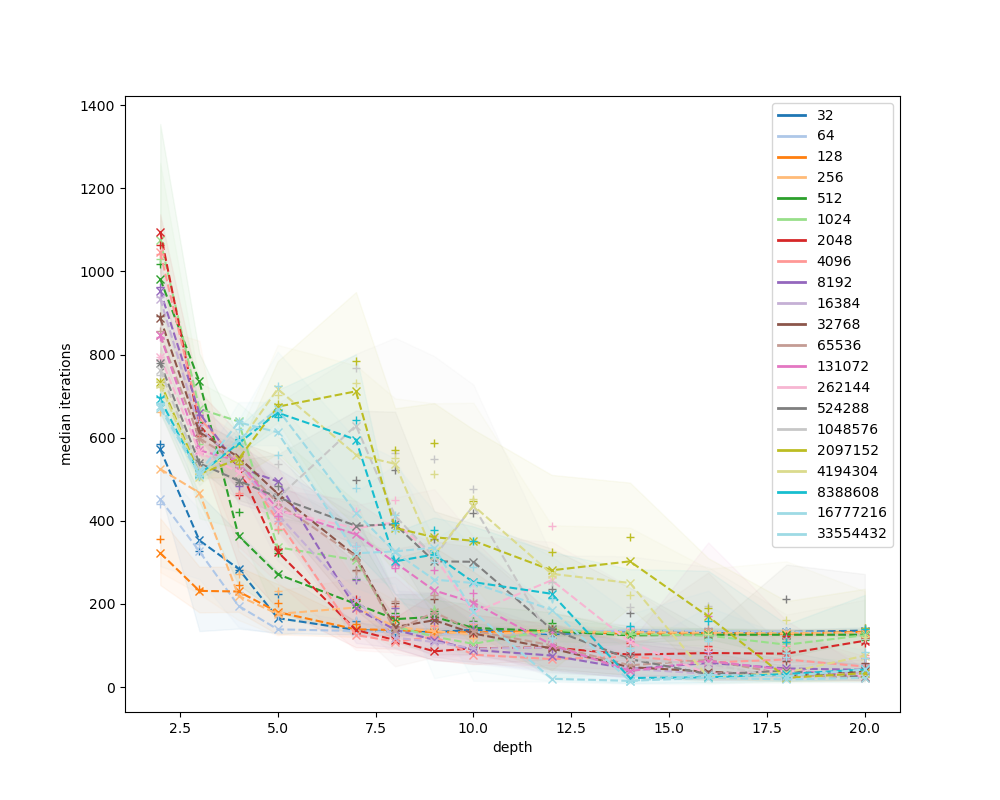

<IPython.core.display.Javascript object>

{'config.topology': 'exponential', 'config.residual_mode': 'none'}


<IPython.core.display.Javascript object>


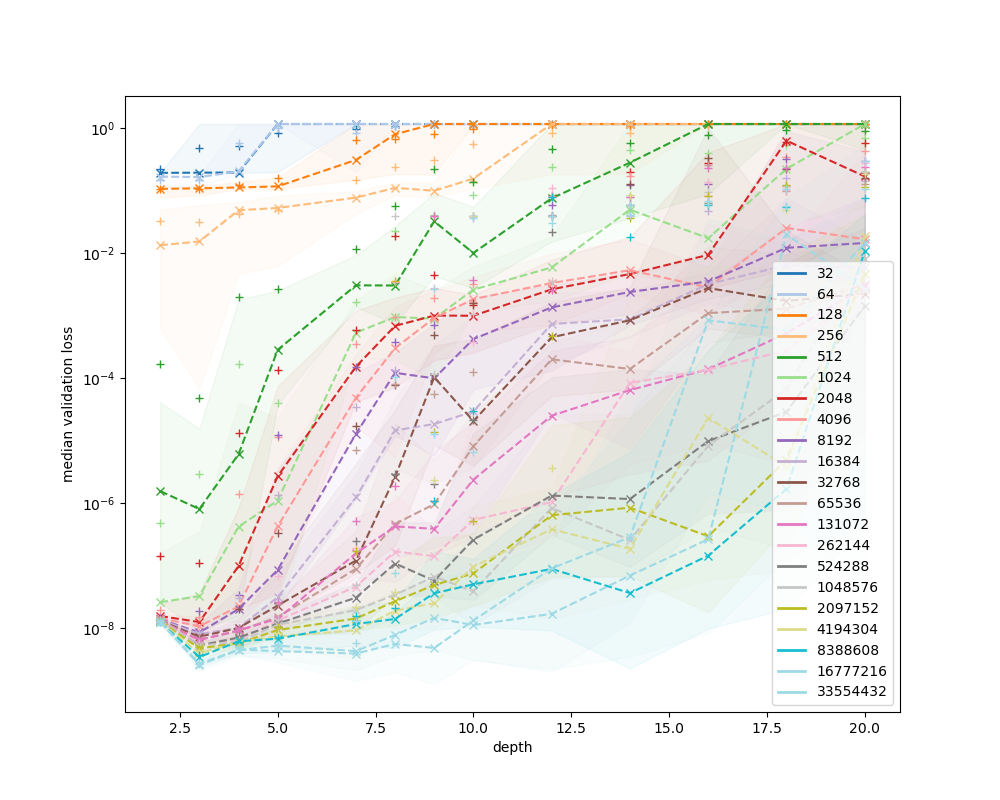

<IPython.core.display.Javascript object>


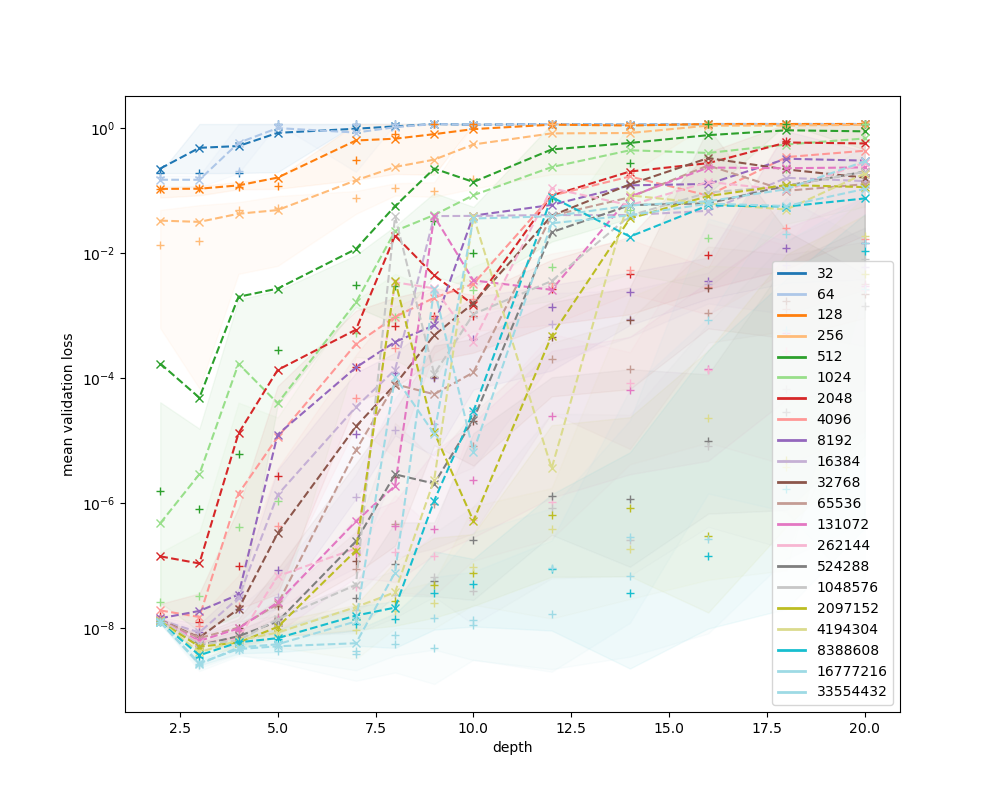

<IPython.core.display.Javascript object>


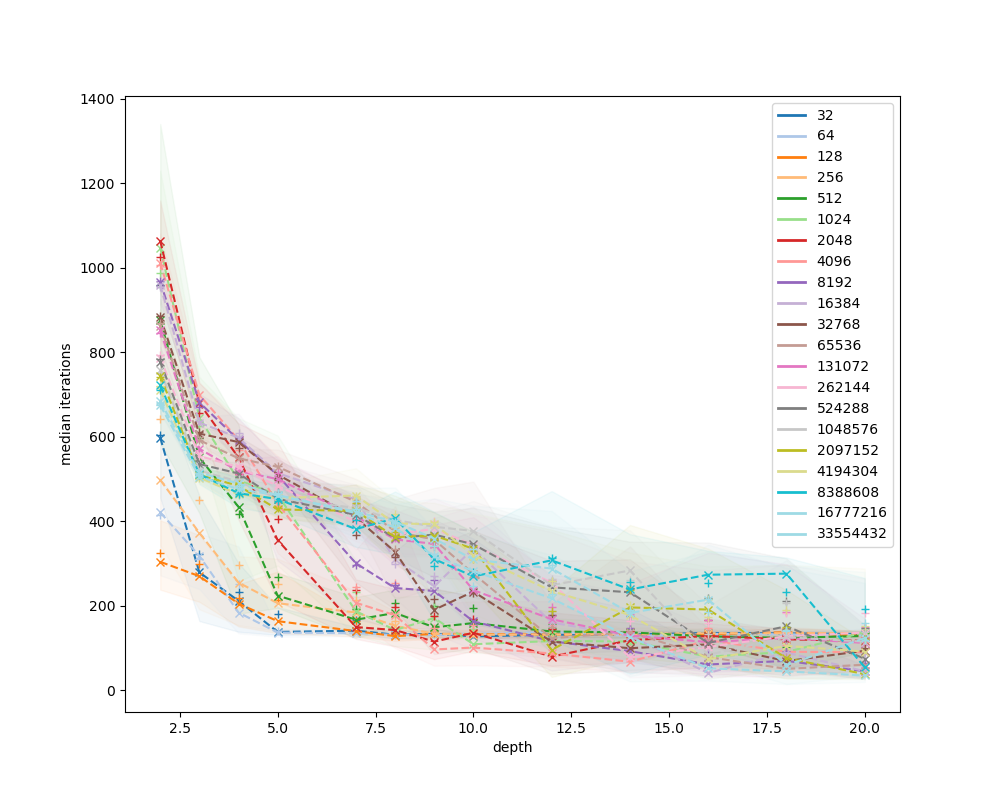

<IPython.core.display.Javascript object>


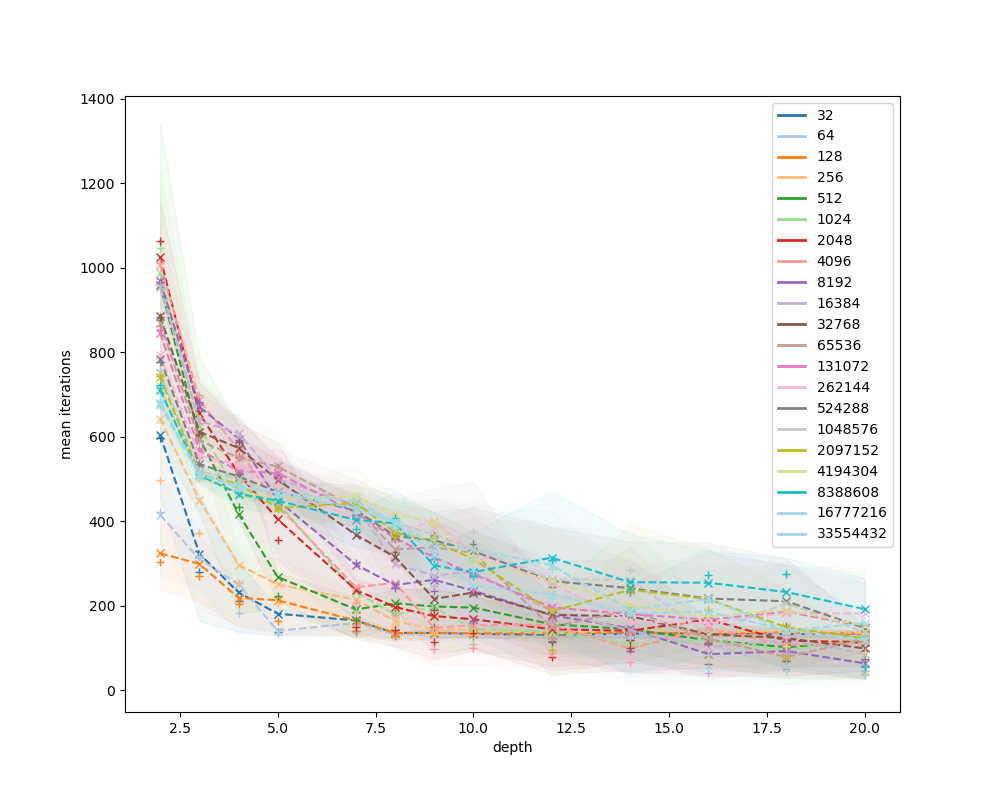

In [75]:
plot_dataset('nursery')

In [ ]:
plot_dataset('201_pol')

{'config.topology': 'rectangle', 'config.residual_mode': 'full'}


<IPython.core.display.Javascript object>


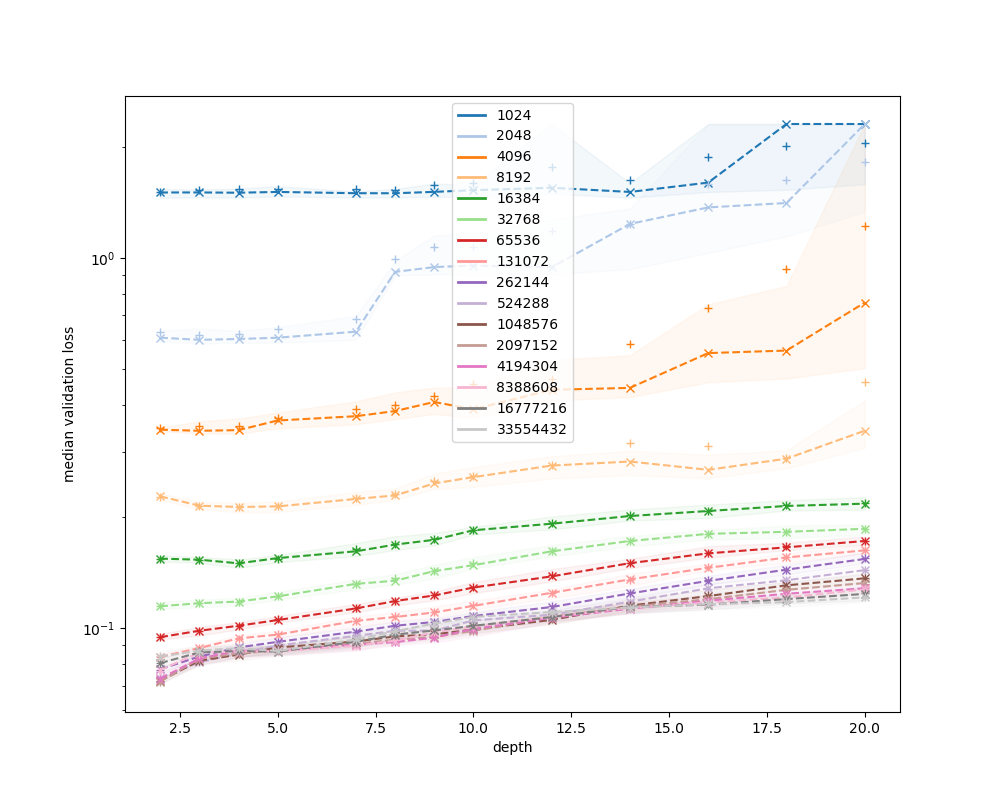

<IPython.core.display.Javascript object>


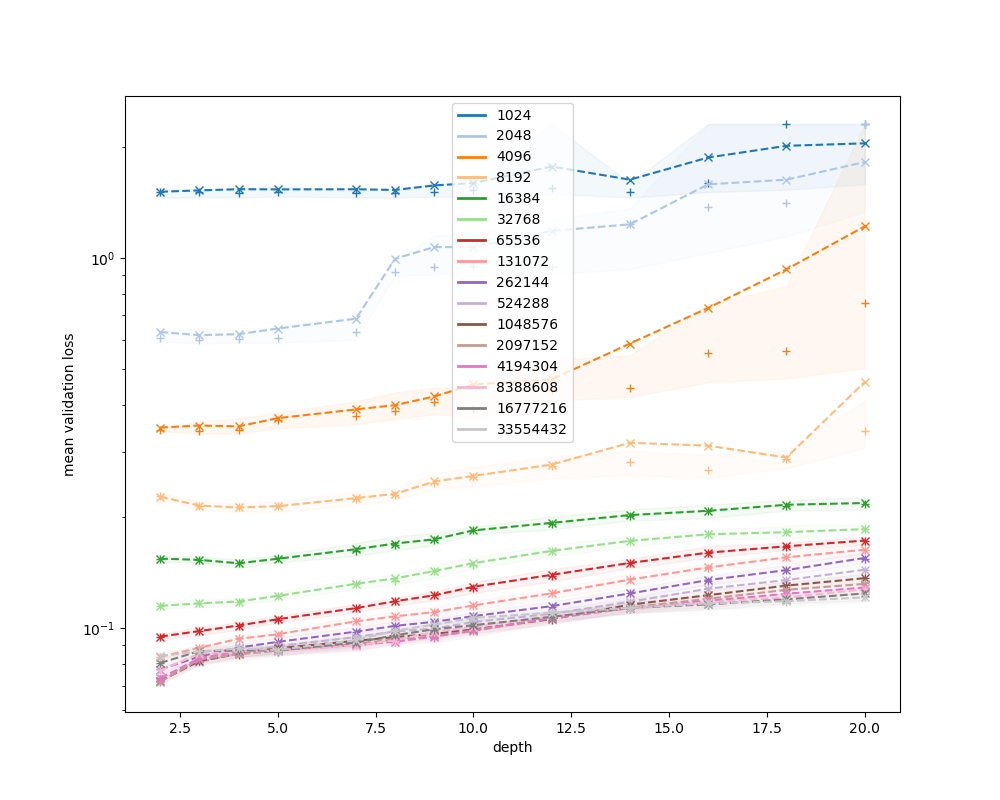

<IPython.core.display.Javascript object>


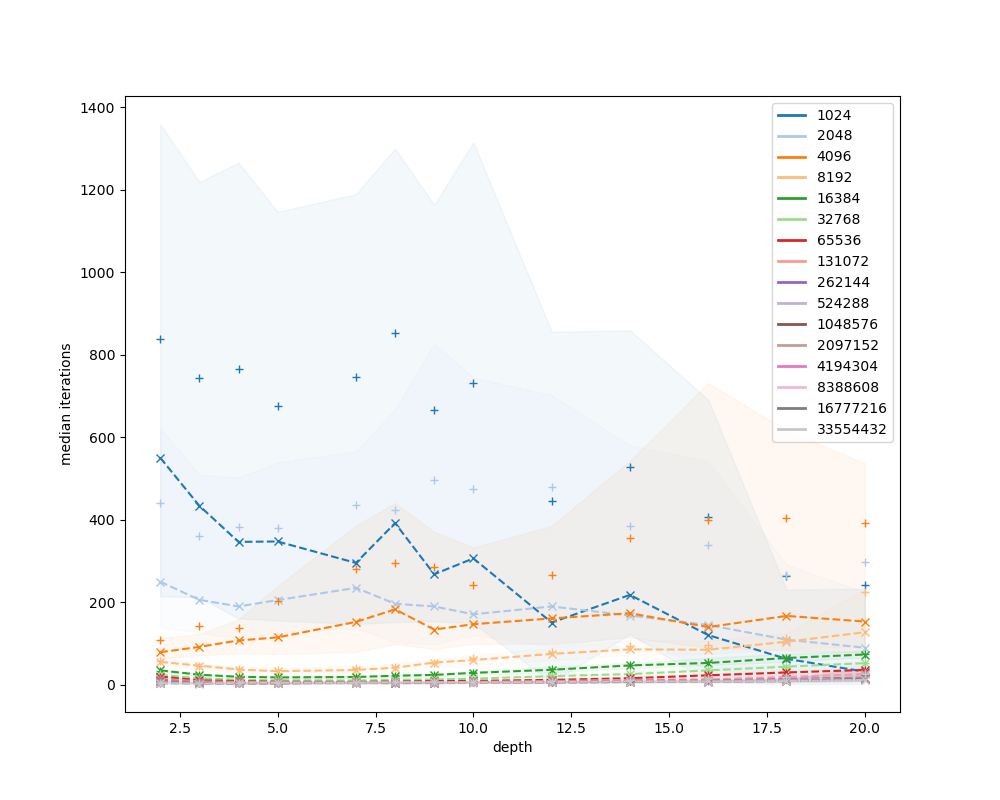

<IPython.core.display.Javascript object>


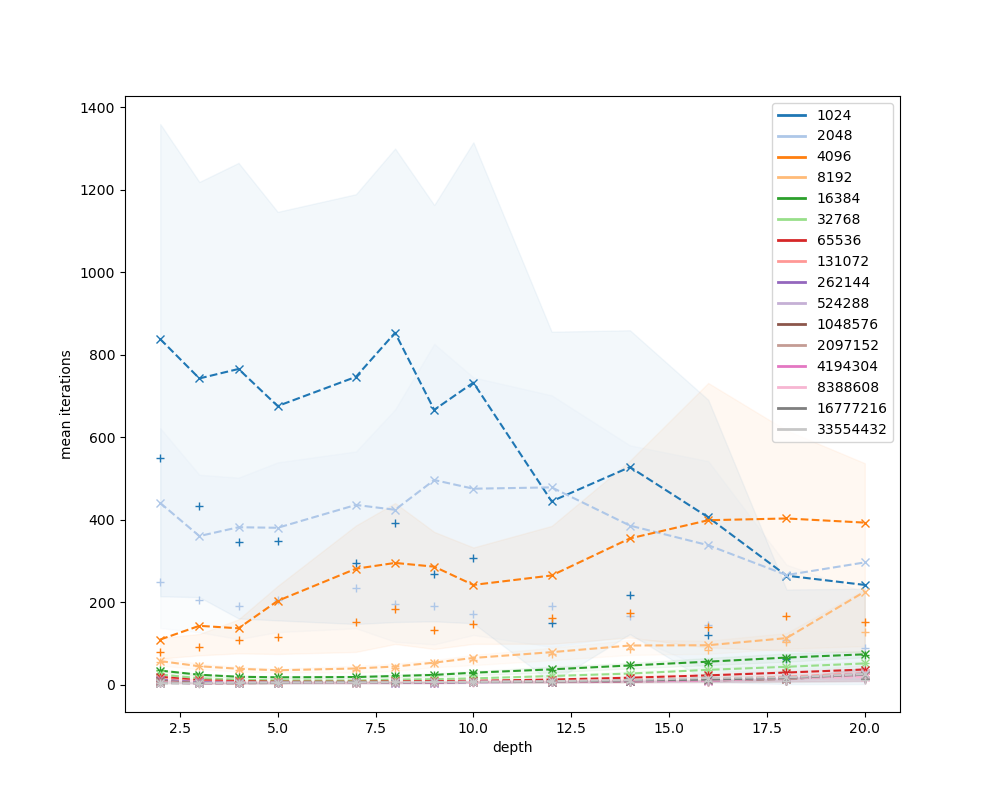

{'config.topology': 'rectangle', 'config.residual_mode': 'none'}


<IPython.core.display.Javascript object>


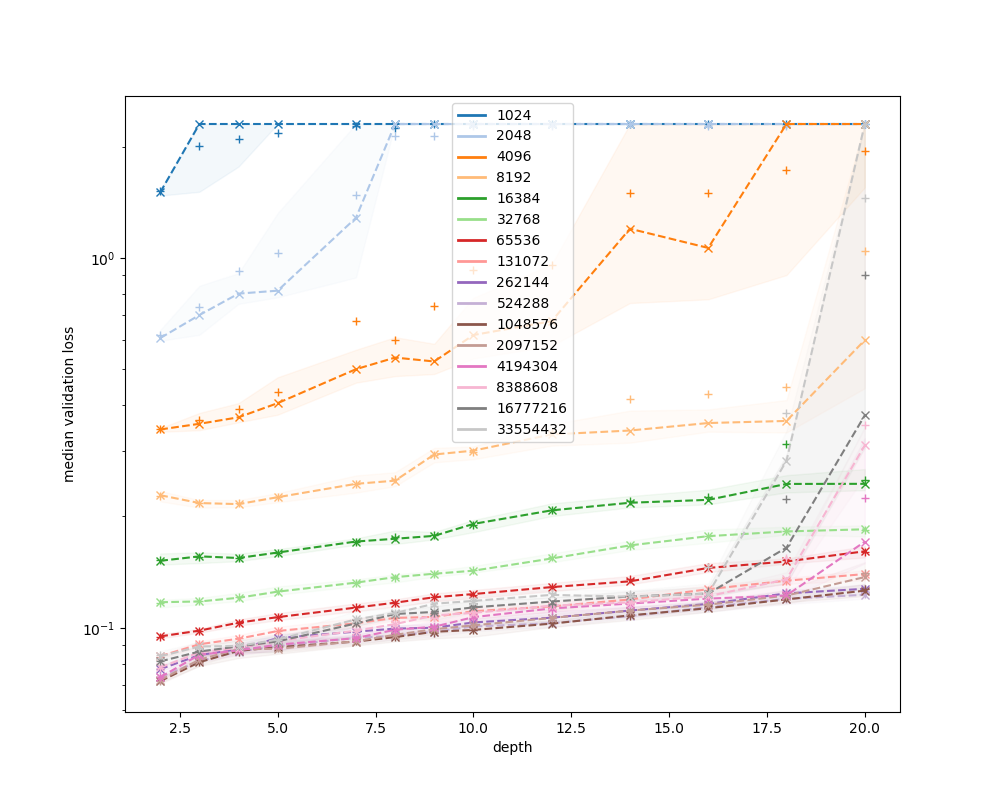

<IPython.core.display.Javascript object>


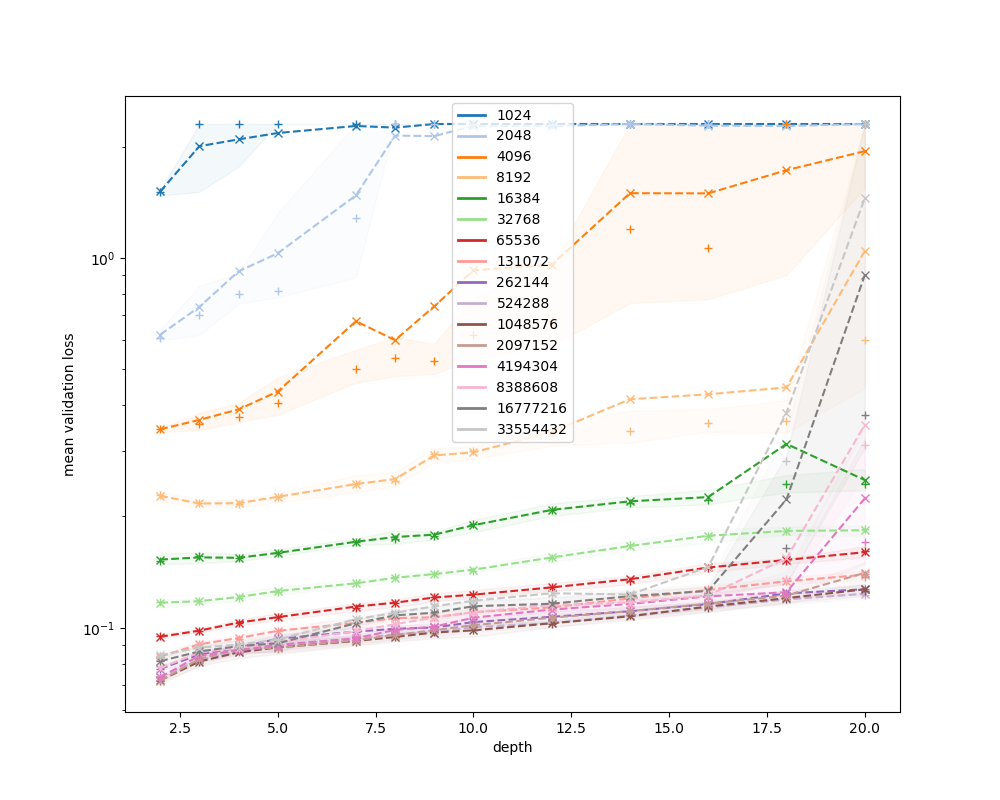

<IPython.core.display.Javascript object>


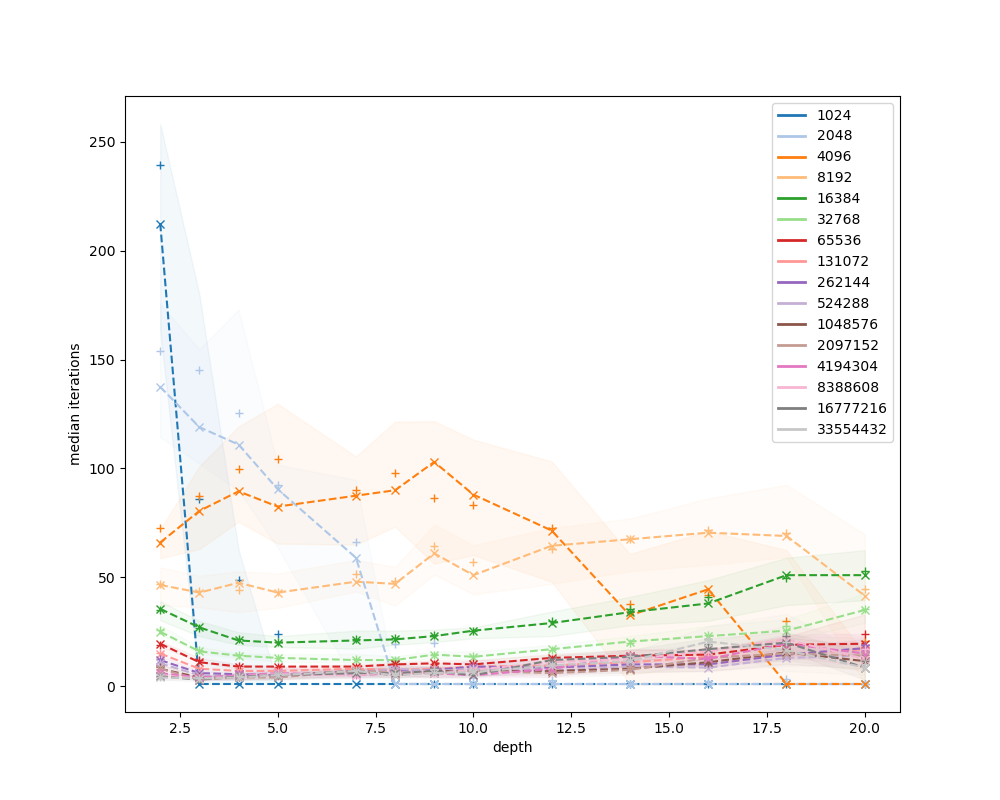

<IPython.core.display.Javascript object>


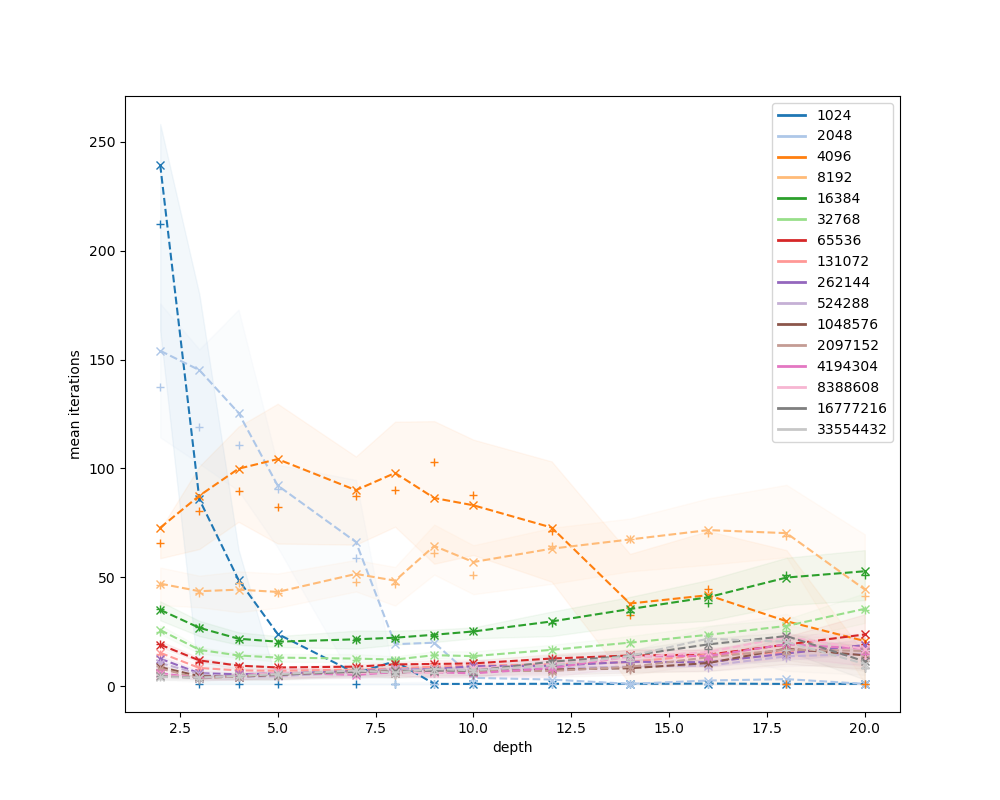

{'config.topology': 'wide_first', 'config.residual_mode': 'full'}


<IPython.core.display.Javascript object>


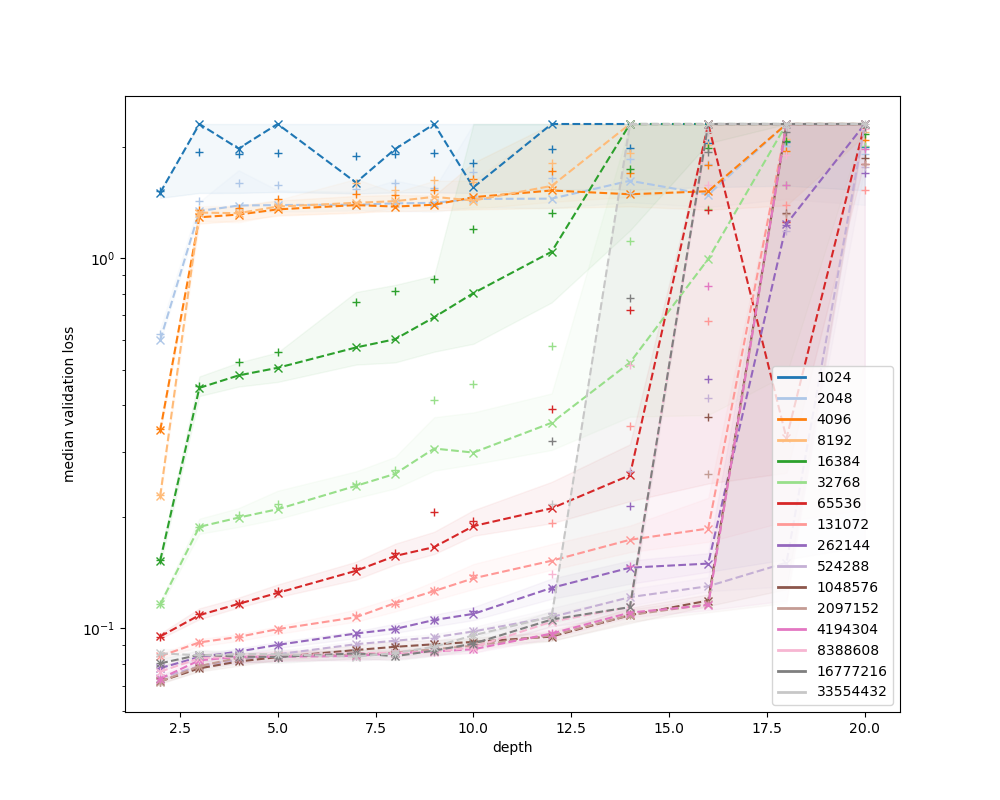

<IPython.core.display.Javascript object>


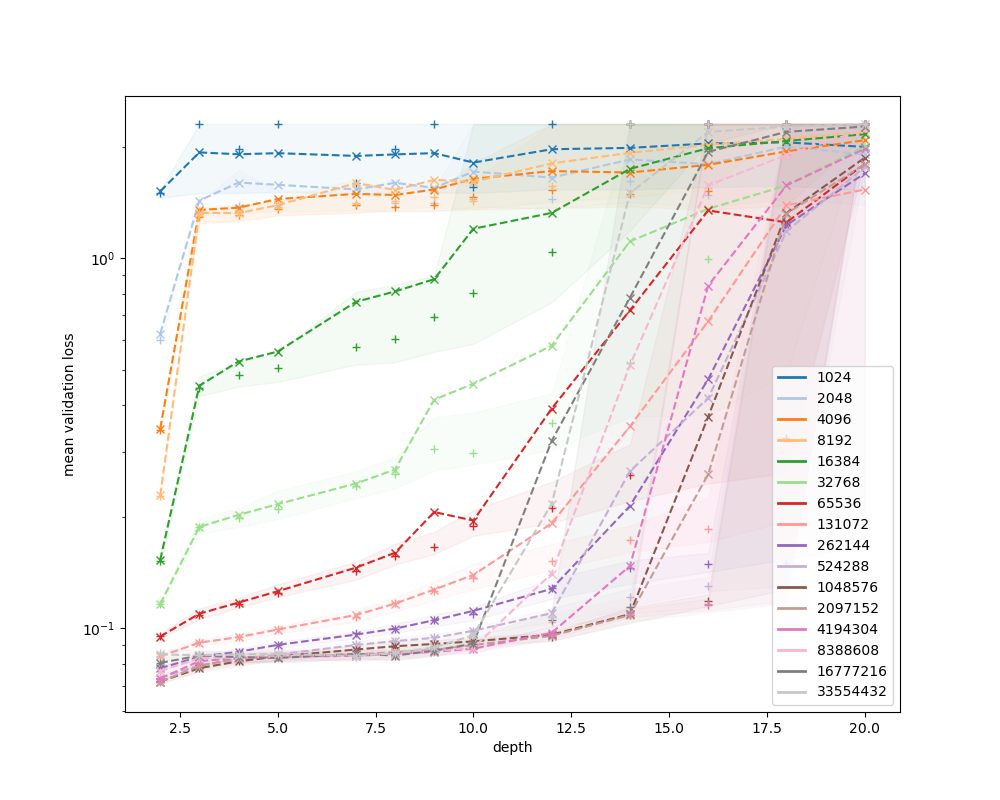

<IPython.core.display.Javascript object>


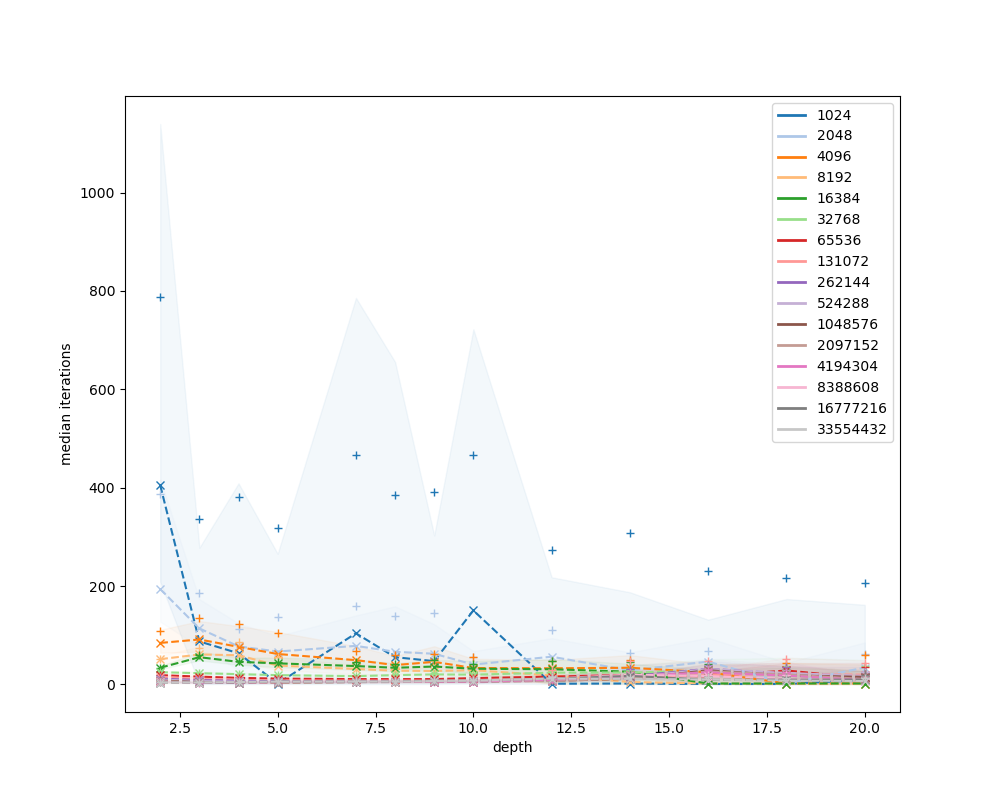

<IPython.core.display.Javascript object>


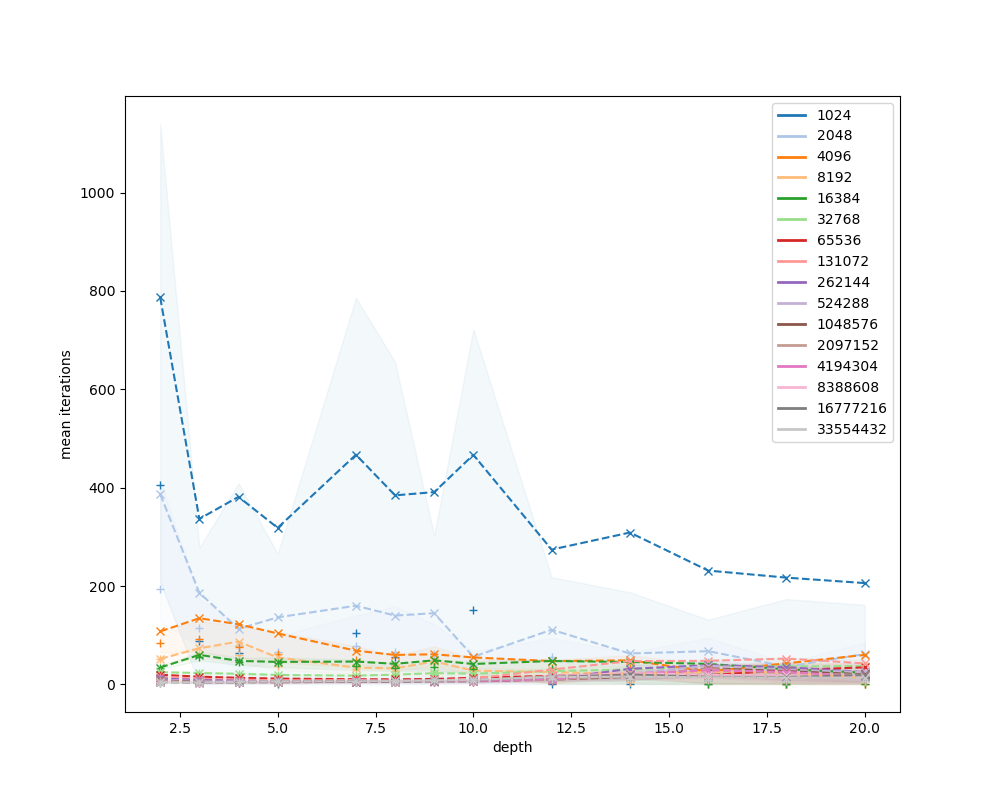

{'config.topology': 'wide_first', 'config.residual_mode': 'none'}


<IPython.core.display.Javascript object>


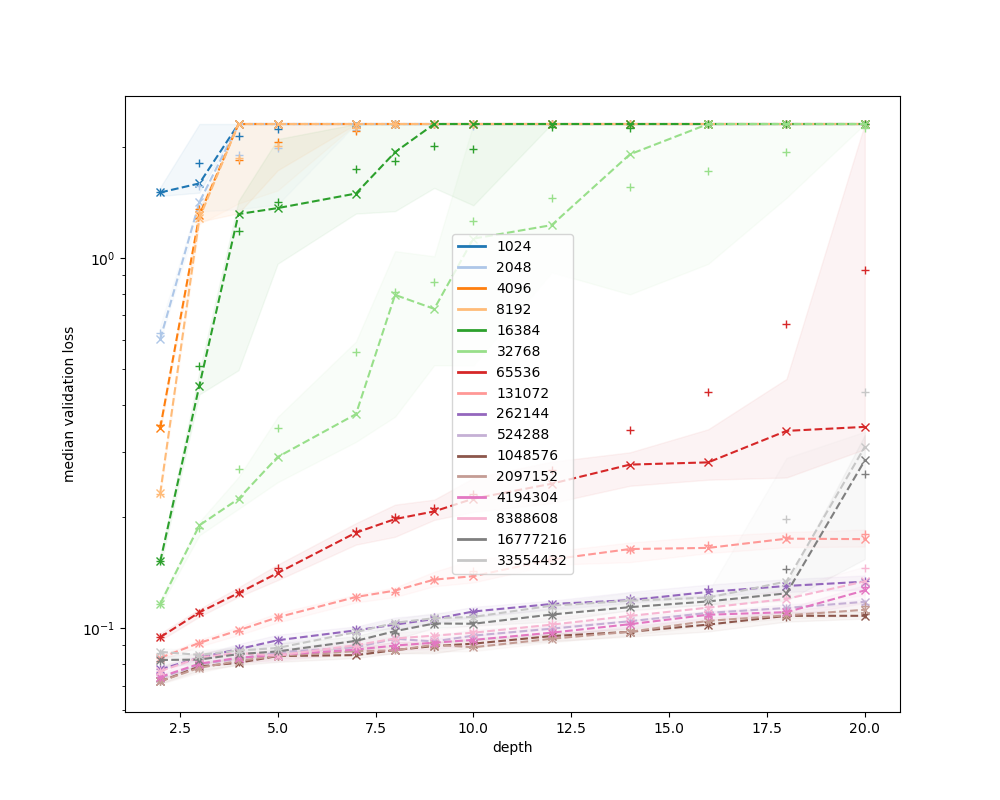

<IPython.core.display.Javascript object>


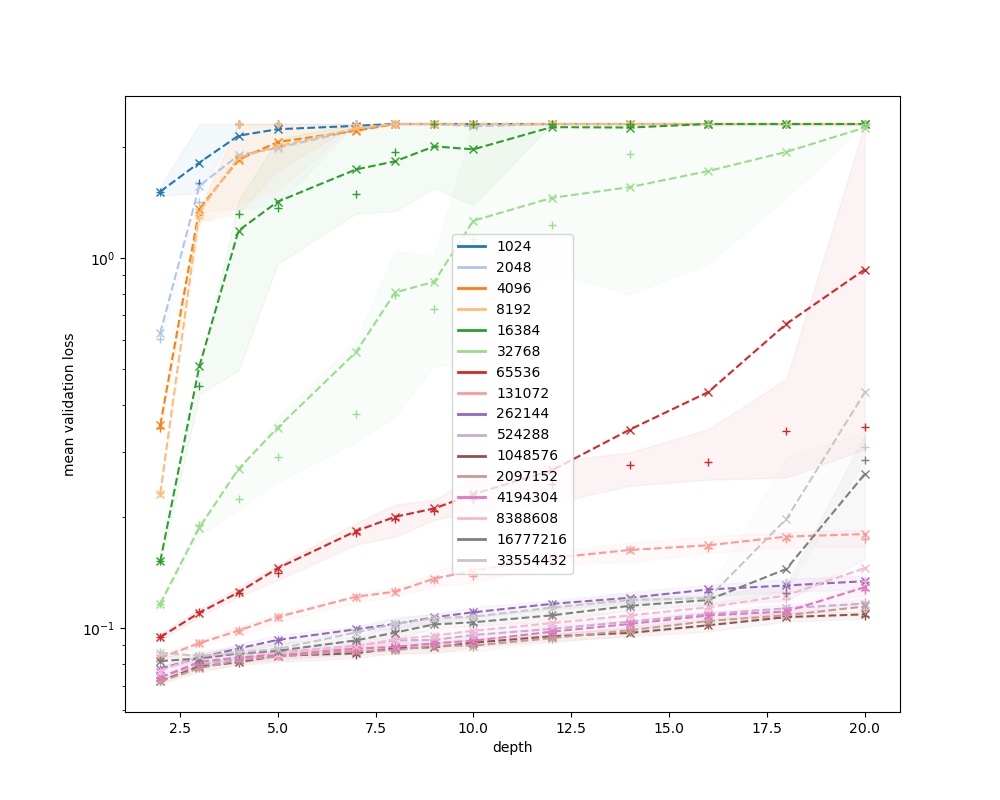

<IPython.core.display.Javascript object>


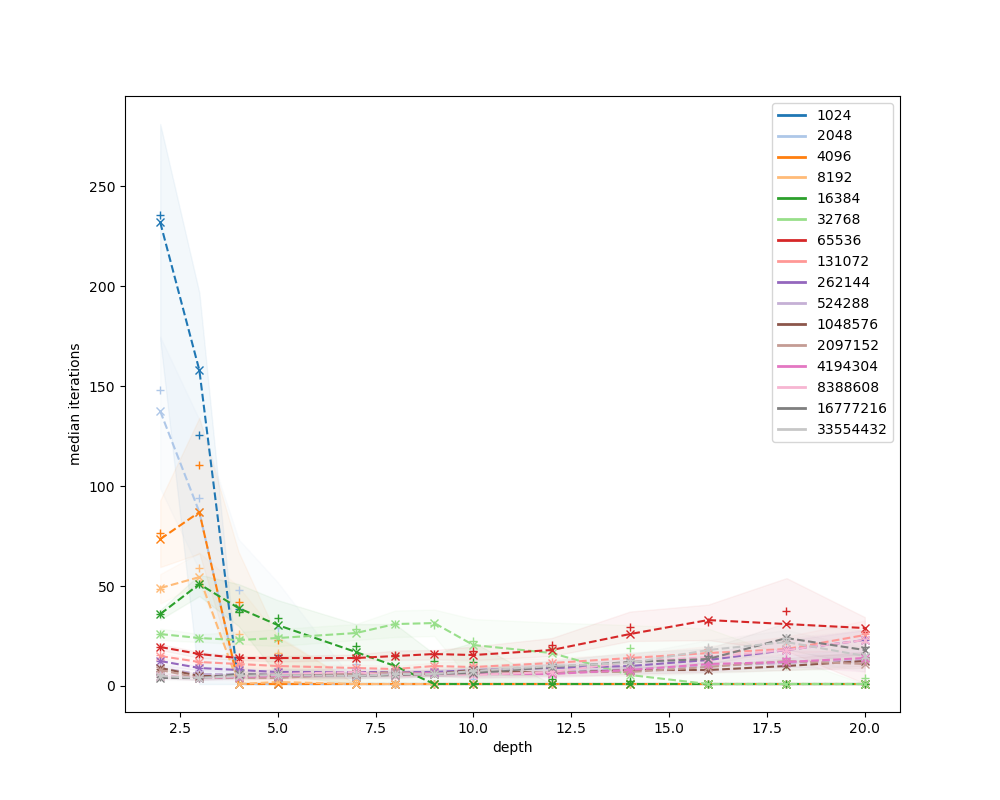

<IPython.core.display.Javascript object>


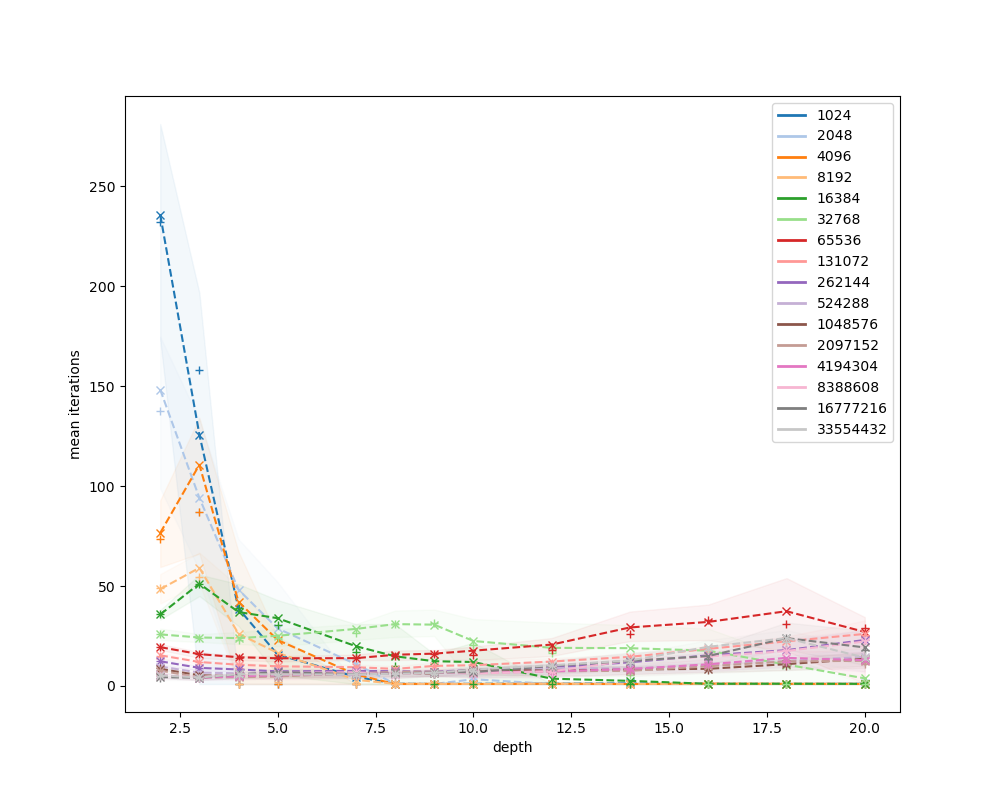

{'config.topology': 'trapezoid', 'config.residual_mode': 'none'}


<IPython.core.display.Javascript object>


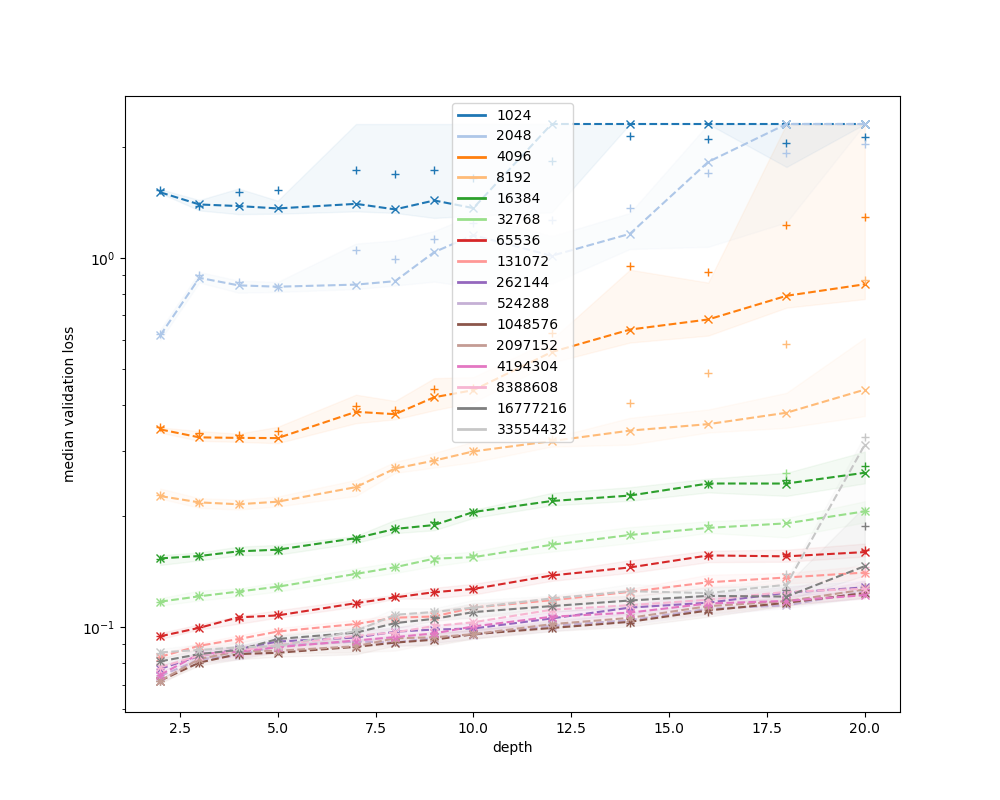

<IPython.core.display.Javascript object>


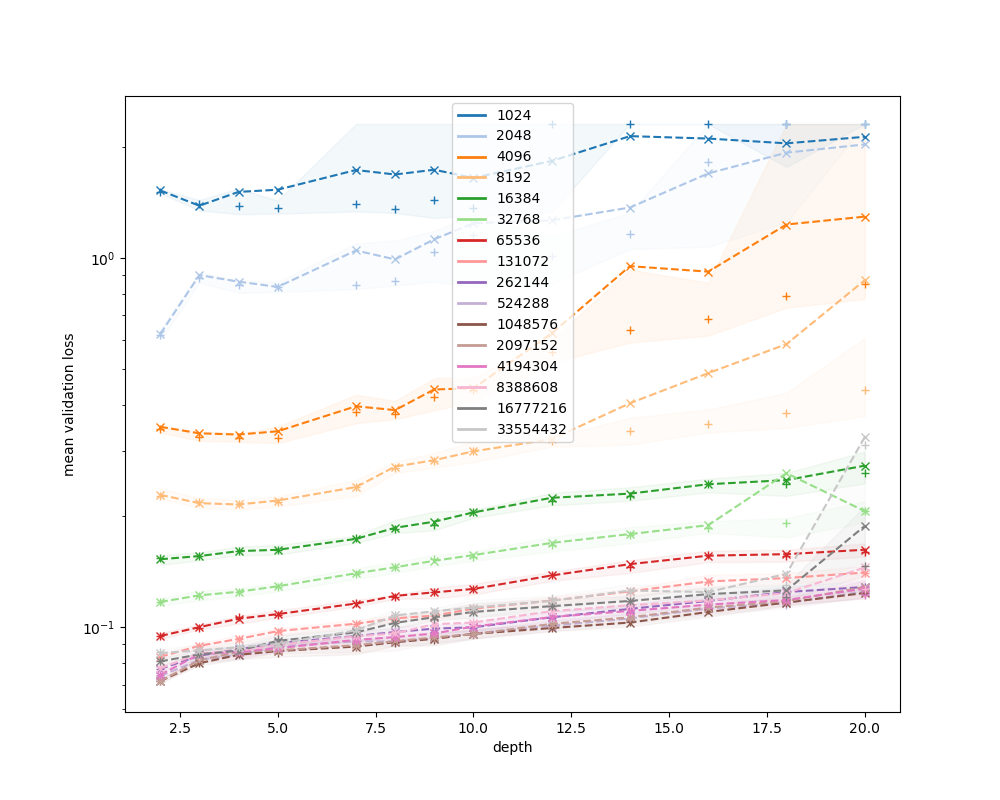

<IPython.core.display.Javascript object>


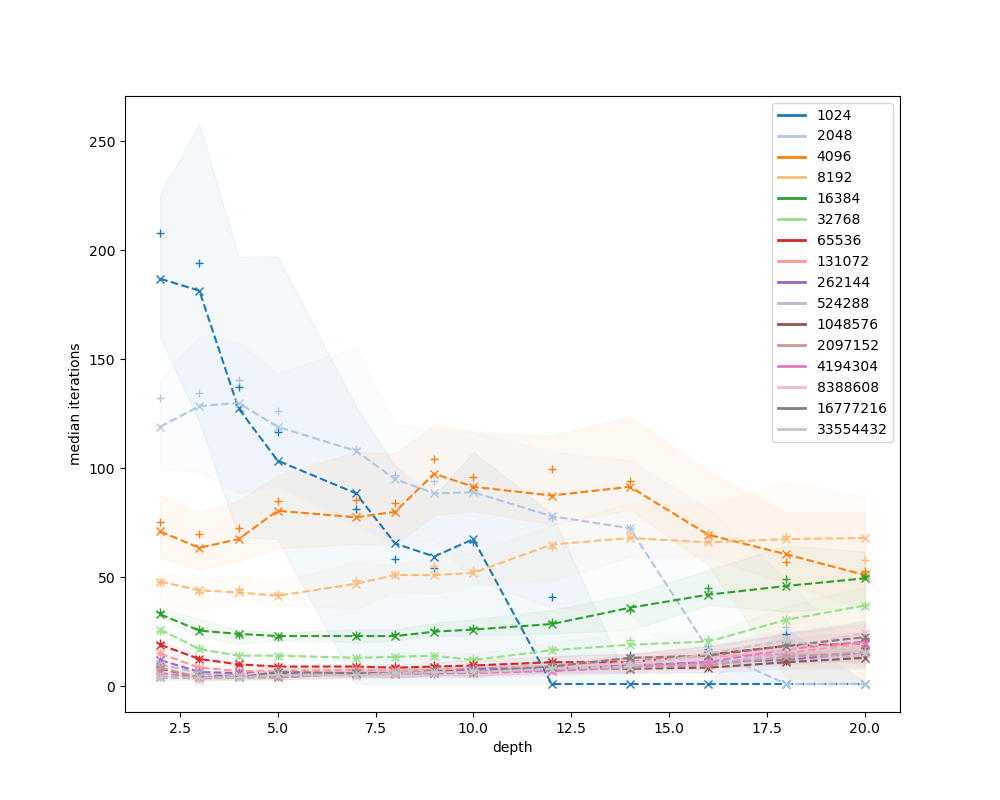

<IPython.core.display.Javascript object>


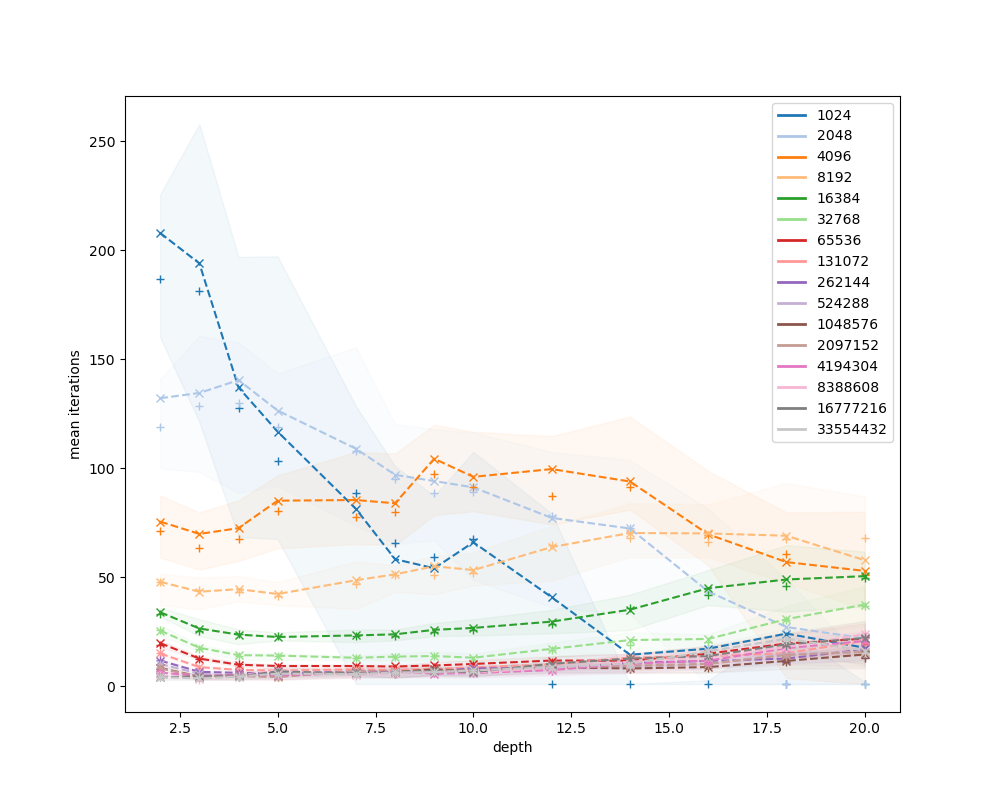

{'config.topology': 'exponential', 'config.residual_mode': 'none'}


<IPython.core.display.Javascript object>


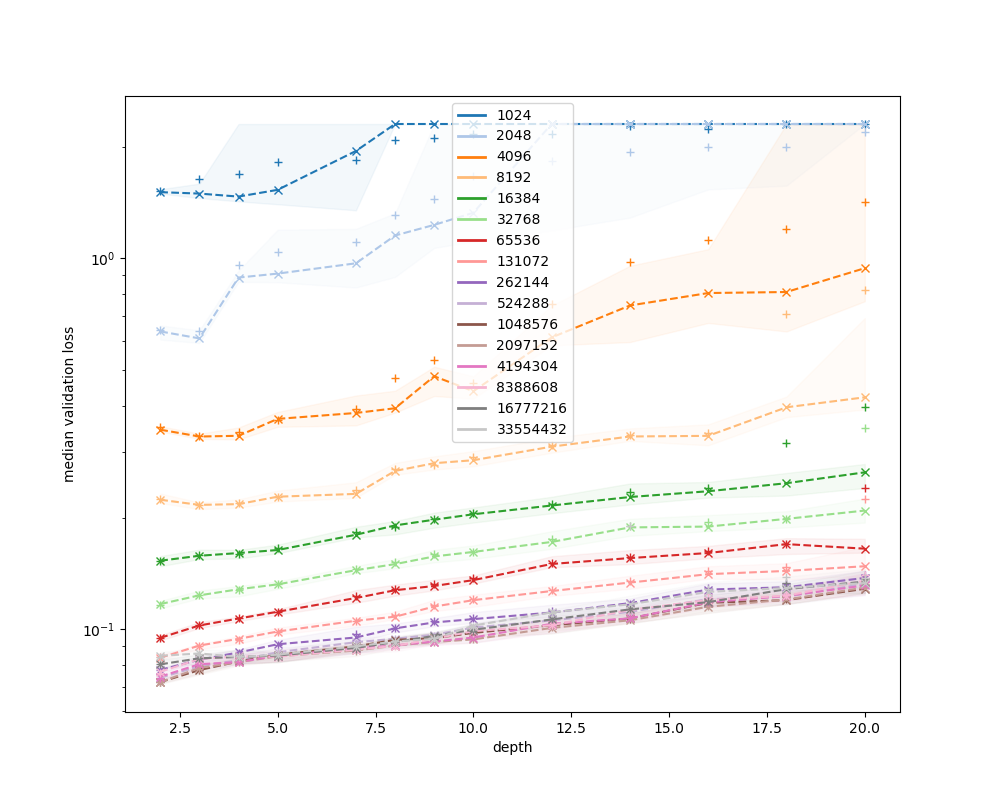

<IPython.core.display.Javascript object>


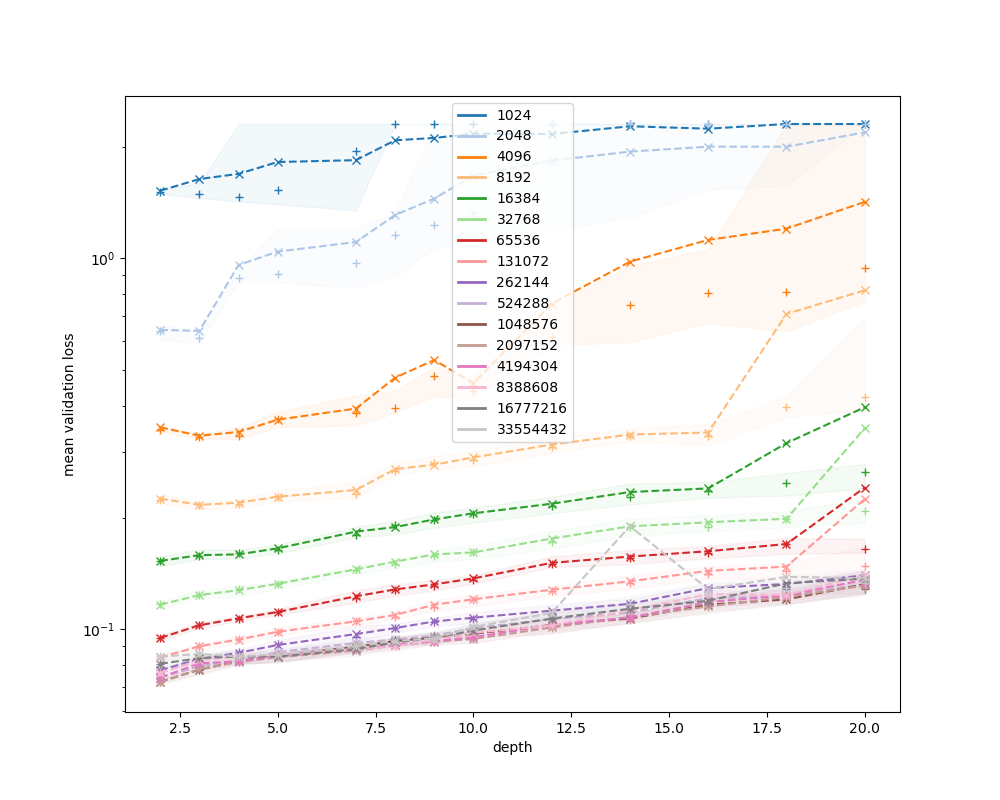

<IPython.core.display.Javascript object>


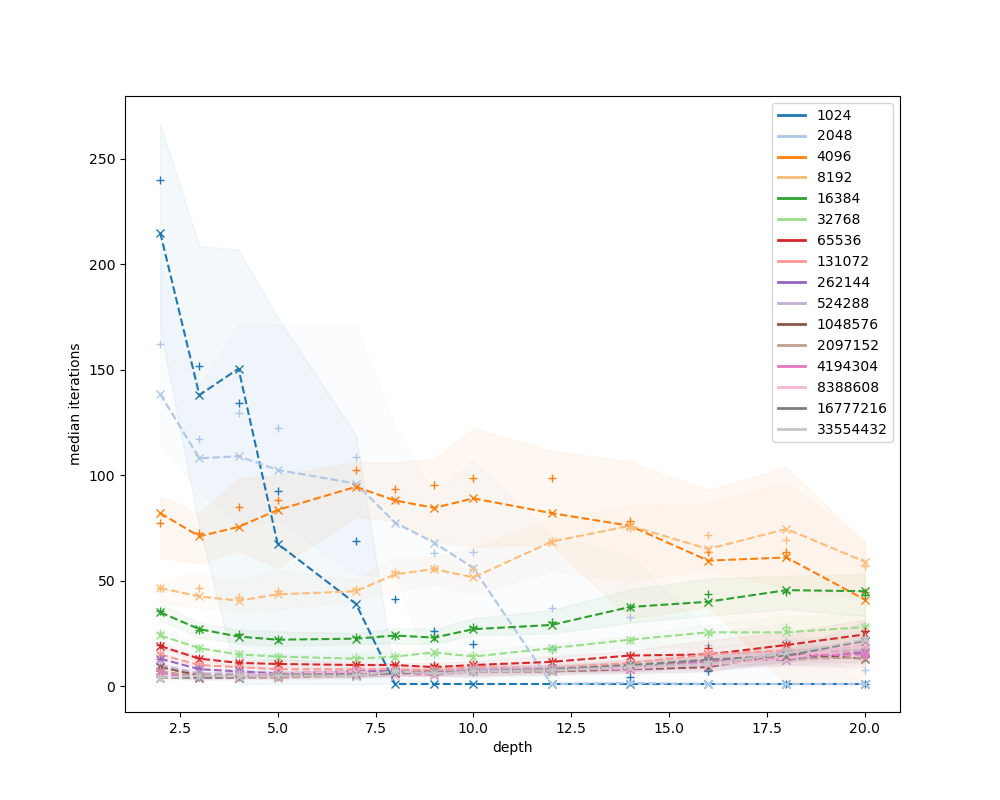

<IPython.core.display.Javascript object>


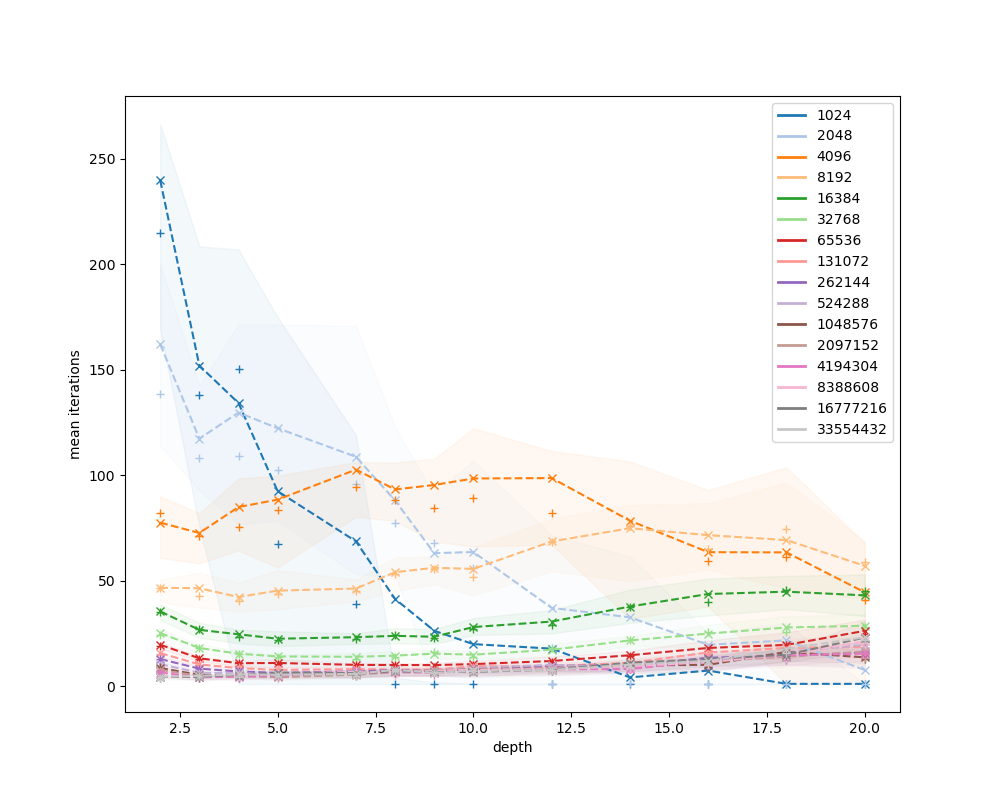

In [74]:
plot_dataset('mnist')

In [ ]:
plot_dataset('connect_4')

{'config.topology': 'rectangle', 'config.residual_mode': 'none'}


<IPython.core.display.Javascript object>


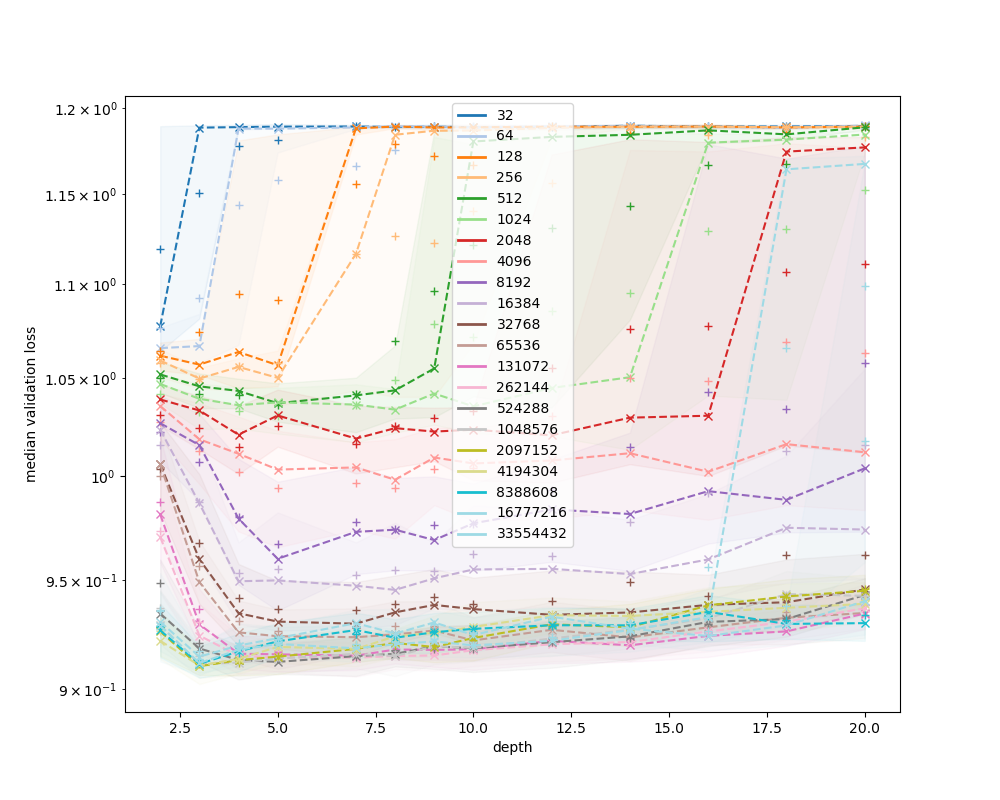

<IPython.core.display.Javascript object>


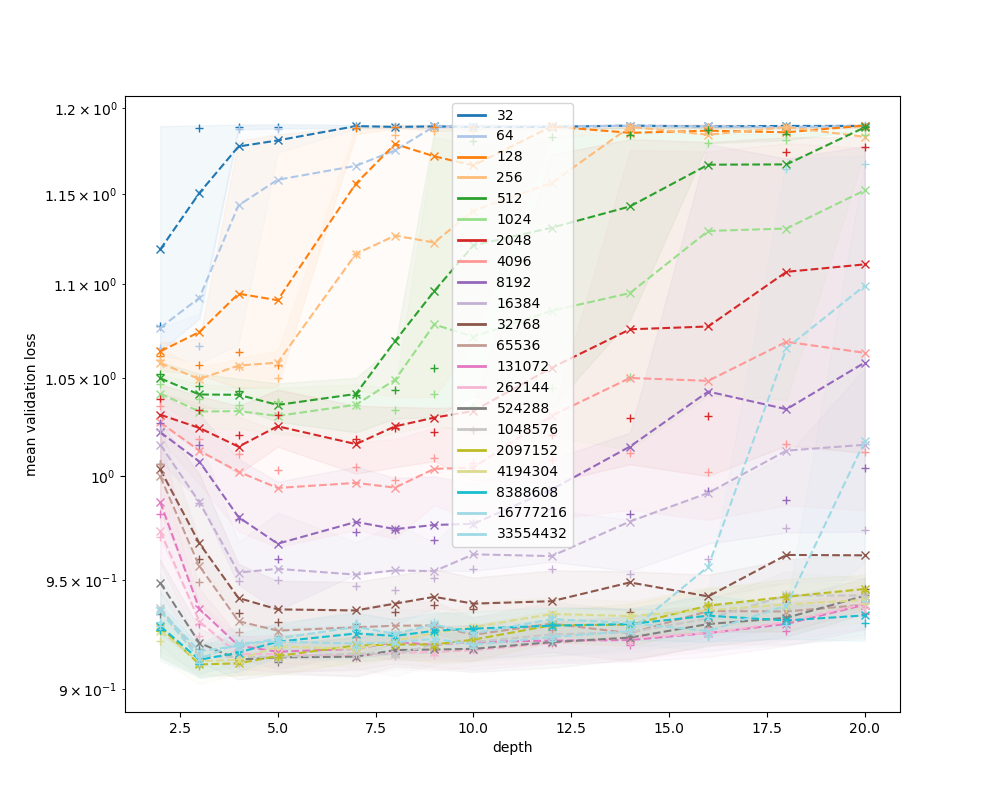

<IPython.core.display.Javascript object>


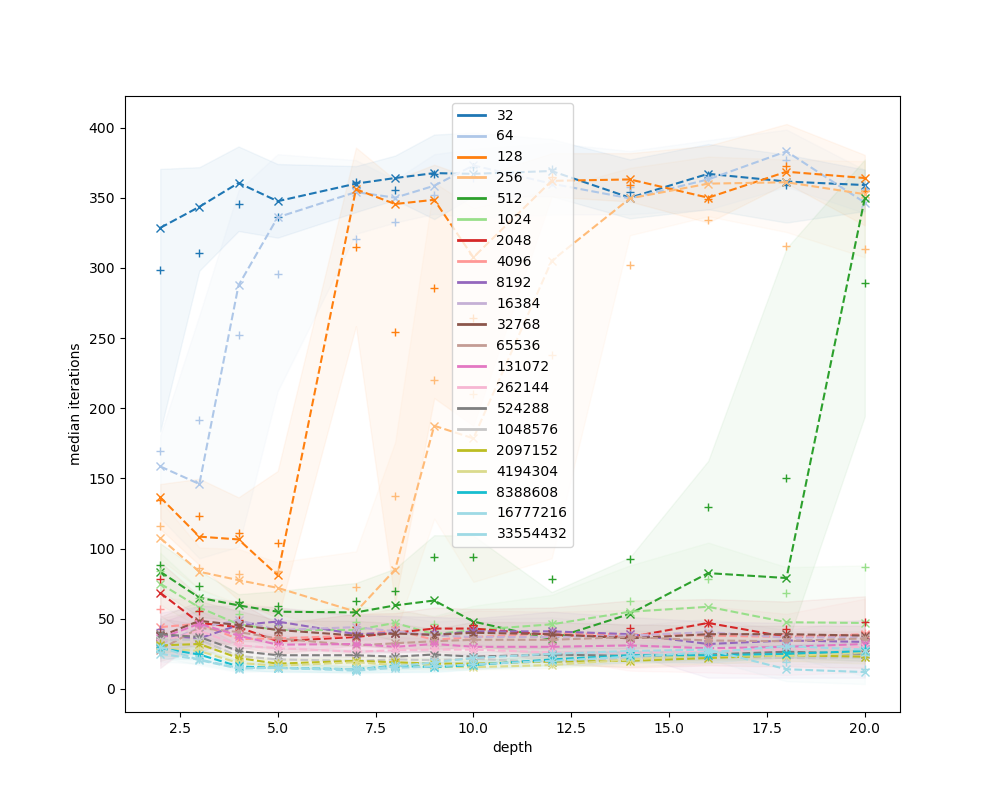

<IPython.core.display.Javascript object>


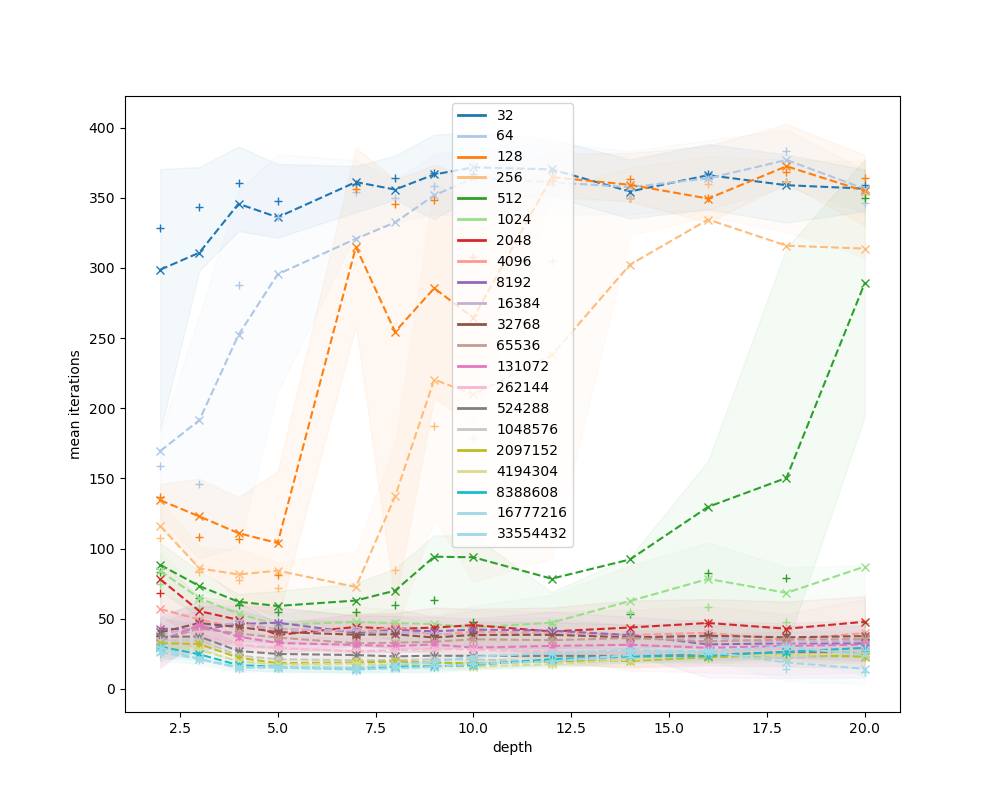

{'config.topology': 'rectangle', 'config.residual_mode': 'full'}


<IPython.core.display.Javascript object>


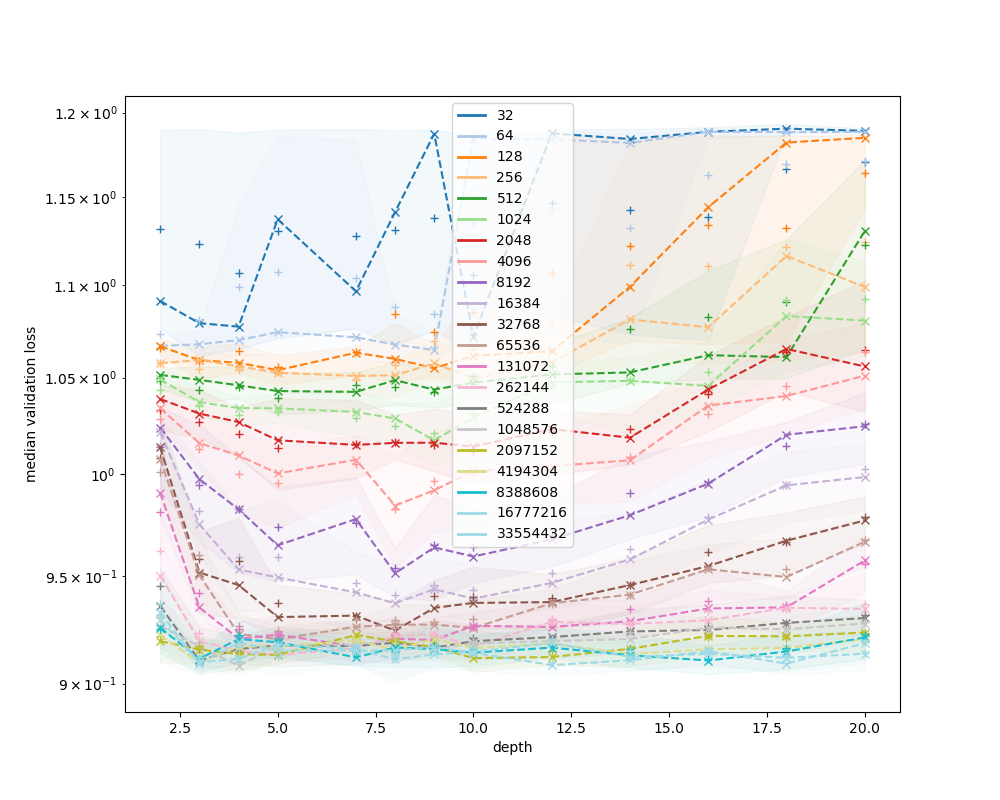

<IPython.core.display.Javascript object>


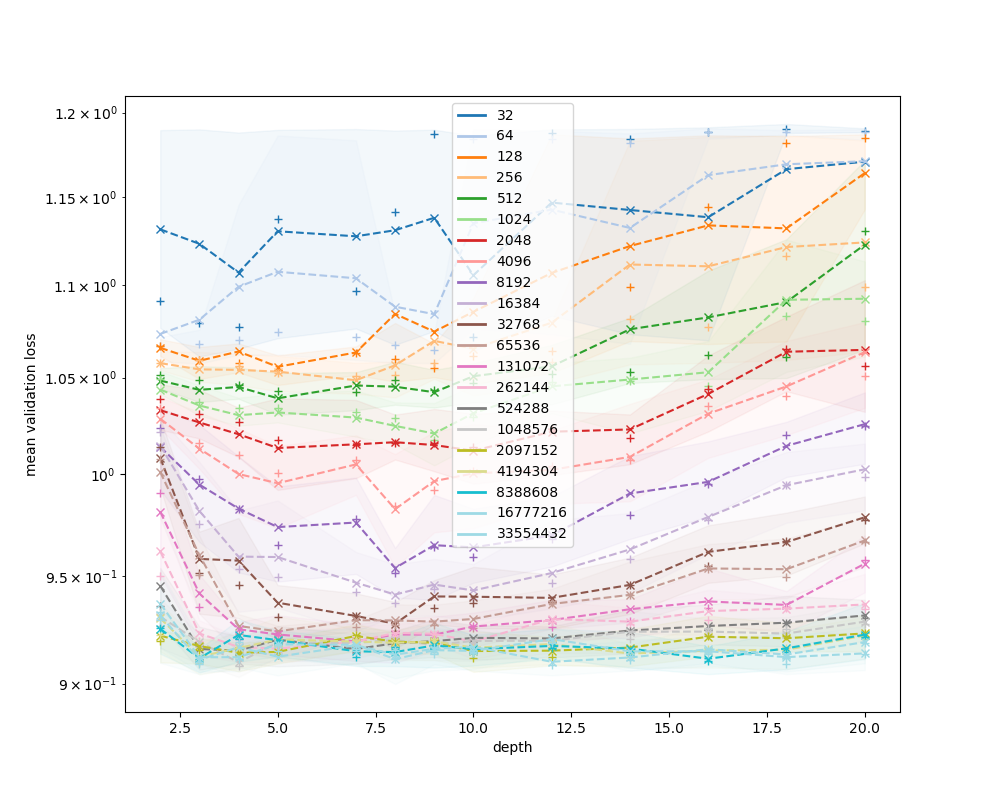

<IPython.core.display.Javascript object>


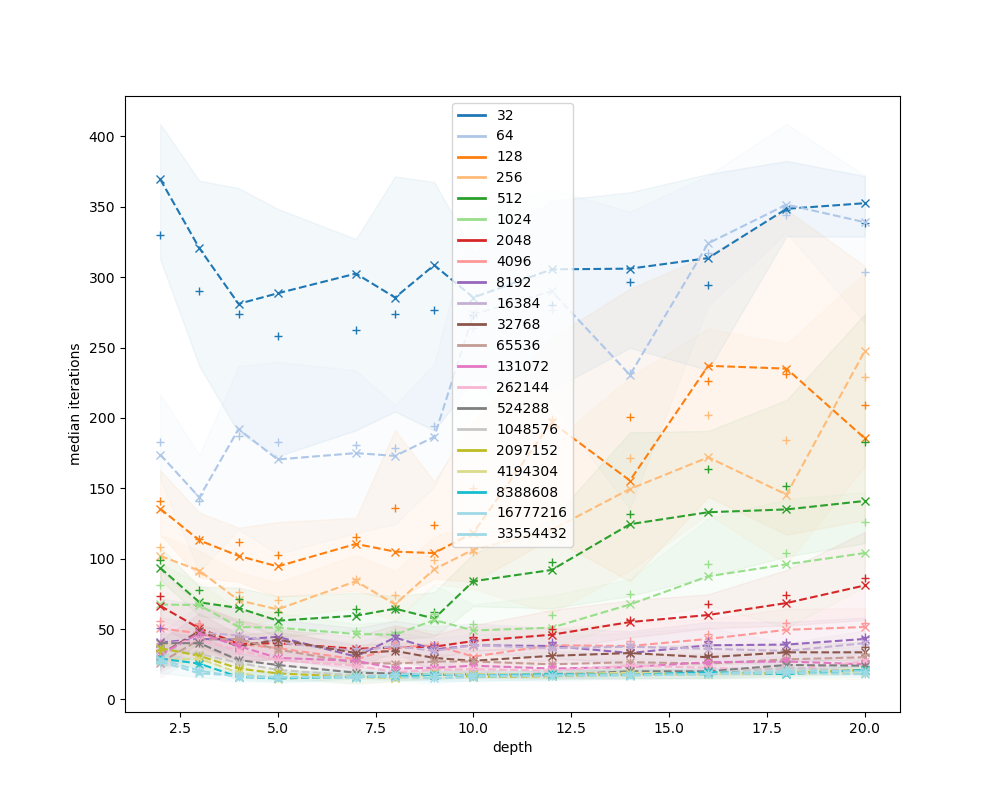

<IPython.core.display.Javascript object>


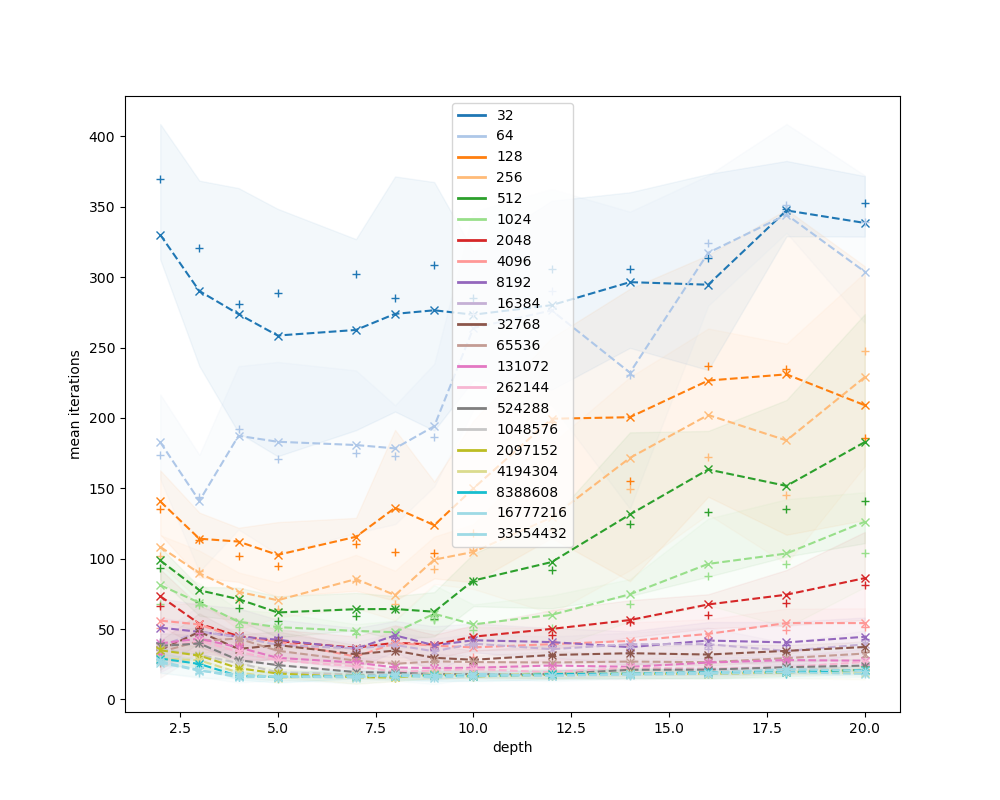

{'config.topology': 'trapezoid', 'config.residual_mode': 'none'}


<IPython.core.display.Javascript object>


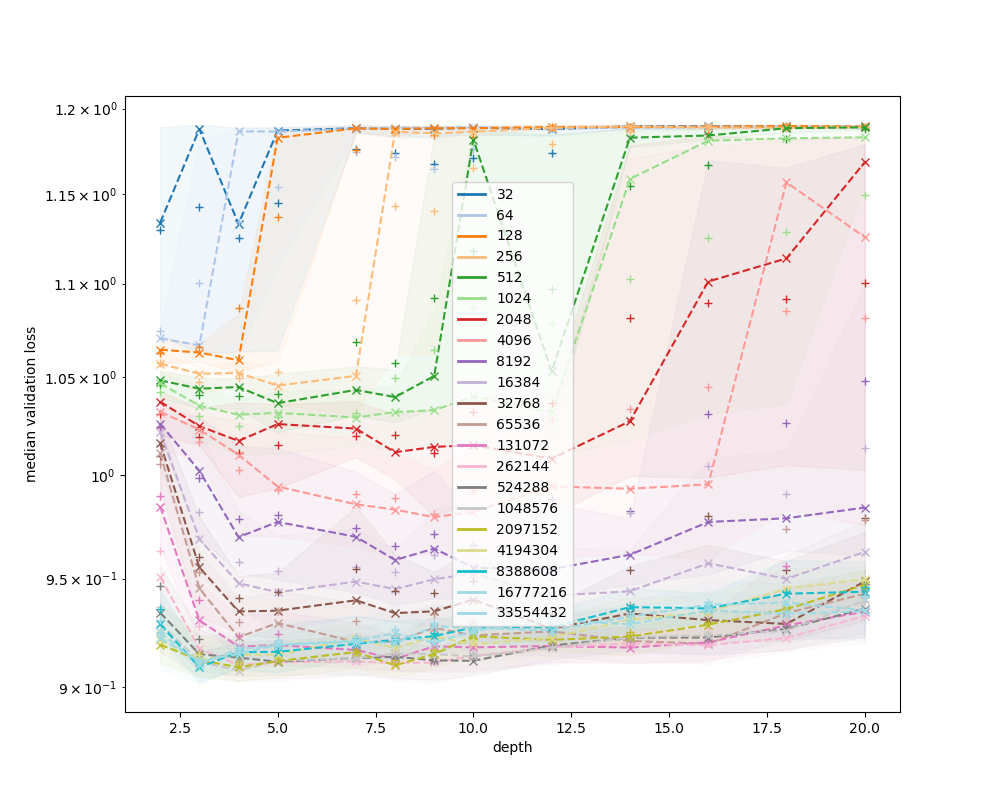

<IPython.core.display.Javascript object>


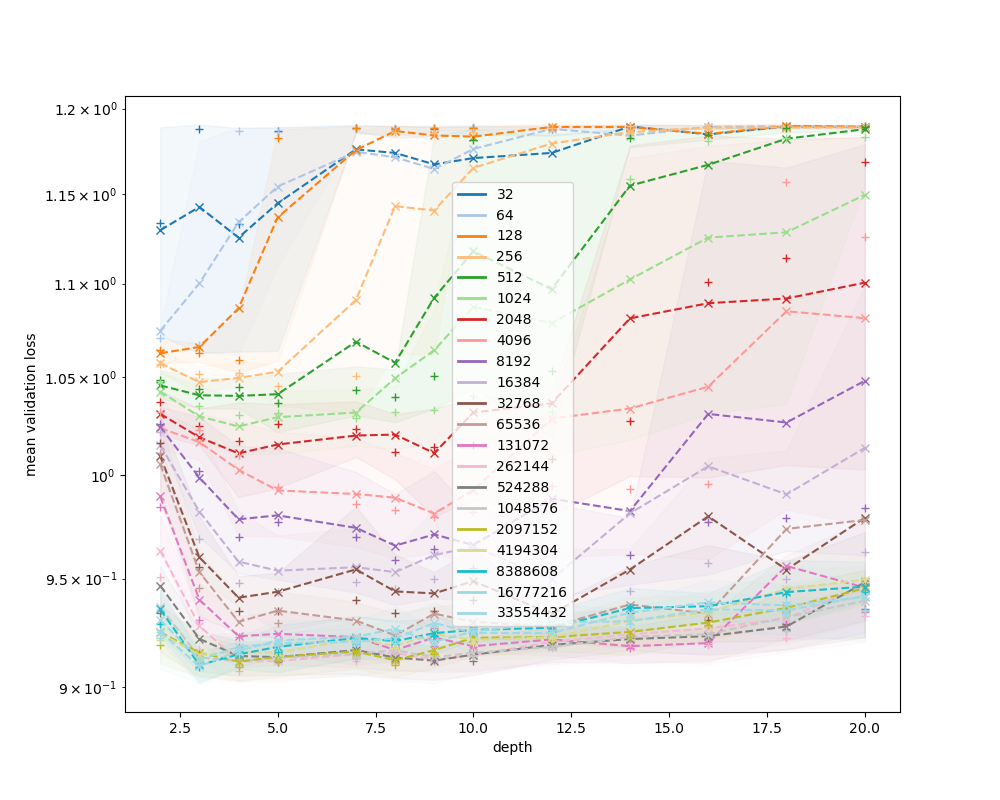

<IPython.core.display.Javascript object>


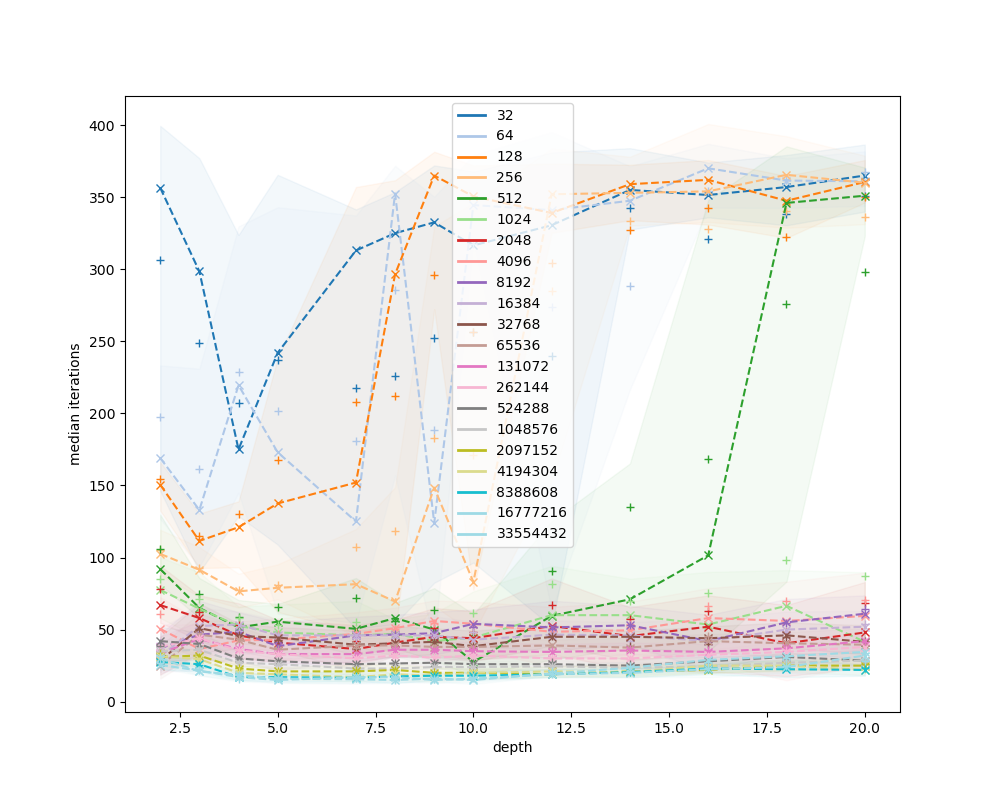

<IPython.core.display.Javascript object>


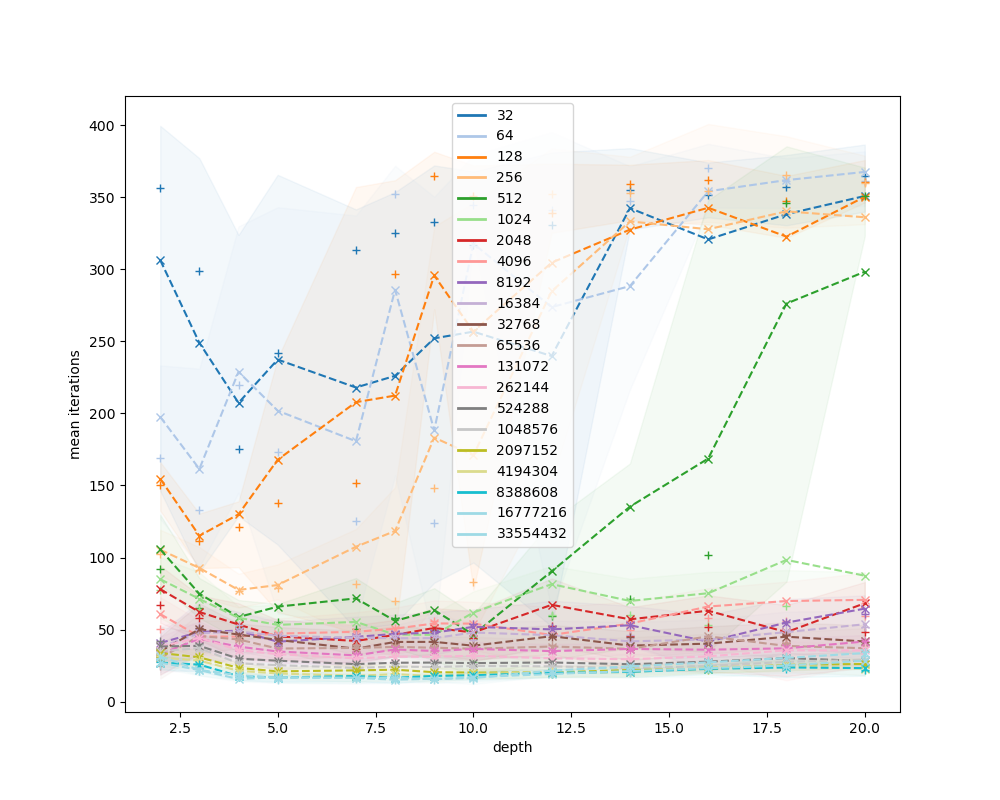

{'config.topology': 'exponential', 'config.residual_mode': 'none'}


<IPython.core.display.Javascript object>


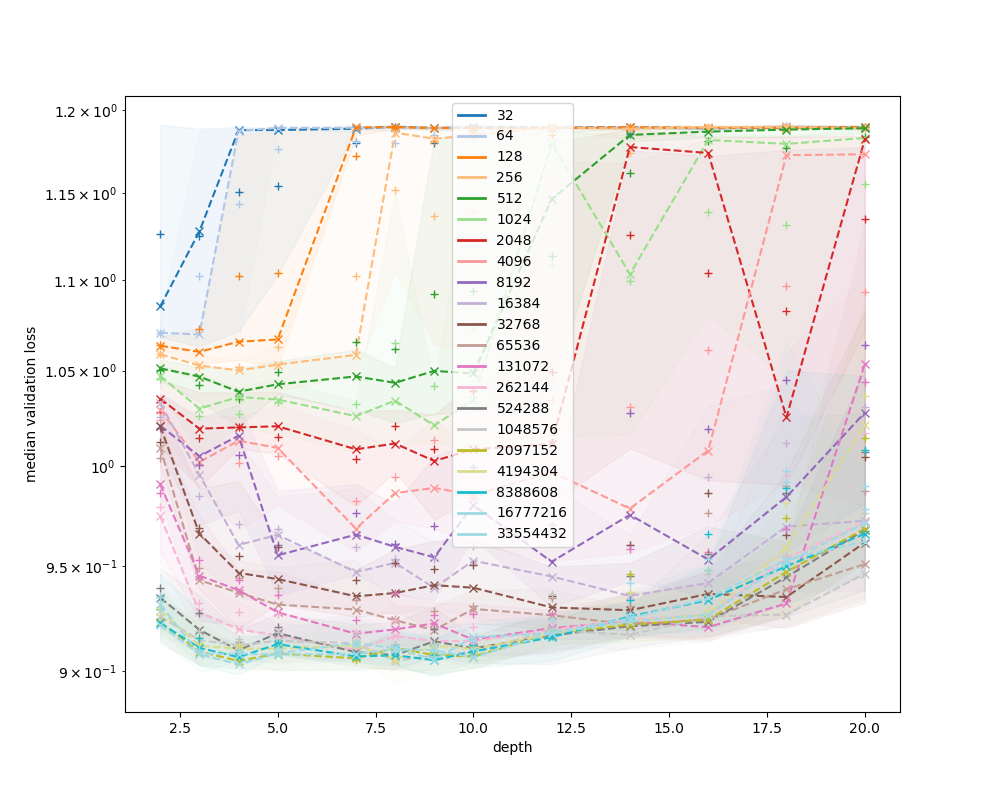

<IPython.core.display.Javascript object>


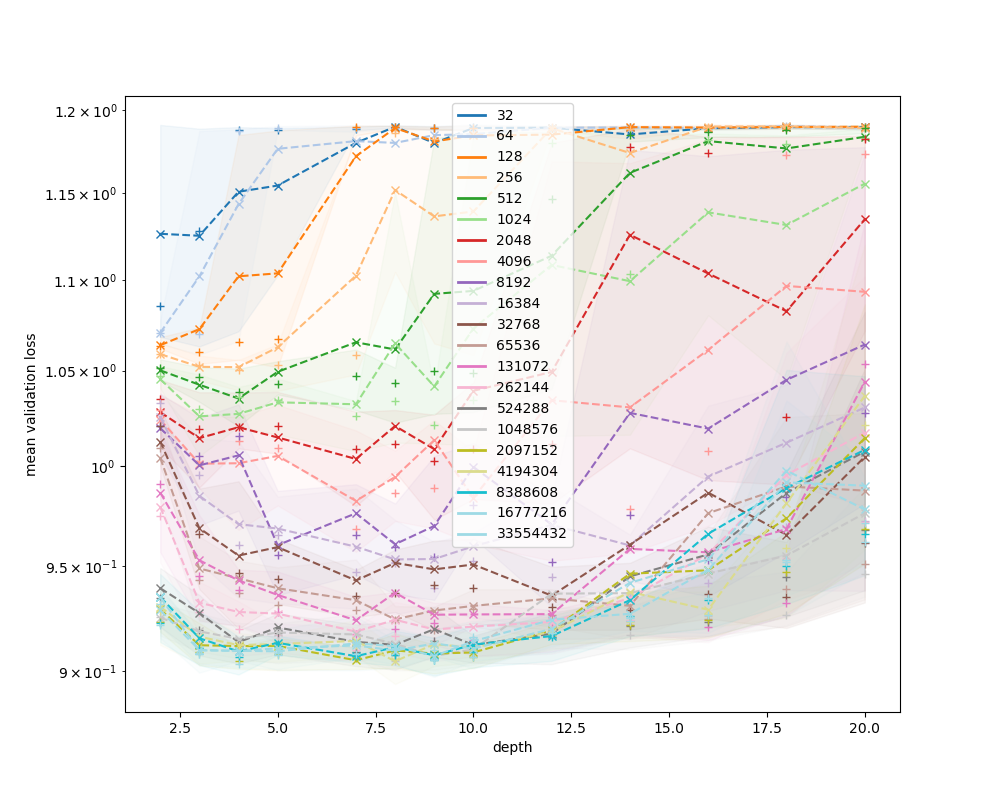

<IPython.core.display.Javascript object>


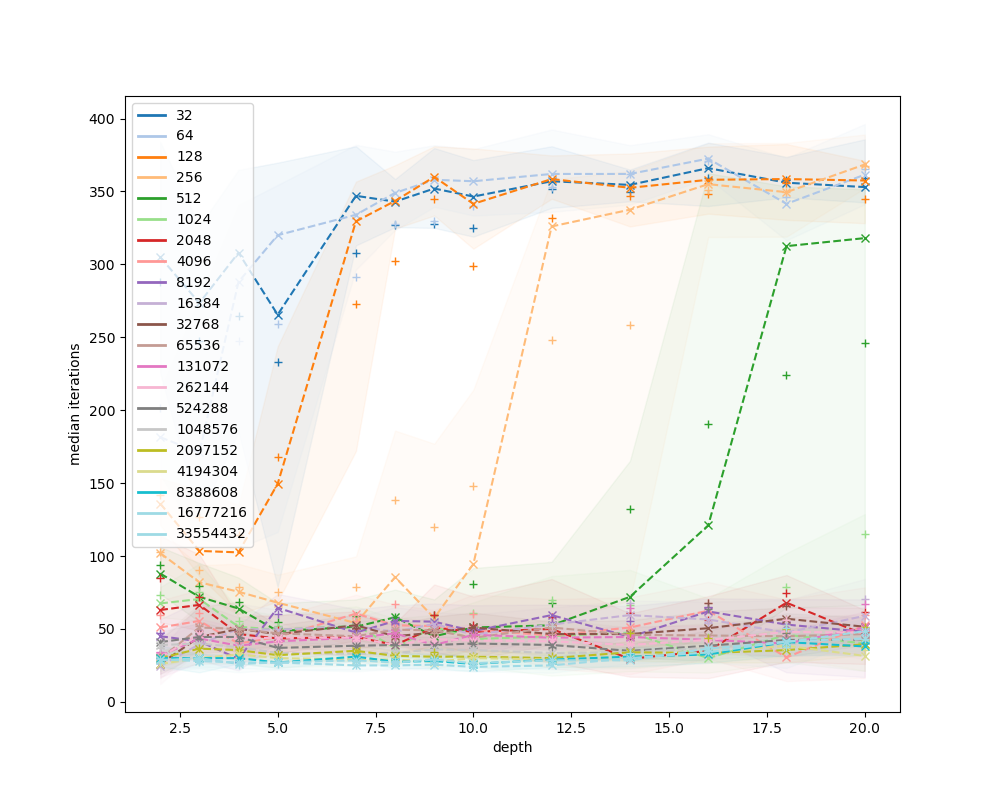

<IPython.core.display.Javascript object>


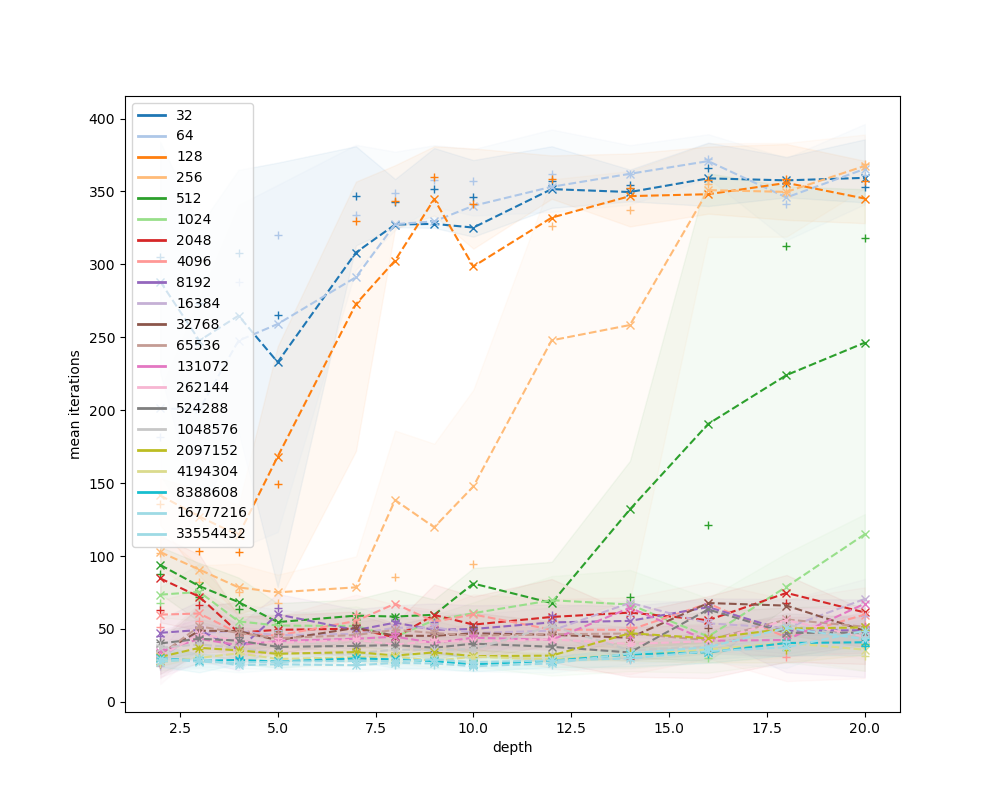

{'config.topology': 'wide_first', 'config.residual_mode': 'none'}


<IPython.core.display.Javascript object>


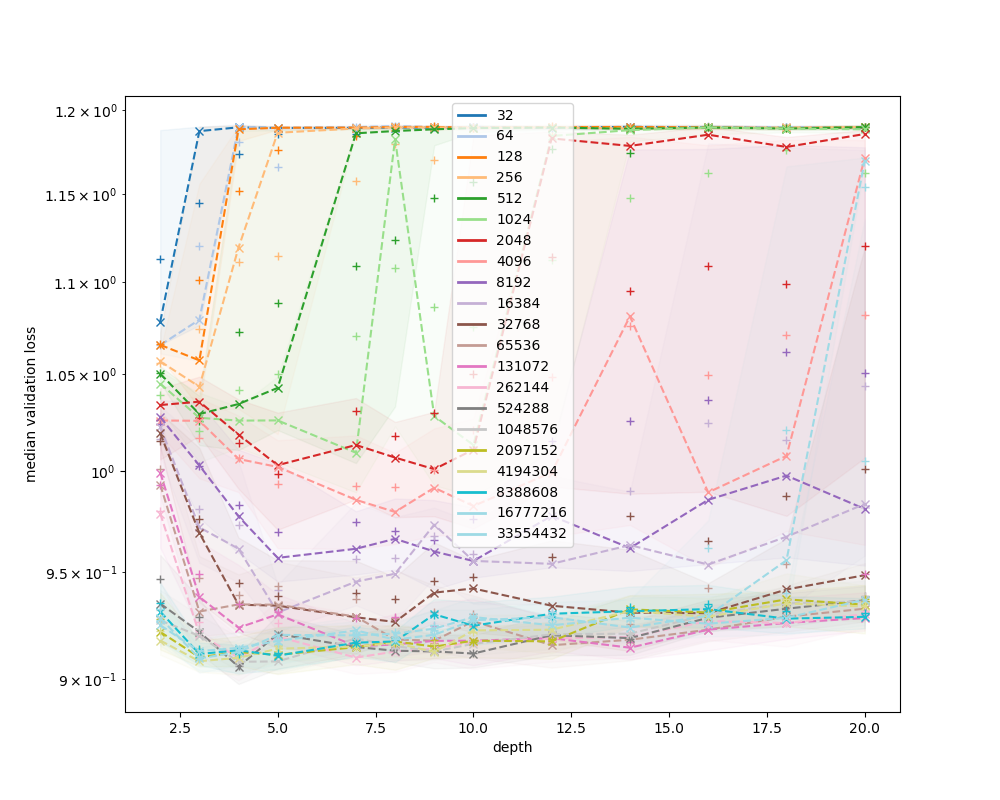

<IPython.core.display.Javascript object>


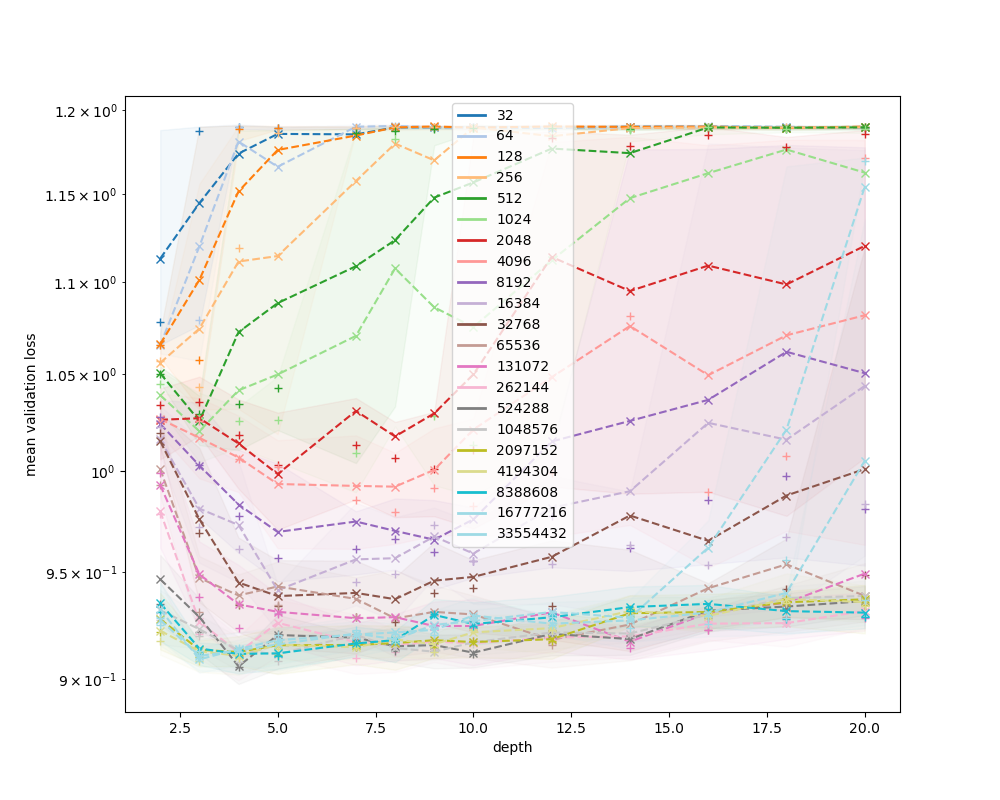

<IPython.core.display.Javascript object>


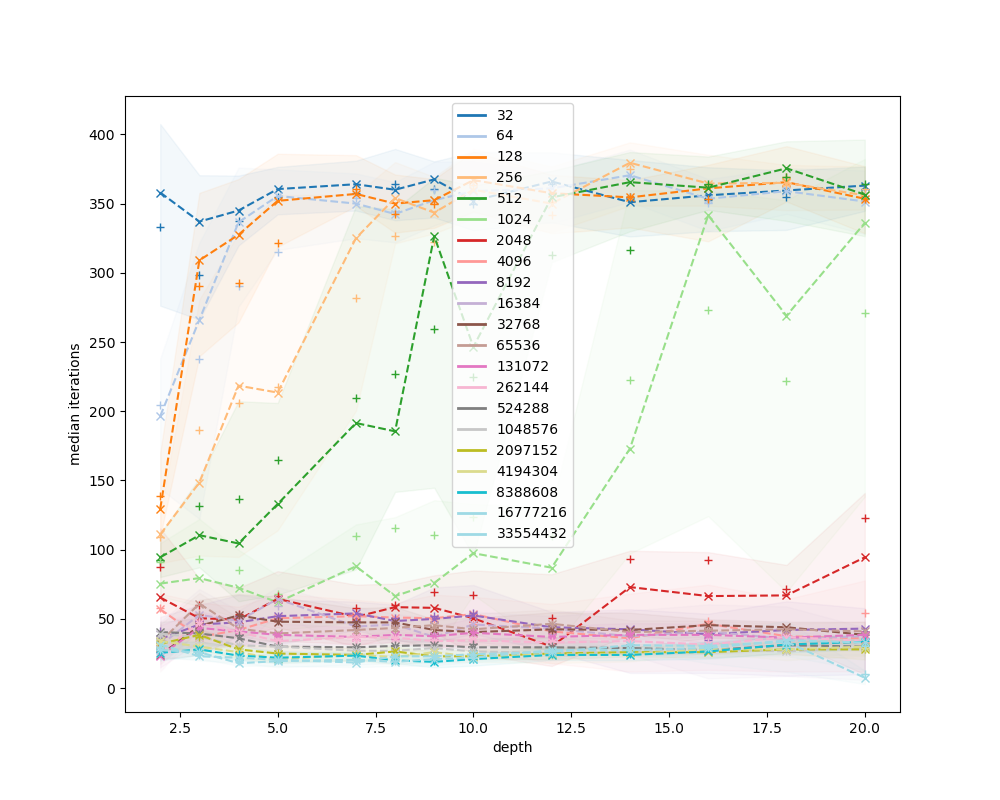

<IPython.core.display.Javascript object>


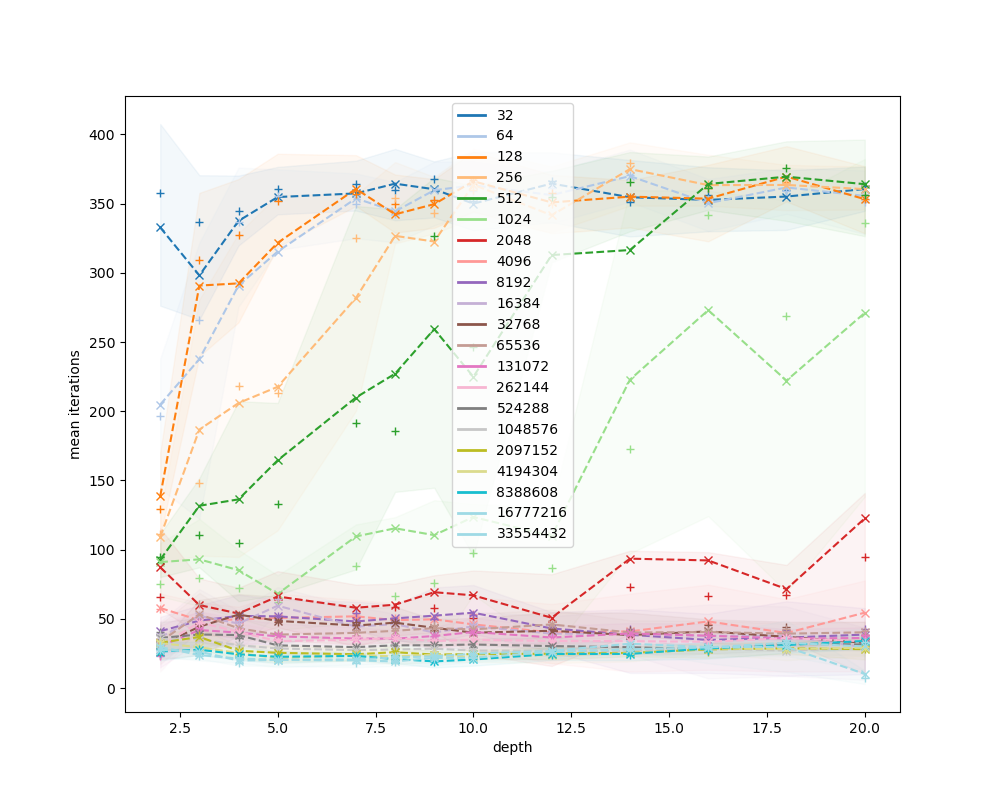

{'config.topology': 'wide_first', 'config.residual_mode': 'full'}


<IPython.core.display.Javascript object>


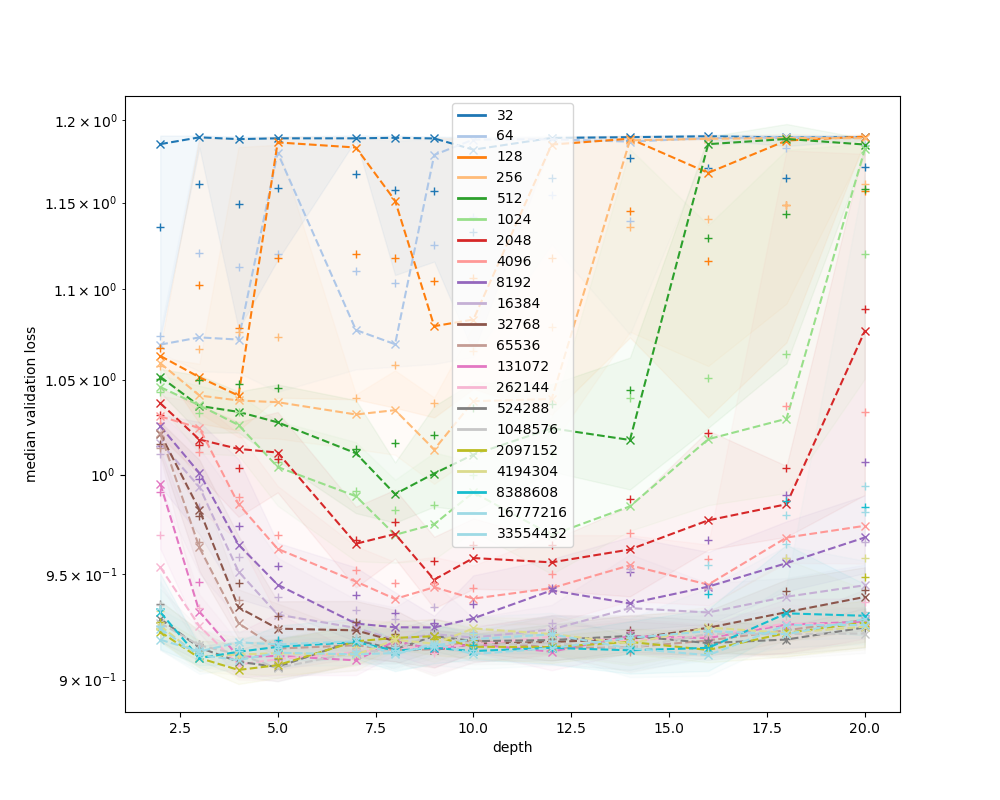

<IPython.core.display.Javascript object>


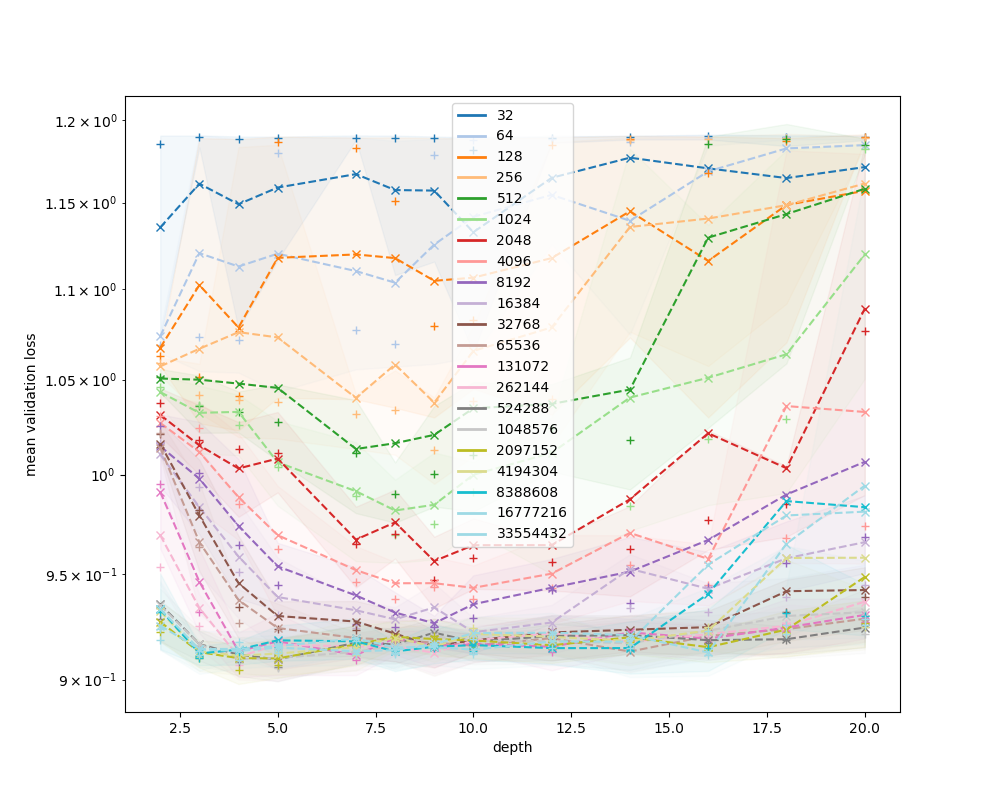

<IPython.core.display.Javascript object>


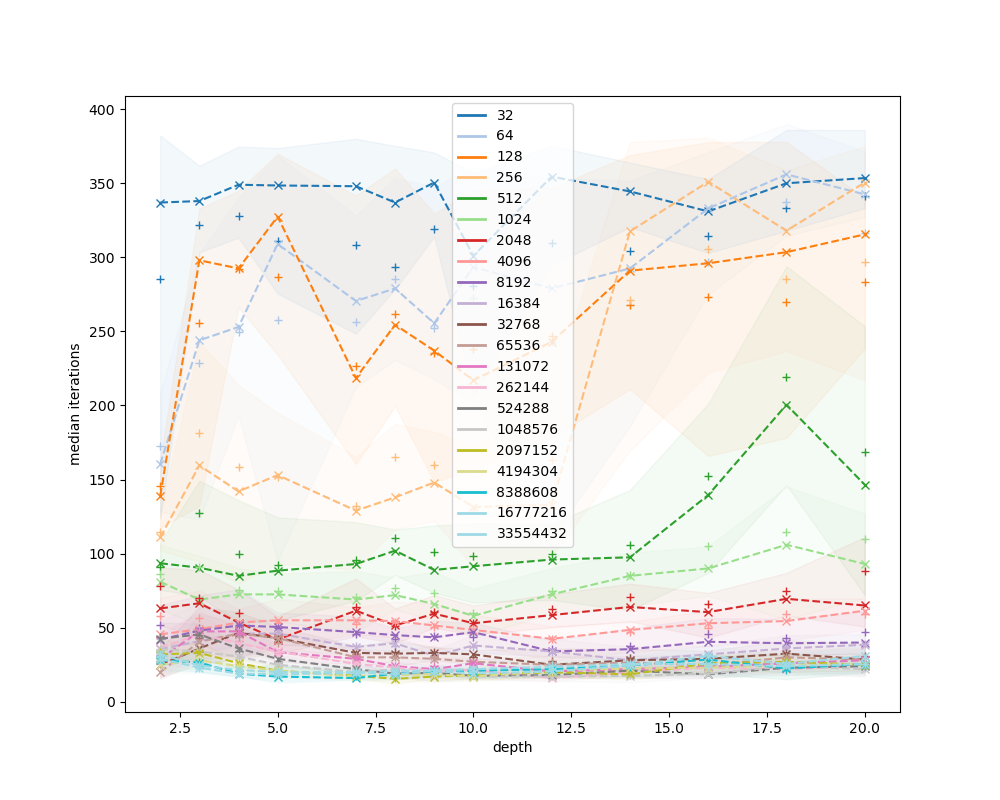

<IPython.core.display.Javascript object>


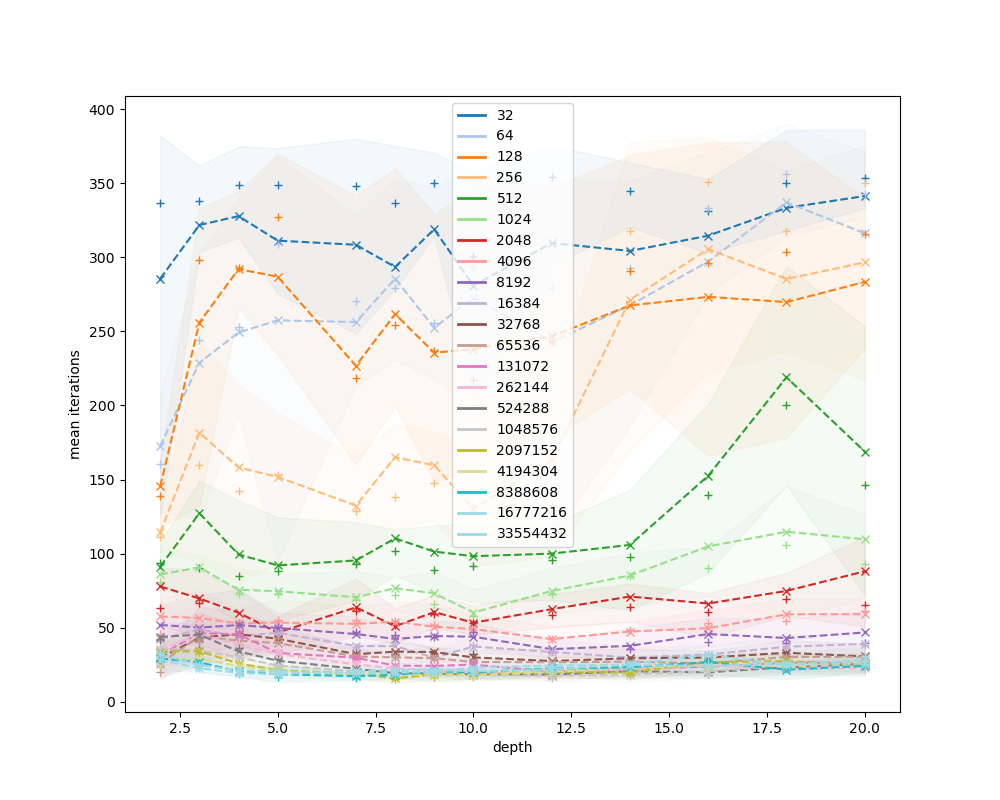

In [73]:
plot_dataset('wine_quality_white')

In [91]:

def plot_colored_grid(data, xlabel, ylabel, xlabels = None, ylabels = None, color_bounds = None):
#     ax.imshow(gradient, aspect='auto', cmap=plt.get_cmap(name))
    cmap = plt.get_cmap('plasma')
#     norm = colors.Normalize(np.min(data), np.max(data), cmap.N)
    if color_bounds is None:
        color_bounds = lambda data : (np.min(data), np.max(data))
    min_color_bounds, max_color_bounds = color_bounds(data)
    norm = colors.Normalize(min_color_bounds, max_color_bounds, cmap.N)
    print(f'{np.min(data)} {np.max(data)}')
    
    fig, ax = plt.subplots()
    ax.imshow(data, cmap=cmap, norm=norm)

    # draw gridlines
    ax.grid(which='major', axis='both', linestyle='-', color='k', linewidth=2)
    ax.set_xticks(np.arange(-.5, data.shape[1], 1));
    ax.set_yticks(np.arange(-.5, data.shape[0], 1));
    
    if xlabels is not None:
        ax.set_yticklabels([''] + xlabels)
    if ylabels is not None:
        ax.set_xticklabels(ylabels + [''])
        plt.xticks(rotation=45)

    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    
    plt.show()
    return ax


def plot_grid_from_dataset(datasets, val_function, title, x_category, y_category, color_bounds = None):

    # grouped = datasets.groupby([x_category, y_category]) #, as_index=False)
    #     return [grouped.get_group(group) for group in grouped.groups], list(grouped.groups.keys())

    # pd.groupby
    x_values = sorted(pd.unique(datasets[x_category]))
    y_values = sorted(pd.unique(datasets[y_category]))
    print(x_values)
    print(y_values)
    result = np.zeros((len(x_values), len(y_values)))
    for x, x_value in enumerate(sorted(pd.unique(datasets[x_category]))):
        x_subset = datasets[datasets[x_category] == x_value]
        for y, y_value in enumerate(sorted(pd.unique(datasets[y_category]))):
            subset = x_subset[x_subset[y_category] == y_value]
            result[x, y] = val_function(subset)

    ax = plot_colored_grid(result, y_category, x_category, x_values, y_values, color_bounds = color_bounds)
    ax.set_title(title)
    print(result)


dataset: 529_pollen
['exponential none', 'rectangle full', 'rectangle none', 'trapezoid none', 'wide_first full', 'wide_first none']
[32, 64, 128, 256, 512, 1024, 2048, 4096, 8192, 16384, 32768, 65536, 131072, 262144, 524288, 1048576, 2097152, 4194304, 8388608, 16777216, 33554432]
0.004265093710273504 0.004317168379202485


<IPython.core.display.Javascript object>


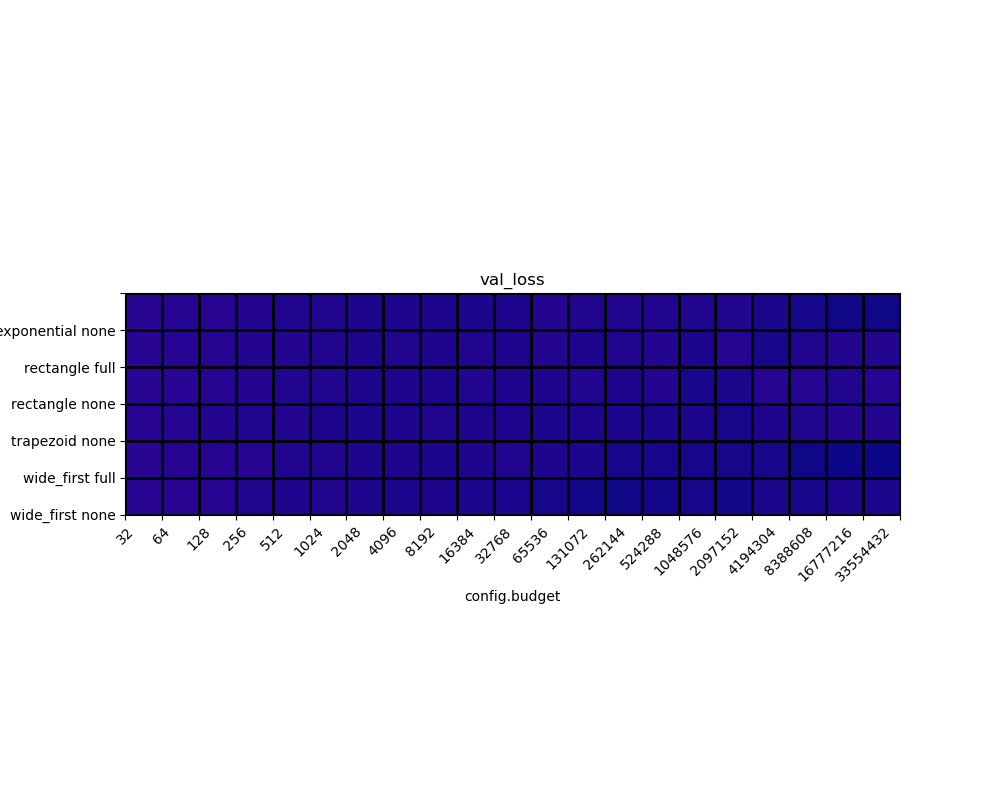

[[0.00431557 0.00431039 0.00431228 0.00430438 0.00430031 0.00430067
  0.0042977  0.00429825 0.00429551 0.00429143 0.00429824 0.00430526
  0.0043011  0.00430142 0.00430211 0.00430003 0.00430005 0.004289
  0.00427799 0.00427234 0.00427077]
 [0.00431618 0.00431068 0.00430765 0.00430472 0.00430459 0.00430007
  0.0042981  0.00430056 0.00429681 0.0043011  0.0042972  0.00430527
  0.00429704 0.00429963 0.00430277 0.00429223 0.00430783 0.0042841
  0.00429902 0.00430346 0.00430468]
 [0.00431634 0.00431689 0.00430893 0.0043062  0.00430122 0.00430247
  0.00429715 0.00429634 0.00429558 0.00430114 0.00429455 0.00429628
  0.00430049 0.00429812 0.00430363 0.00428557 0.00428895 0.00431022
  0.00430684 0.00430135 0.00430761]
 [0.00431717 0.0043082  0.00430535 0.0043     0.00430333 0.00429791
  0.00429348 0.0042956  0.00430102 0.00429686 0.00429819 0.00429108
  0.00429636 0.00429326 0.004286   0.00429009 0.00428129 0.00429459
  0.00430194 0.00430373 0.00430308]
 [0.00431614 0.0043102  0.00431012 0.004308

<IPython.core.display.Javascript object>

[[ 2.  2.  2.  2.  3.  3.  2.  3.  3.  3.  3.  2.  3.  2.  4.  4.  4.  5.
   3.  4.  4.]
 [ 2.  3.  3.  2.  2.  2.  2.  2.  3.  2.  2.  2.  2.  2.  3.  4.  3.  4.
   4.  4.  3.]
 [ 2.  2.  2.  2.  2.  2.  2.  2.  3.  2.  3.  3.  2.  3.  3.  4.  4.  2.
   2.  3.  3.]
 [ 2.  2.  2.  3.  2.  2.  3.  2.  2.  2.  3.  3.  2.  5.  5.  9.  4.  7.
   3.  3.  3.]
 [ 2.  2.  2.  2.  2.  2.  3.  4.  3.  3.  3.  4.  7.  5.  5.  4.  5.  5.
   4.  4.  4.]
 [ 2.  2.  2.  2.  2.  2.  3.  3.  3.  3.  8.  9. 10.  7.  5.  5.  4.  5.
   4.  3.  4.]]
dataset: sleep
['exponential none', 'rectangle full', 'rectangle none', 'trapezoid none', 'wide_first full', 'wide_first none']
[32, 64, 128, 256, 512, 1024, 2048, 4096, 8192, 16384, 32768, 65536, 131072, 262144, 524288, 1048576, 2097152, 4194304, 8388608, 16777216, 33554432]
0.6316048800945282 0.8983306288719177


<IPython.core.display.Javascript object>

[[0.8974027  0.89746994 0.89788261 0.74419335 0.69480988 0.66788685
  0.65245691 0.64521521 0.64110801 0.63848838 0.63578784 0.63410079
  0.63269293 0.63257456 0.63183993 0.63300228 0.63327399 0.63390124
  0.63461775 0.63432309 0.63612705]
 [0.89809856 0.8980518  0.89810324 0.74125066 0.69102255 0.66621733
  0.65051496 0.64389214 0.64136863 0.63814011 0.63622564 0.63402456
  0.63298729 0.63233316 0.63222972 0.63207635 0.63286874 0.63615316
  0.63656843 0.6368888  0.63778663]
 [0.89833063 0.89809194 0.89829236 0.74405161 0.69523507 0.6658349
  0.65144804 0.64479333 0.64121002 0.63891852 0.63590053 0.63394752
  0.63320854 0.63235623 0.63169035 0.63364354 0.63304156 0.6355792
  0.63796669 0.63846216 0.63901794]
 [0.89652964 0.89658445 0.89657748 0.74389303 0.69502002 0.66744715
  0.65278128 0.64459485 0.64140093 0.63815123 0.63611913 0.634606
  0.63289741 0.6321902  0.63160488 0.63226846 0.63300404 0.636123
  0.6367937  0.63684672 0.63834339]
 [0.89808616 0.89803055 0.89801607 0.74392802 

<IPython.core.display.Javascript object>

[[4. 3. 2. 2. 3. 3. 3. 2. 2. 2. 2. 2. 2. 2. 2. 3. 3. 3. 3. 3. 3.]
 [3. 2. 3. 9. 7. 3. 3. 3. 2. 2. 2. 2. 2. 2. 2. 2. 2. 3. 3. 4. 4.]
 [2. 2. 2. 2. 2. 3. 3. 3. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 3. 3. 3.]
 [5. 4. 3. 2. 2. 3. 4. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 3. 3. 3. 3.]
 [2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 3. 3. 3. 3.]
 [2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 3. 3. 3.]]
dataset: adult
['exponential none', 'rectangle full', 'rectangle none', 'trapezoid none', 'wide_first full', 'wide_first none']
[32, 64, 128, 256, 512, 1024, 2048, 4096, 8192, 16384, 32768, 65536, 131072, 262144, 524288, 1048576, 2097152, 4194304, 8388608, 16777216, 33554432]
3.60430908203125 3.60430908203125


<IPython.core.display.Javascript object>

[[3.60430908 3.60430908 3.60430908 3.60430908 3.60430908 3.60430908
  3.60430908 3.60430908 3.60430908 3.60430908 3.60430908 3.60430908
  3.60430908 3.60430908 3.60430908 3.60430908 3.60430908 3.60430908
  3.60430908 3.60430908 3.60430908]
 [3.60430908 3.60430908 3.60430908 3.60430908 3.60430908 3.60430908
  3.60430908 3.60430908 3.60430908 3.60430908 3.60430908 3.60430908
  3.60430908 3.60430908 3.60430908 3.60430908 3.60430908 3.60430908
  3.60430908 3.60430908 3.60430908]
 [3.60430908 3.60430908 3.60430908 3.60430908 3.60430908 3.60430908
  3.60430908 3.60430908 3.60430908 3.60430908 3.60430908 3.60430908
  3.60430908 3.60430908 3.60430908 3.60430908 3.60430908 3.60430908
  3.60430908 3.60430908 3.60430908]
 [3.60430908 3.60430908 3.60430908 3.60430908 3.60430908 3.60430908
  3.60430908 3.60430908 3.60430908 3.60430908 3.60430908 3.60430908
  3.60430908 3.60430908 3.60430908 3.60430908 3.60430908 3.60430908
  3.60430908 3.60430908 3.60430908]
 [3.60430908 3.60430908 3.60430908 3.604

<IPython.core.display.Javascript object>

[[2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.]
 [2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.]
 [2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.]
 [2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.]
 [2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.]
 [2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.]]
dataset: 537_houses
['exponential none', 'rectangle full', 'rectangle none', 'trapezoid none', 'wide_first full', 'wide_first none']
[32, 64, 128, 256, 512, 1024, 2048, 4096, 8192, 16384, 32768, 65536, 131072, 262144, 524288, 1048576, 2097152, 4194304, 8388608, 16777216, 33554432]
0.01548013649880886 0.017192923463881016


<IPython.core.display.Javascript object>

[[0.01718094 0.01683634 0.01690613 0.01679547 0.01696024 0.01686802
  0.01686873 0.01684346 0.016774   0.01677777 0.01669594 0.01657718
  0.016497   0.01653038 0.01650194 0.01642608 0.01652193 0.01662672
  0.01654807 0.01668321 0.01680442]
 [0.01715297 0.01680234 0.01673517 0.01681053 0.01685541 0.0168293
  0.01685829 0.01683572 0.01673634 0.0166275  0.01642844 0.01640054
  0.01641647 0.01627864 0.01638602 0.01629041 0.01638456 0.01631046
  0.01608363 0.01635358 0.01642405]
 [0.01703265 0.01687009 0.01677689 0.01680511 0.01680458 0.01687661
  0.01681446 0.01686426 0.01669591 0.01667875 0.0166089  0.01645463
  0.01653201 0.01636404 0.01635473 0.01635941 0.01633203 0.0162553
  0.01601649 0.01581948 0.01564065]
 [0.01719292 0.01685851 0.01682588 0.0167791  0.01678928 0.01679537
  0.01687824 0.01681469 0.01672735 0.01664144 0.01649823 0.01638043
  0.01638882 0.01637396 0.01634943 0.01640553 0.01617917 0.01594018
  0.01570007 0.01569348 0.01548014]
 [0.01714761 0.01688236 0.01674876 0.01687

<IPython.core.display.Javascript object>

[[ 2.  2.  2.  2.  2.  2.  2.  2.  3.  3.  4.  3.  3.  3.  3.  3.  3.  3.
   3.  2.  2.]
 [ 2.  2.  2.  2.  2.  2.  2.  2.  3.  4.  5.  3.  4.  5.  5.  7.  7.  4.
   5.  5.  4.]
 [ 2.  2.  2.  2.  2.  2.  2.  2.  3.  3.  5. 12.  3.  5. 12.  5.  9.  8.
   5.  5.  5.]
 [ 2.  2.  2.  2.  2.  2.  2.  4.  4.  8.  4.  4.  4.  5.  5. 18. 10. 10.
   8.  8.  7.]
 [ 2.  2.  2.  2.  2.  2.  2.  5.  8.  3.  9.  5.  3.  3.  3.  3.  3.  8.
   7.  7.  3.]
 [ 2.  2.  2.  2.  2.  2.  2.  4.  3.  5.  3.  3.  3.  3. 18. 14. 10. 12.
   9.  7.  8.]]
dataset: nursery
['exponential none', 'rectangle full', 'rectangle none', 'trapezoid none', 'wide_first full', 'wide_first none']
[32, 64, 128, 256, 500, 512, 1000, 1024, 2048, 4096, 8192, 16384, 32768, 65536, 131072, 262144, 524288, 1048576, 2097152, 4194304, 8388608, 16777216, 33554432]
nan nan


<IPython.core.display.Javascript object>

[[1.94496416e-01 1.66539304e-01 1.07835688e-01 1.35378158e-02
             nan 8.11498666e-07            nan 2.62839270e-08
  1.26015851e-08 1.08079345e-08 8.60035865e-09 8.11745204e-09
  7.35859684e-09 6.59974164e-09 6.50775900e-09 5.51894797e-09
  5.31198707e-09 5.28899169e-09 4.80608375e-09 3.97824174e-09
  3.47233797e-09 2.62150013e-09 2.71348277e-09]
 [1.93209395e-01 1.29725933e-01 1.02965325e-01 1.36905175e-03
             nan 4.76762992e-07            nan 3.49530893e-08
  1.69937504e-08 1.48091535e-08 1.44642418e-08 1.34294389e-08
  1.25096054e-08 1.05089919e-08 1.05319886e-08 9.70414682e-09
  1.07849378e-08 9.95709826e-09 8.94529295e-09 9.31322042e-09
  8.99128372e-09 5.22000132e-09 5.08201881e-09]
 [1.93338007e-01 1.64669923e-01 1.04952000e-01 1.21395523e-03
             nan 5.24068930e-08            nan 2.76866663e-08
  1.55220317e-08 1.43032701e-08 1.35214213e-08 1.38433602e-08
  1.32684526e-08 1.25326056e-08 1.18197421e-08 1.29695223e-08
  1.03710200e-08 9.65815694e-09 6.41

<IPython.core.display.Javascript object>

[[ 2.  3.  2.  2.  0.  3.  0.  2.  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.
   3.  3.  3.  3.  3.]
 [ 2.  2.  7.  3.  0.  2.  0.  2.  2.  3.  2.  2.  3.  3.  3.  3.  3.  3.
   3.  3.  3.  5.  5.]
 [ 2.  2.  2.  3.  0.  2.  0.  2.  2.  2.  2.  2.  3.  3.  3.  3.  3.  3.
   8.  5.  5.  8.  5.]
 [ 2.  3.  2.  3.  0.  3.  0.  4.  2.  2.  3.  3.  3.  3.  3.  3.  3.  3.
   5.  9.  7.  7.  7.]
 [ 2.  2.  2.  2.  0.  2.  0.  3.  3.  4.  3.  3.  3.  3.  3.  3.  3.  8.
   7.  8.  7.  8.  7.]
 [ 2.  2.  2.  2.  4.  2.  4.  2.  3.  3.  3.  3.  3.  3.  3.  3.  3.  9.
  10. 10.  8.  7.  7.]]
dataset: 201_pol
['exponential none', 'rectangle full', 'rectangle none', 'trapezoid none', 'wide_first full', 'wide_first none']
[32, 64, 128, 256, 512, 1024, 2048, 4096, 8192, 16384, 32768, 65536, 131072, 262144, 524288, 1048576, 2097152, 4194304, 8388608, 16777216, 33554432]
0.00796779477968812 0.027462775819003582


<IPython.core.display.Javascript object>

[[0.02746278 0.02746113 0.02011714 0.01558404 0.01324899 0.01175118
  0.01094252 0.01012573 0.00951845 0.00943853 0.00890395 0.00897904
  0.00887095 0.0086396  0.00875799 0.00872551 0.00924113 0.00905585
  0.00929605 0.00959715 0.00942203]
 [0.02745928 0.02746143 0.01875435 0.01527851 0.01237343 0.0109155
  0.00994186 0.00900866 0.00875046 0.00847569 0.00809656 0.00826382
  0.00822903 0.00816265 0.00832752 0.00883263 0.00879314 0.00957863
  0.00964744 0.00965567 0.00983492]
 [0.02746036 0.0274614  0.01902704 0.01519719 0.01265463 0.01129725
  0.00984943 0.00928513 0.0087971  0.00822649 0.00807689 0.00796779
  0.00797606 0.00814501 0.00828295 0.00820134 0.00828002 0.0093662
  0.00970781 0.00968167 0.00982604]
 [0.02668945 0.02672025 0.02004512 0.01612222 0.01322589 0.01129437
  0.0103391  0.00997826 0.0092064  0.00877382 0.00839998 0.00821455
  0.00817791 0.00823175 0.00815865 0.00837813 0.00848755 0.00863573
  0.0093794  0.0094434  0.00970859]
 [0.02746181 0.0274611  0.01968798 0.01766

<IPython.core.display.Javascript object>

[[2. 2. 2. 3. 4. 4. 4. 4. 4. 4. 4. 4. 4. 4. 4. 4. 4. 4. 4. 3. 4.]
 [2. 2. 4. 4. 4. 4. 4. 5. 4. 5. 5. 4. 4. 4. 4. 9. 7. 3. 3. 3. 3.]
 [2. 2. 3. 3. 3. 4. 4. 5. 4. 5. 5. 5. 5. 4. 4. 4. 4. 4. 3. 3. 3.]
 [8. 5. 2. 3. 4. 4. 4. 4. 4. 4. 4. 4. 4. 4. 5. 4. 5. 5. 4. 4. 3.]
 [2. 2. 3. 2. 3. 4. 3. 4. 4. 4. 4. 4. 4. 4. 4. 4. 4. 4. 5. 4. 3.]
 [2. 2. 3. 2. 2. 2. 3. 3. 4. 4. 4. 5. 4. 4. 5. 7. 5. 5. 4. 4. 3.]]
dataset: mnist
['exponential none', 'rectangle full', 'rectangle none', 'trapezoid none', 'wide_first full', 'wide_first none']
[1024, 2048, 4096, 8192, 16384, 32768, 65536, 131072, 262144, 524288, 1048576, 2097152, 4194304, 8388608, 16777216, 33554432]
0.07172267884016037 1.5036864280700684


<IPython.core.display.Javascript object>

[[1.46671408 0.60810679 0.33066918 0.21630444 0.15294258 0.11683104
  0.09473199 0.08371965 0.07764493 0.07393001 0.07197413 0.07196026
  0.07449384 0.07672351 0.08037698 0.08408819]
 [1.49632394 0.60131562 0.34150214 0.21261282 0.14975871 0.11467471
  0.09461586 0.08371596 0.07750664 0.07358244 0.07208775 0.07179279
  0.07303945 0.07714139 0.08049982 0.08386154]
 [1.50368643 0.60701773 0.34366319 0.21591534 0.15171032 0.11722568
  0.09475316 0.08377159 0.07726334 0.07346823 0.07172268 0.07217783
  0.07347978 0.07807979 0.08108398 0.08370169]
 [1.35225606 0.61706421 0.32529904 0.21541957 0.15375008 0.11743066
  0.0946409  0.08330415 0.07726071 0.07388632 0.07178602 0.07175284
  0.07445589 0.0780728  0.08094475 0.08560776]
 [1.50231075 0.60105476 0.34278677 0.22790594 0.15247554 0.11608885
  0.09509818 0.08410018 0.07809364 0.07344469 0.07194261 0.07177858
  0.07314977 0.07641011 0.08045522 0.08385909]
 [1.50341243 0.60398743 0.34766231 0.2316412  0.15148537 0.11636305
  0.09458742 0.08

<IPython.core.display.Javascript object>

[[4. 3. 3. 3. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 4.]
 [8. 3. 3. 4. 4. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.]
 [2. 2. 2. 4. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.]
 [8. 2. 5. 4. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.]
 [2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 7.]
 [2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 3.]]
dataset: connect_4
['exponential none', 'rectangle full', 'rectangle none', 'trapezoid none', 'wide_first full', 'wide_first none']
[32, 64, 128, 256, 512, 1024, 2048, 4096, 8192, 16384, 32768, 65536, 131072, 262144, 524288, 1048576, 2097152, 4194304, 8388608, 16777216, 33554432]
0.6601302921772003 0.7955591082572937


<IPython.core.display.Javascript object>

[[0.79194936 0.79010031 0.79449049 0.78097001 0.76658919 0.75840655
  0.74012011 0.72818592 0.7105706  0.68870419 0.68203598 0.67937696
  0.68184075 0.67080596 0.67703101 0.67731956 0.67493862 0.67091683
  0.66539657 0.66356295 0.66216606]
 [0.78831759 0.78918535 0.79112425 0.77621752 0.76296365 0.75547117
  0.74187934 0.72700483 0.70673335 0.69259414 0.68235788 0.68640658
  0.6755625  0.67748639 0.67481938 0.67967403 0.68119705 0.67755032
  0.6722618  0.66051626 0.66477564]
 [0.7902531  0.79300356 0.79125392 0.7845335  0.7659685  0.7574251
  0.73706356 0.71961167 0.7031357  0.69253597 0.6805321  0.67948756
  0.6793029  0.67665327 0.67712706 0.67772958 0.67972824 0.67545509
  0.66729662 0.66013029 0.66255906]
 [0.79162773 0.79131639 0.7917794  0.78571877 0.76876619 0.756749
  0.73687196 0.72042632 0.7110427  0.69523048 0.68201441 0.68151045
  0.67588255 0.67956531 0.67751801 0.67612129 0.67351604 0.67923835
  0.66371763 0.66611239 0.66140023]
 [0.79192311 0.79128489 0.79555911 0.786057

<IPython.core.display.Javascript object>

[[ 2.  2.  3.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  3.  3.
   2.  2.  3.]
 [ 4.  5.  2.  7.  4.  4.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.
   2.  2.  2.]
 [ 2.  2.  2.  2.  3.  3.  3.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2. 16.
   2.  2.  2.]
 [ 2.  2.  2.  2.  2.  3.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.
   2.  2.  2.]
 [ 2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  5.  8.  4. 10.
   2.  2.  2.]
 [ 2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2. 18. 18. 10. 20.
   2.  2.  2.]]
dataset: wine_quality_white
['exponential none', 'rectangle full', 'rectangle none', 'trapezoid none', 'wide_first full', 'wide_first none']
[32, 64, 128, 256, 512, 1024, 2048, 4096, 8192, 16384, 32768, 65536, 131072, 262144, 524288, 1048576, 2097152, 4194304, 8388608, 16777216, 33554432]
0.903162032365799 1.1817103624343872


<IPython.core.display.Javascript object>

[[1.08514011 1.06966299 1.06018561 1.0501259  1.03871179 1.02087766
  1.00245899 0.96829239 0.95198503 0.93541673 0.92858285 0.91921005
  0.91467729 0.9097684  0.90747324 0.9048101  0.90474656 0.90557182
  0.90507334 0.90636453 0.90316203]
 [1.07189423 1.06468886 1.05391634 1.04952294 1.04247326 1.017344
  1.01413375 0.98442984 0.95141152 0.93714446 0.92434794 0.92031002
  0.91705206 0.91300076 0.91054642 0.90807793 0.91160455 0.90957245
  0.91051438 0.90841016 0.90973869]
 [1.07728463 1.06559581 1.0566076  1.04963744 1.03690344 1.03360391
  1.01887262 0.99828494 0.95993862 0.94525361 0.92954901 0.9218702
  0.91492346 0.91402572 0.91210559 0.91109651 0.91014403 0.91049105
  0.91119304 0.91449076 0.91159672]
 [1.13308805 1.06676835 1.05889022 1.04564041 1.03653222 1.02918673
  1.00837231 0.97940049 0.95445439 0.94194344 0.92664266 0.91965905
  0.91278434 0.91010472 0.91152281 0.90756199 0.90900505 0.91243201
  0.90902835 0.91066456 0.91171375]
 [1.18171036 1.06902993 1.04138434 1.012961

<IPython.core.display.Javascript object>

[[ 2.  3.  3.  4.  4.  9.  9.  7. 12. 14. 14.  9. 10.  7.  8.  8.  4.  8.
   9. 10.  4.]
 [10.  9.  5. 10.  7.  9. 10.  8.  8.  8.  8.  5.  7.  5.  3.  4. 10.  3.
  16. 12.  3.]
 [ 2.  2.  5.  3.  5.  8.  7.  8.  5.  8.  7. 10.  7.  7.  5.  3.  3.  3.
   3.  3.  3.]
 [ 4.  3.  4.  5.  5.  7. 12.  9. 12. 12. 12. 16.  8.  4.  5.  4.  4.  3.
   3.  3.  3.]
 [10.  2.  4.  9.  8. 12.  9.  8.  9.  8.  9.  8.  7.  4.  5.  5.  4.  3.
   3.  8.  4.]
 [ 2.  2.  3.  3.  3.  7.  9.  8. 10.  5.  8. 12. 14.  4.  4.  4.  3.  3.
   5.  3.  3.]]


In [94]:
datasets = ['529_pollen',
    'sleep',
    'adult',
    '537_houses',
    'nursery',
    '201_pol',
    'mnist',
    'connect_4',
    'wine_quality_white',
    ]

# subset = datasets[(datasets['config.budget'] == 33554432)]
subset = datasets

for dataset in datasets:    
    print(f'dataset: {dataset}')
    
    #     def plot_dataset(dataset):
    datasets = query_materialized_dataframe('WHERE "config.dataset" = \'%s\'' % (dataset, ))
#     plot_for_each(datasets, ['config.topology', 'config.residual_mode'], ['config.budget'], {})

    def get_min_loss(dataset):
        groups = dataset.groupby('config.depth')
        meds = groups['val_loss'].median()
        mins = meds.min()
        if not(isinstance(mins, float) or isinstance(mins, int)):
            mins = mins.min()
        return mins
    
    plot_grid_from_dataset(
        datasets,
        get_min_loss,
        'val_loss',
        'topology',
        'config.budget',
        color_bounds = lambda data : (np.min(data), 1.25 * np.min(data))
        )
    
    
    def get_min_loss_depth(dataset):
        groups = dataset.groupby('config.depth')
        meds = groups['val_loss'].median()
        if len(meds) == 0:
            return 0
        return meds.idxmin()
    
    plot_grid_from_dataset(
        datasets,
        get_min_loss_depth,
        'best_depth',
        'topology',
        'config.budget',
        )
